In [2]:

import pandas as pd
import utils
import importlib
import matplotlib.pyplot as plt
import seaborn as sns
import os
import numpy as np
importlib.reload(utils)

<module 'utils' from '/Users/vittoriameroni/Downloads/utils.py'>

In [3]:
beers_adv = pd.read_csv("data/birre/BeerAdvocate/beers.csv", sep=",")
breweries_adv = pd.read_csv("data/birre/BeerAdvocate/breweries.csv", sep=",")
users_adv = pd.read_csv("data/birre/BeerAdvocate/users.csv", sep=",")

In [8]:
utils.ensure_col_types(beers_adv,
                       ['beer_id', 'brewery_id', 'nbr_ratings', 'nbr_reviews', 'nbr_matched_valid_ratings'],
                       ['abv'],
                       ['beer_name', 'brewery_name', 'style'])

In [10]:
beers_adv.head()

,beer_id,beer_name,brewery_id,brewery_name,style,nbr_ratings,nbr_reviews,avg,ba_score,bros_score,abv,avg_computed,zscore,nbr_matched_valid_ratings,avg_matched_valid_ratings
0,166064,Nashe Moskovskoe,39912,Abdysh-Ata (Абдыш Ата),Euro Pale Lager,0,0,NaN,NaN,NaN,4.7,NaN,NaN,0,NaN
1,166065,Nashe Pivovskoe,39912,Abdysh-Ata (Абдыш Ата),Euro Pale Lager,0,0,NaN,NaN,NaN,3.8,NaN,NaN,0,NaN
2,166066,Nashe Shakhterskoe,39912,Abdysh-Ata (Абдыш Ата),Euro Pale Lager,0,0,NaN,NaN,NaN,4.8,NaN,NaN,0,NaN
3,166067,Nashe Zhigulevskoe,39912,Abdysh-Ata (Абдыш Ата),Euro Pale Lager,0,0,NaN,NaN,NaN,4.0,NaN,NaN,0,NaN
4,166063,Zhivoe,39912,Abdysh-Ata (Абдыш Ата),Euro Pale Lager,0,0,NaN,NaN,NaN,4.5,NaN,NaN,0,NaN


Keep only beers that have atleast one review and one rating. Only beers that have been tried are wanted

In [13]:
beers_adv_filt = beers_adv[(beers_adv['nbr_ratings'] != 0) & (beers_adv['nbr_reviews'] != 0)].copy()

In [15]:
beers_adv_filt['nbr_ratings'].describe()

count    166649.000000
mean         49.216653
std         298.336124
min           1.000000
25%           2.000000
50%           5.000000
75%          17.000000
max       16509.000000
Name: nbr_ratings, dtype: float64

In [17]:
beers_adv_filt['nbr_reviews'].describe()

count    166649.000000
mean         15.539163
std          88.846266
min           1.000000
25%           1.000000
50%           2.000000
75%           5.000000
max        3899.000000
Name: nbr_reviews, dtype: float64

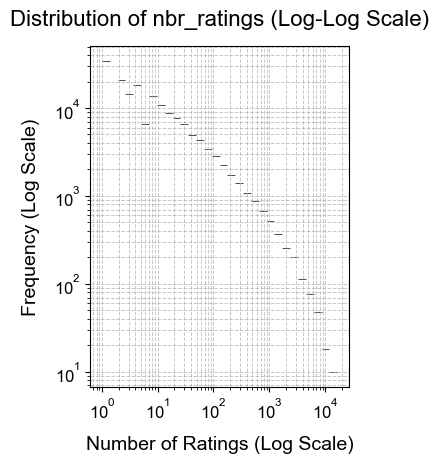

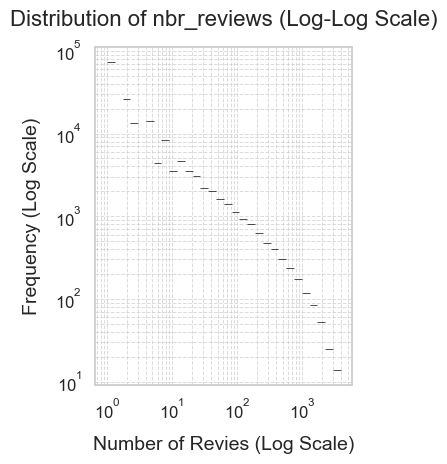

In [19]:
plt.subplot(121)
sns.set_theme(style="whitegrid")
sns.histplot(beers_adv_filt['nbr_ratings'], log_scale=(True, True), bins=30, color="steelblue", edgecolor="black")
plt.xlabel('Number of Ratings (Log Scale)', fontsize=14, labelpad=10)
plt.ylabel('Frequency (Log Scale)', fontsize=14, labelpad=10)
plt.title('Distribution of nbr_ratings (Log-Log Scale)', fontsize=16, pad=15)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)
plt.grid(visible=True, which='both', linestyle='--', linewidth=0.7, alpha=0.7)
plt.tight_layout()
plt.show()

plt.subplot(122)
sns.set_theme(style="whitegrid")
sns.histplot(beers_adv_filt['nbr_reviews'], log_scale=(True, True), bins=30, color="steelblue", edgecolor="black")
plt.xlabel('Number of Revies (Log Scale)', fontsize=14, labelpad=10)
plt.ylabel('Frequency (Log Scale)', fontsize=14, labelpad=10)
plt.title('Distribution of nbr_reviews (Log-Log Scale)', fontsize=16, pad=15)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)
plt.grid(visible=True, which='both', linestyle='--', linewidth=0.7, alpha=0.7)
plt.tight_layout()
plt.show()

Duplicates dealing:

In [21]:
print(beers_adv_filt['beer_id'].duplicated().any())

duplicates = beers_adv_filt['beer_id'].duplicated()
duplicates.describe()

False


count     166649
unique         1
top        False
freq      166649
Name: beer_id, dtype: object

In [22]:
duplicated_beer_id_rows = beers_adv_filt[beers_adv_filt['beer_id'].duplicated(keep=False)]
duplicated_beer_id_rows.head()

,beer_id,beer_name,brewery_id,brewery_name,style,nbr_ratings,nbr_reviews,avg,ba_score,bros_score,abv,avg_computed,zscore,nbr_matched_valid_ratings,avg_matched_valid_ratings


Once seen that duplications are repeated entries they can be removed easily:

In [27]:
beers_adv_filt_unique = beers_adv_filt.drop_duplicates(subset='beer_id', keep='first').reset_index(drop=True)

utils.dataset_information(beers_adv_filt_unique, "Filtered + Unique Beers_BA")



########################################################
We are starting analysing dataset Filtered + Unique Beers_BA
- Dimension of starting dataset: (166649, 15)
- Columns of dataset:  Index(['beer_id', 'beer_name', 'brewery_id', 'brewery_name', 'style',
       'nbr_ratings', 'nbr_reviews', 'avg', 'ba_score', 'bros_score', 'abv',
       'avg_computed', 'zscore', 'nbr_matched_valid_ratings',
       'avg_matched_valid_ratings'],
      dtype='object')
- Are all the id unique? Answer: True
- Are there some values that are NaN inside the dataset? Answer: True
Head: 
    beer_id           beer_name  brewery_id  \
0   142544               Régab       37262   
1    19590       Barelegs Brew       10093   
2    19827            Legbiter       10093   
3    20841   St. Patrick's Ale       10093   
4    20842  St. Patrick's Best       10093   

                                brewery_name             style  nbr_ratings  \
0  Societe des Brasseries du Gabon (SOBRAGA)   Euro Pale Lager         

In [29]:
beers_adv_filt_unique['beer_id'].duplicated().describe()

count     166649
unique         1
top        False
freq      166649
Name: beer_id, dtype: object

### Breweries

In [32]:
utils.dataset_information(breweries_adv, "Breweries_BA")



########################################################
We are starting analysing dataset Breweries_BA
- Dimension of starting dataset: (16758, 4)
- Columns of dataset:  Index(['id', 'location', 'name', 'nbr_beers'], dtype='object')
- Are all the id unique? Answer: True
- Are there some values that are NaN inside the dataset? Answer: False
Head: 
       id    location                    name  nbr_beers
0  39912  Kyrgyzstan  Abdysh-Ata (Абдыш Ата)          5
1  39913  Kyrgyzstan             Arpa (АРПА)          1
2  39914  Kyrgyzstan               Bear Beer          4
3  39915  Kyrgyzstan             Blonder Pub          4
4  39916  Kyrgyzstan            Kellers Bier          2


In [34]:
breweries_adv['nbr_beers'].describe()

count    16758.000000
mean        21.056331
std         69.417841
min          0.000000
25%          2.000000
50%          6.000000
75%         18.000000
max       1196.000000
Name: nbr_beers, dtype: float64

Drop breweries with null `nbr_beers`:

In [37]:
breweries_adv_filt = breweries_adv[(breweries_adv['nbr_beers'] != 0)].copy()
breweries_adv_filt['nbr_beers'].describe()

count    14522.000000
mean        24.298444
std         74.041044
min          1.000000
25%          3.000000
50%          8.000000
75%         21.000000
max       1196.000000
Name: nbr_beers, dtype: float64

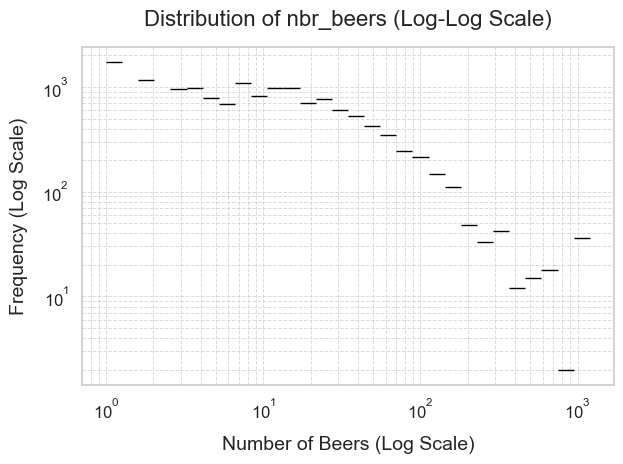

In [39]:
sns.set_theme(style="whitegrid")
sns.histplot(breweries_adv_filt['nbr_beers'], log_scale=(True, True), bins=30, color="steelblue", edgecolor="black")
plt.xlabel('Number of Beers (Log Scale)', fontsize=14, labelpad=10)
plt.ylabel('Frequency (Log Scale)', fontsize=14, labelpad=10)
plt.title('Distribution of nbr_beers (Log-Log Scale)', fontsize=16, pad=15)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)
plt.grid(visible=True, which='both', linestyle='--', linewidth=0.7, alpha=0.7)
plt.tight_layout()
plt.show()

Location analysis:

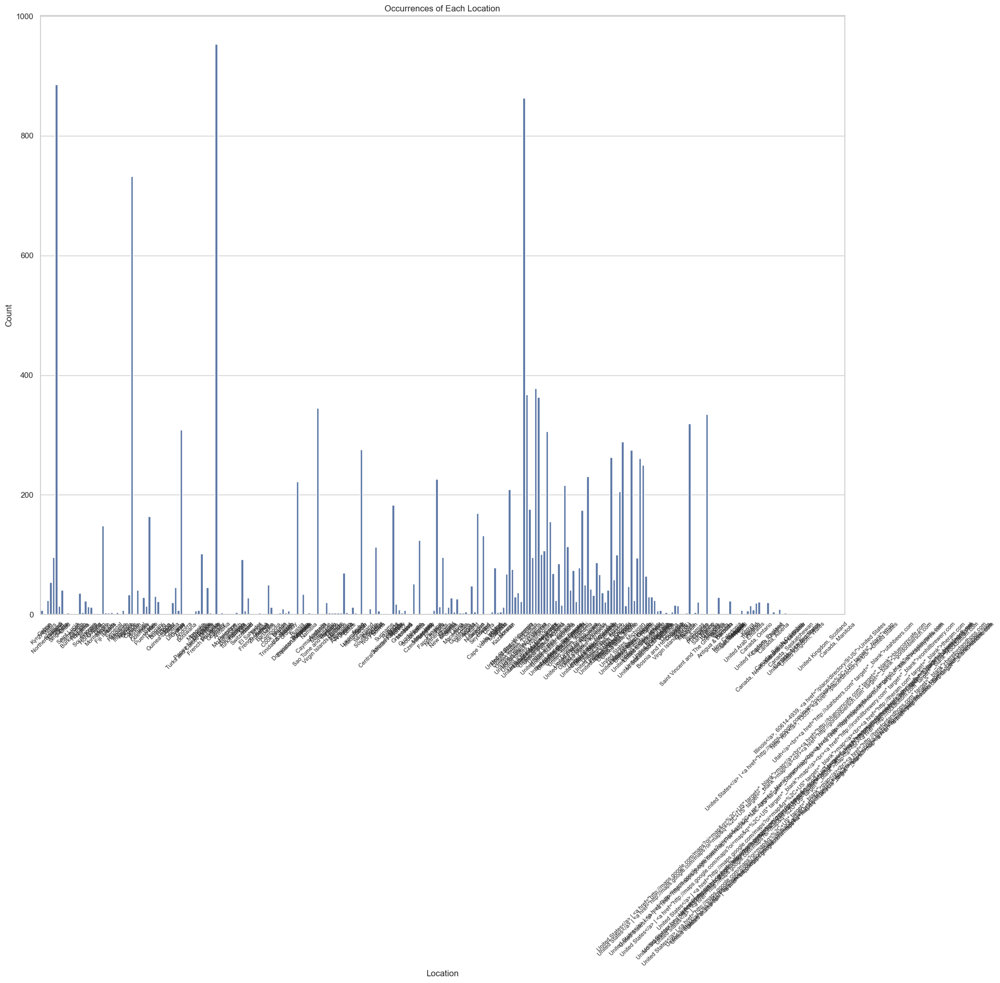

In [42]:
plt.figure(figsize=(20, 15))
sns.countplot(data=breweries_adv_filt, x='location')
plt.title('Occurrences of Each Location')
plt.xlabel('Location')
plt.ylabel('Count')
plt.xticks(rotation=45, fontsize=8) 
plt.show()

Eliminate links added

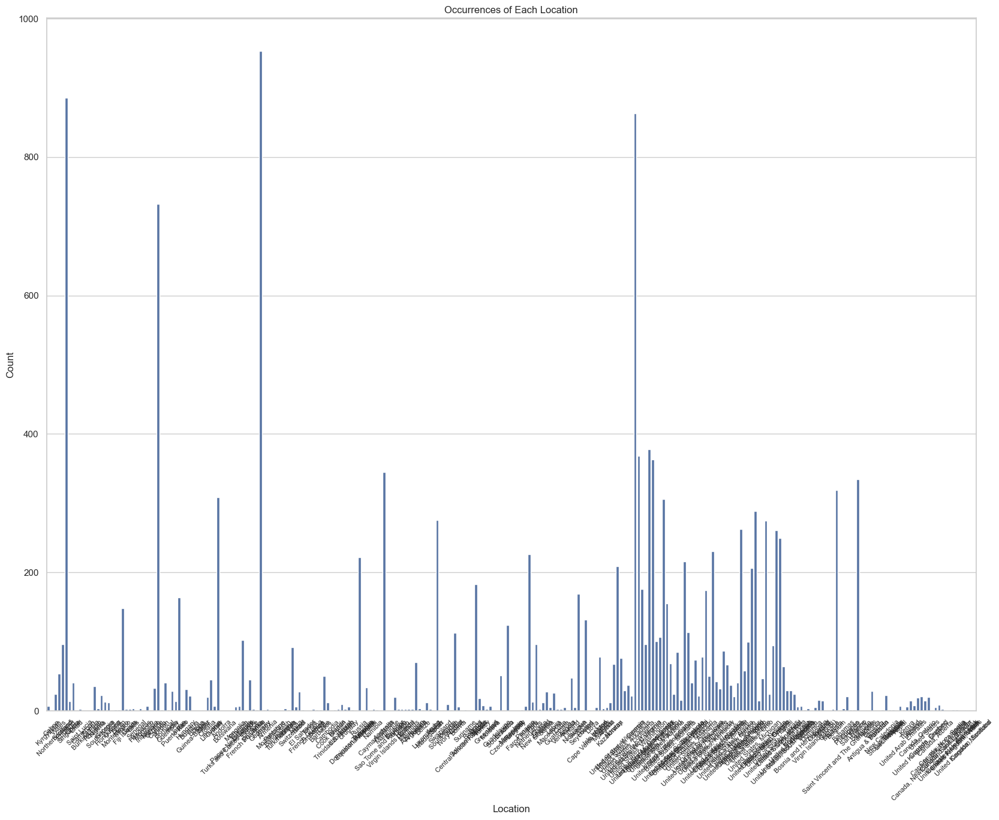

In [44]:
breweries_adv_filt['link'] = breweries_adv_filt['location'].str.contains("href", case=False, na=False)
breweries_adv_filt.loc[breweries_adv_filt['link'] == True, 'location'] = breweries_adv_filt['location'].str.split('<').str[0]
plt.figure(figsize=(20, 15))
sns.countplot(data=breweries_adv_filt, x='location')
plt.title('Occurrences of Each Location')
plt.xlabel('Location')
plt.ylabel('Count')
plt.xticks(rotation=45, fontsize=8) 
plt.show()

Lets start by dividing the locations regions ",":

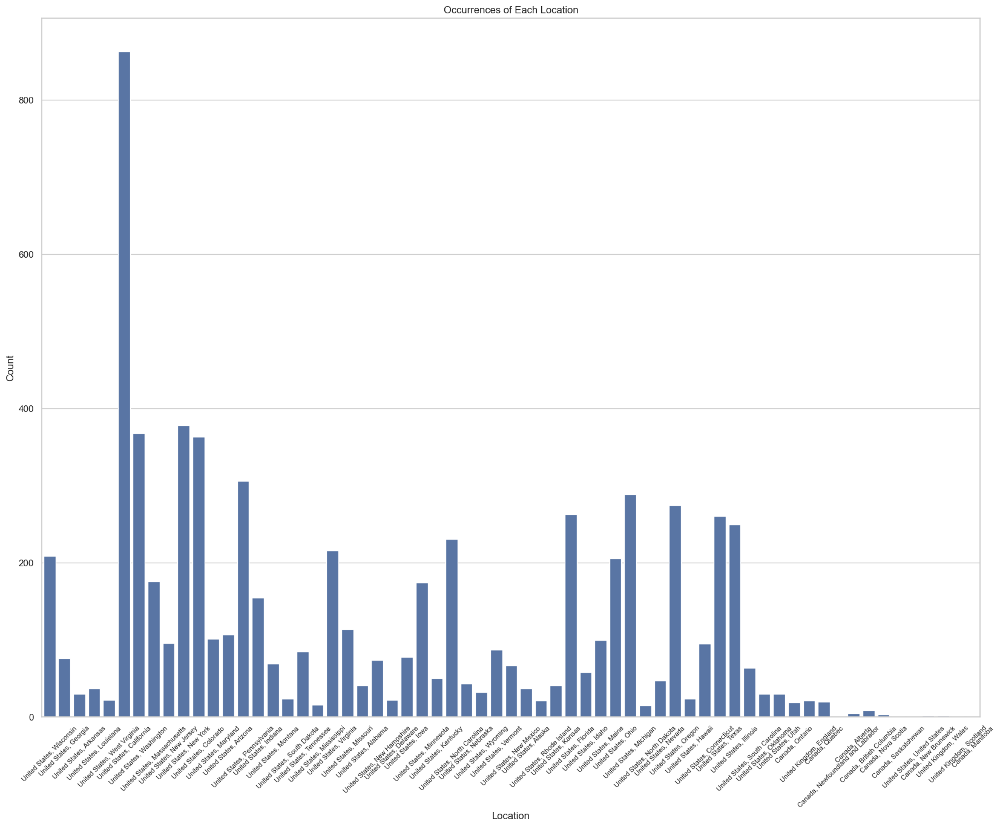

In [47]:
breweries_adv_filt['Regions'] = breweries_adv_filt['location'].str.contains(r"[,\|<]", case=False, na=False)

plt.figure(figsize=(20, 15))
sns.countplot(data=breweries_adv_filt[breweries_adv_filt['Regions'] == True], x='location')
plt.title('Occurrences of Each Location')
plt.xlabel('Location')
plt.ylabel('Count')
plt.xticks(rotation=45, fontsize=8) 
plt.show()

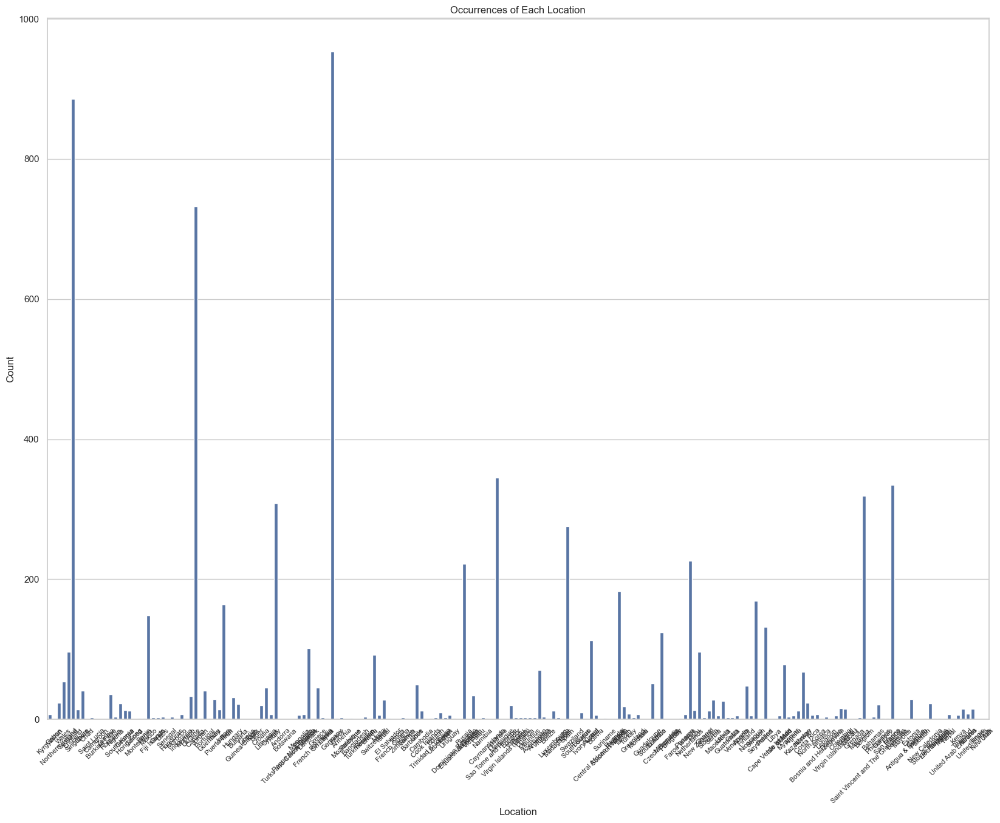

In [48]:
plt.figure(figsize=(20, 15))
sns.countplot(data=breweries_adv_filt[breweries_adv_filt['Regions'] == False], x='location')
plt.title('Occurrences of Each Location')
plt.xlabel('Location')
plt.ylabel('Count')
plt.xticks(rotation=45, fontsize=8) 
plt.show()

Lest divide US, Canada and UK into location and region:

In [52]:
breweries_adv_filt[['location', 'location_region']] = breweries_adv_filt['location'].str.split(',', n=1, expand=True)

breweries_adv_filt['location'] = breweries_adv_filt['location'].str.strip()
breweries_adv_filt['location_region'] = breweries_adv_filt['location_region'].str.strip()

breweries_adv_filt[breweries_adv_filt['Regions']].head()

,id,location,name,nbr_beers,link,Regions,location_region
7986,49595,United States,Copper State Brewing Company,7,False,True,Wisconsin
7987,5522,United States,Corner Pub,13,False,True,Wisconsin
7988,4834,United States,"Courthouse Pub, The",13,False,True,Wisconsin
7989,939,United States,Cross Plains Beer Company,3,False,True,Wisconsin
7990,21405,United States,Dave's BrewFarm,90,False,True,Wisconsin


In [53]:
breweries_adv_filt['US'] = breweries_adv_filt['location'].str.contains("United States", case=False, na=False)
breweries_adv_filt['UK'] = breweries_adv_filt['location'].str.contains("United Kingdom", case=False, na=False)
breweries_adv_filt['Canada'] = breweries_adv_filt['location'].str.contains("Canada", case=False, na=False)

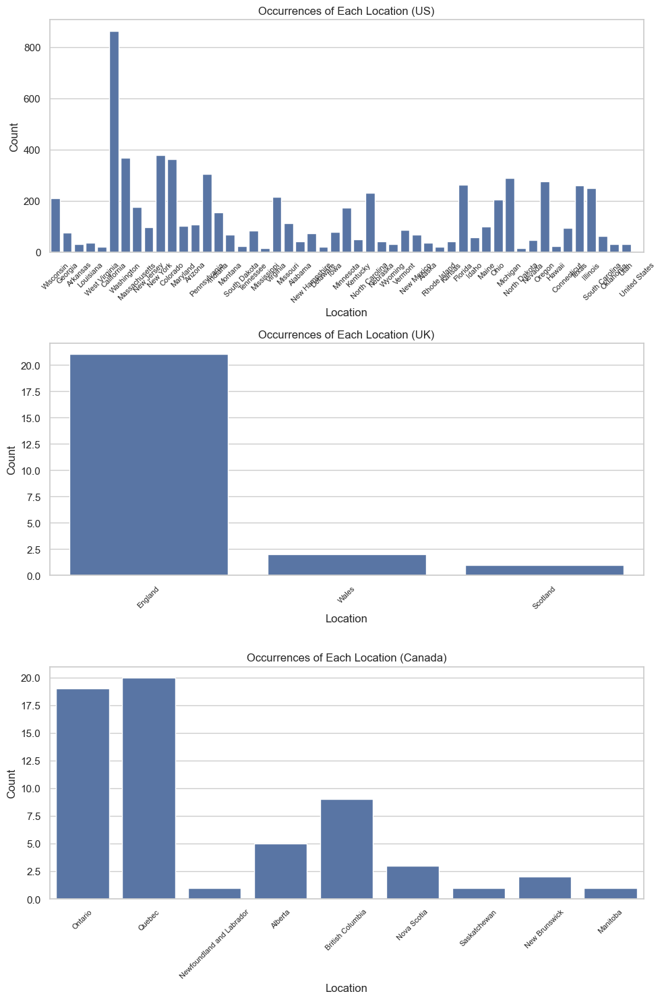

In [57]:
fig, axes = plt.subplots(3, 1, figsize=(10, 15))
sns.countplot(data=breweries_adv_filt[breweries_adv_filt['US'] == True], x='location_region', ax=axes[0])
axes[0].set_title('Occurrences of Each Location (US)')
axes[0].set_xlabel('Location')
axes[0].set_ylabel('Count')
axes[0].tick_params(axis='x', rotation=45, labelsize=8)

sns.countplot(data=breweries_adv_filt[breweries_adv_filt['UK'] == True], x='location_region', ax=axes[1])
axes[1].set_title('Occurrences of Each Location (UK)')
axes[1].set_xlabel('Location')
axes[1].set_ylabel('Count')
axes[1].tick_params(axis='x', rotation=45, labelsize=8)

sns.countplot(data=breweries_adv_filt[breweries_adv_filt['Canada'] == True], x='location_region', ax=axes[2])
axes[2].set_title('Occurrences of Each Location (Canada)')
axes[2].set_xlabel('Location')
axes[2].set_ylabel('Count')
axes[2].tick_params(axis='x', rotation=45, labelsize=8)

plt.tight_layout()
plt.show()


In [58]:
breweries_adv_filt.loc[breweries_adv_filt['location_region'] == "United States", 'location_region'] = np.nan

In [61]:
breweries_adv_filt = breweries_adv_filt.drop(columns=['link', 'Regions'], errors='ignore')
breweries_adv_filt.head()

,id,location,name,nbr_beers,location_region,US,UK,Canada
0,39912,Kyrgyzstan,Abdysh-Ata (Абдыш Ата),5,None,False,False,False
1,39913,Kyrgyzstan,Arpa (АРПА),1,None,False,False,False
2,39914,Kyrgyzstan,Bear Beer,4,None,False,False,False
3,39915,Kyrgyzstan,Blonder Pub,4,None,False,False,False
4,39916,Kyrgyzstan,Kellers Bier,2,None,False,False,False


Let's check for duplicates:

In [64]:
print(breweries_adv_filt['id'].duplicated().any())

duplicates = breweries_adv_filt['id'].duplicated()
duplicates.describe()

False


count     14522
unique        1
top       False
freq      14522
Name: id, dtype: object

Now we can merge the location column information to the beers dataset already processed:

In [67]:
breweries_adv_filt.rename(columns={'name': 'brewery_name'}, inplace=True)

beers_adv_filt_unique_location = beers_adv_filt_unique.merge(
    breweries_adv_filt[['brewery_name', 'location', 'location_region', 'US', 'UK', 'Canada']],
    on='brewery_name',
    how='left'
)

beers_adv_filt_unique_location.head()

,beer_id,beer_name,brewery_id,brewery_name,style,nbr_ratings,nbr_reviews,avg,ba_score,bros_score,abv,avg_computed,zscore,nbr_matched_valid_ratings,avg_matched_valid_ratings,location,location_region,US,UK,Canada
0,142544,Régab,37262,Societe des Brasseries du Gabon (SOBRAGA),Euro Pale Lager,1,1,2.88,NaN,NaN,4.5,2.880000,NaN,0,NaN,Gabon,None,False,False,False
1,19590,Barelegs Brew,10093,Strangford Lough Brewing Company Ltd,English Pale Ale,4,4,3.85,NaN,NaN,4.5,3.845000,NaN,0,NaN,Northern Ireland,None,False,False,False
2,19827,Legbiter,10093,Strangford Lough Brewing Company Ltd,English Pale Ale,75,59,3.45,80.0,80.0,4.8,3.439867,-0.649167,59,3.504068,Northern Ireland,None,False,False,False
3,20841,St. Patrick's Ale,10093,Strangford Lough Brewing Company Ltd,English Pale Ale,8,6,3.86,NaN,NaN,6.0,3.888750,0.093110,6,3.768333,Northern Ireland,None,False,False,False
4,20842,St. Patrick's Best,10093,Strangford Lough Brewing Company Ltd,English Bitter,64,48,3.56,82.0,90.0,4.2,3.556094,-0.478579,48,3.580417,Northern Ireland,None,False,False,False


### Users

In [70]:
users_adv = pd.read_csv("data/birre/BeerAdvocate/users.csv", sep=",")

In [72]:
utils.dataset_information(users_adv, "Users_BA")



########################################################
We are starting analysing dataset Users_BA
- Dimension of starting dataset: (153704, 6)
- Columns of dataset:  Index(['nbr_ratings', 'nbr_reviews', 'user_id', 'user_name', 'joined',
       'location'],
      dtype='object')
- Are all the id unique? Answer: False
- Are there some values that are NaN inside the dataset? Answer: True
Head: 
    nbr_ratings  nbr_reviews                user_id        user_name  \
0         7820          465         nmann08.184925          nmann08   
1         2521         2504     stjamesgate.163714      StJamesGate   
2         1797         1143          mdagnew.19527          mdagnew   
3           31           31  helloloser12345.10867  helloloser12345   
4          604          604        cypressbob.3708       cypressbob   

         joined                   location  
0  1.199704e+09  United States, Washington  
1  1.191838e+09    United States, New York  
2  1.116410e+09           Northern Ire

We need to deal with `joined` and `location`:

* `joined`: usage of datetime functions of `pandas` to transform the seconds into proper date structure.
* `location`: same approach as breweries and beers datasets. Division into `location`, `location_region` and booleans for quick identification of US, UK and Canada cases. 

In [75]:
users_adv.head()

,nbr_ratings,nbr_reviews,user_id,user_name,joined,location
0,7820,465,nmann08.184925,nmann08,1.199704e+09,"United States, Washington"
1,2521,2504,stjamesgate.163714,StJamesGate,1.191838e+09,"United States, New York"
2,1797,1143,mdagnew.19527,mdagnew,1.116410e+09,Northern Ireland
3,31,31,helloloser12345.10867,helloloser12345,1.101380e+09,Northern Ireland
4,604,604,cypressbob.3708,cypressbob,1.069326e+09,Northern Ireland


In [77]:
import pandas as pd
import numpy as np
import re

# Example data if needed to simulate users_adv DataFrame
# users_adv = pd.DataFrame({
#     'joined': [1199704000, 1191838000, 1116410000],
#     'location': ['United States, Washington', 'Northern Ireland', 'Canada, Ontario']
# })

# Convert the 'joined' column from UNIX timestamp to datetime
users_adv['joined'] = pd.to_datetime(users_adv['joined'], unit='s')

# Split 'location' into 'location' and 'location_region', filling with NaN where no comma is found
location_split = users_adv['location'].str.split(',', n=1, expand=True)
users_adv['location'] = location_split[0]
users_adv['location_region'] = location_split[1]

# Define pattern for UK-related locations
pattern = r"United Kingdom|Ireland|Northern Ireland|Scotland|England|Wales"

# Create boolean columns for specific regions
users_adv['US'] = users_adv['location'].str.contains("United States", case=False, na=False)
users_adv['UK'] = users_adv['location'].str.contains(pattern, case=False, na=False)
users_adv['Canada'] = users_adv['location'].str.contains("Canada", case=False, na=False)

# Remove redundant 'location_region' values if they match 'United States'
users_adv.loc[users_adv['location_region'] == "United States", 'location_region'] = np.nan

# Check for duplicate user IDs
duplicated_users_id_rows = users_adv[users_adv['user_id'].duplicated(keep=False)]

# Display the updated DataFrame and any duplicate user ID rows
print("Updated DataFrame with location and region separation:")
print(users_adv.head())

print("\nDuplicate user_id rows:")
print(duplicated_users_id_rows.head())



Updated DataFrame with location and region separation:
   nbr_ratings  nbr_reviews                user_id        user_name  \
0         7820          465         nmann08.184925          nmann08   
1         2521         2504     stjamesgate.163714      StJamesGate   
2         1797         1143          mdagnew.19527          mdagnew   
3           31           31  helloloser12345.10867  helloloser12345   
4          604          604        cypressbob.3708       cypressbob   

               joined          location location_region     US     UK  Canada  
0 2008-01-07 11:00:00     United States      Washington   True  False   False  
1 2007-10-08 10:00:00     United States        New York   True  False   False  
2 2005-05-18 10:00:00  Northern Ireland            None  False   True   False  
3 2004-11-25 11:00:00  Northern Ireland            None  False   True   False  
4 2003-11-20 11:00:00  Northern Ireland            None  False   True   False  

Duplicate user_id rows:
Empty DataFra

In [78]:
users_adv_unique= users_adv.drop_duplicates(subset='user_id', keep='first').reset_index(drop=True)
users_adv_unique.head()

,nbr_ratings,nbr_reviews,user_id,user_name,joined,location,location_region,US,UK,Canada
0,7820,465,nmann08.184925,nmann08,2008-01-07 11:00:00,United States,Washington,True,False,False
1,2521,2504,stjamesgate.163714,StJamesGate,2007-10-08 10:00:00,United States,New York,True,False,False
2,1797,1143,mdagnew.19527,mdagnew,2005-05-18 10:00:00,Northern Ireland,None,False,True,False
3,31,31,helloloser12345.10867,helloloser12345,2004-11-25 11:00:00,Northern Ireland,None,False,True,False
4,604,604,cypressbob.3708,cypressbob,2003-11-20 11:00:00,Northern Ireland,None,False,True,False


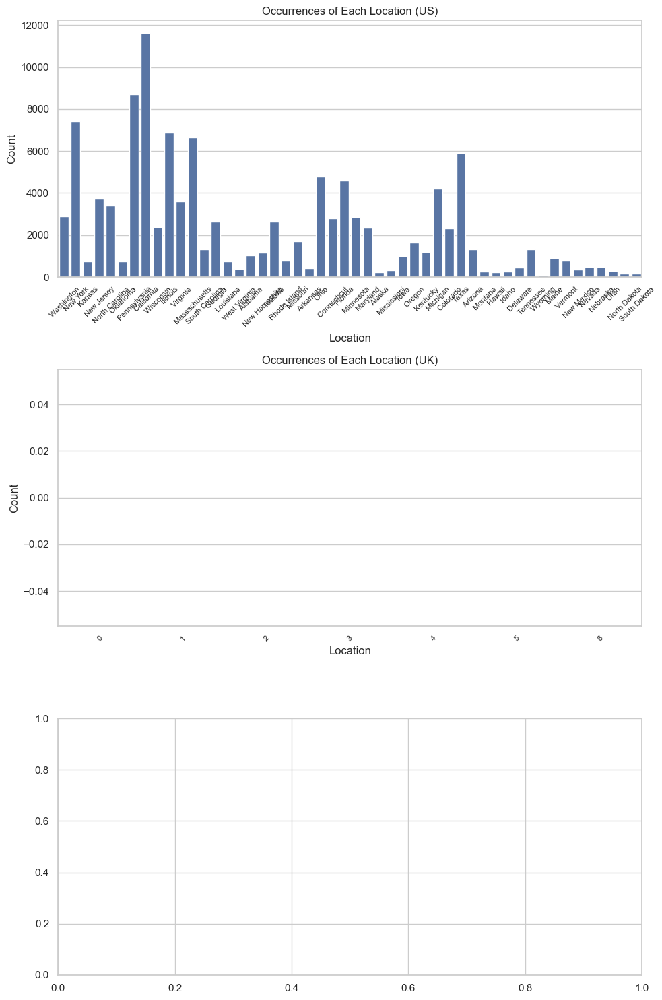

In [81]:
fig, axes = plt.subplots(3, 1, figsize=(10, 15))
sns.countplot(data=users_adv[users_adv['US'] == True], x='location_region', ax=axes[0])
axes[0].set_title('Occurrences of Each Location (US)')
axes[0].set_xlabel('Location')
axes[0].set_ylabel('Count')
axes[0].tick_params(axis='x', rotation=45, labelsize=8)

sns.countplot(data=users_adv[users_adv['UK'] == True], x='location_region', ax=axes[1])
axes[1].set_title('Occurrences of Each Location (UK)')
axes[1].set_xlabel('Location')
axes[1].set_ylabel('Count')
axes[1].tick_params(axis='x', rotation=45, labelsize=8)

"""
No regions in canada
sns.countplot(data=users_adv[users_adv['Canada'] == True], x='location_region', ax=axes[2])
axes[2].set_title('Occurrences of Each Location (Canada)')
axes[2].set_xlabel('Location')
axes[2].set_ylabel('Count')
axes[2].tick_params(axis='x', rotation=45, labelsize=8)
"""

plt.tight_layout()
plt.show()

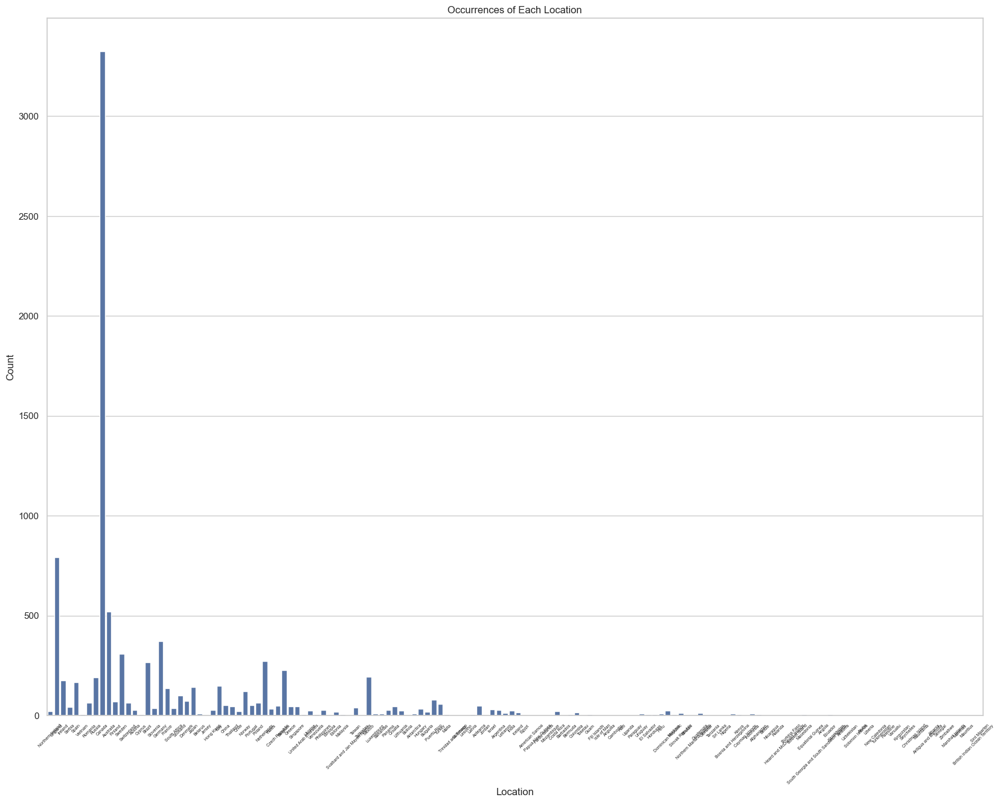

In [82]:
plt.figure(figsize=(20, 15))
sns.countplot(data=users_adv[users_adv['US'] == False], x='location')
plt.title('Occurrences of Each Location')
plt.xlabel('Location')
plt.ylabel('Count')
plt.xticks(rotation=45, fontsize=5) 
plt.show()


### Ratings

In [86]:
rating_BA=pd.read_csv('data/birre/BeerAdvocate/ratings_cleaned.csv')
utils.dataset_information(rating_BA, "Ratings RateBeer")



########################################################
We are starting analysing dataset Ratings RateBeer
- Dimension of starting dataset: (8392192, 17)
- Columns of dataset:  Index(['beer_name', 'beer_id', 'brewery_name', 'brewery_id', 'style', 'abv',
       'date', 'user_name', 'user_id', 'appearance', 'aroma', 'palate',
       'taste', 'overall', 'rating', 'text', 'review'],
      dtype='object')
- Are all the id unique? Answer: False
- Are there some values that are NaN inside the dataset? Answer: True
Head: 
        beer_name  beer_id                          brewery_name  brewery_id  \
0  Barelegs Brew    19590  Strangford Lough Brewing Company Ltd       10093   
1  Barelegs Brew    19590  Strangford Lough Brewing Company Ltd       10093   
2  Barelegs Brew    19590  Strangford Lough Brewing Company Ltd       10093   
3  Barelegs Brew    19590  Strangford Lough Brewing Company Ltd       10093   
4       Legbiter    19827  Strangford Lough Brewing Company Ltd       10093   

 

In [87]:
rating_BA_cleaned = rating_BA.dropna(subset=['rating', 'date'])

rating_BA_cleaned = rating_BA.drop_duplicates(subset=['beer_name','date', 'user_name'])

rating_min = rating_BA_cleaned['rating'].min()
rating_max = rating_BA_cleaned['rating'].max()



In [88]:
ratings_adv_locations = rating_BA_cleaned.merge(
    breweries_adv_filt[['brewery_name', 'location', 'location_region', 'US', 'UK', 'Canada']],
    on='brewery_name',
    how='left'
)



In [89]:

columns_rename = {
    'location': 'location_beer',
    'location_region': 'location_region_beer',
    'US': 'US_beer',
    'UK': 'UK_beer',
    'Canada': 'Canada_beer'
}
ratings_adv_locations = ratings_adv_locations.rename(columns=columns_rename)

In [90]:
ratings_adv_locations_complete = ratings_adv_locations.merge(
    users_adv_unique[['user_name', 'location', 'location_region', 'US', 'UK', 'Canada']],
    on='user_name',
    how='left'
)

columns_rename = {
    'location': 'location_user',
    'location_region': 'location_region_user',
    'US': 'US_user',
    'UK': 'UK_user',
    'Canada': 'Canada_user'
}
ratings_adv_locations_complete = ratings_adv_locations_complete.rename(columns=columns_rename)


In [91]:
ratings_adv_locations_complete['date'] = pd.to_datetime(ratings_adv_locations_complete['date'], unit='s')
ratings_adv_locations_complete['year'] = ratings_adv_locations_complete['date'].dt.year


ratings_adv_locations_complete.head()

,beer_name,beer_id,brewery_name,brewery_id,style,abv,date,user_name,user_id,appearance,...,location_region_beer,US_beer,UK_beer,Canada_beer,location_user,location_region_user,US_user,UK_user,Canada_user,year
0,Barelegs Brew,19590,Strangford Lough Brewing Company Ltd,10093,English Pale Ale,4.5,2009-02-20 11:00:00,StJamesGate,stjamesgate.163714,3.0,...,None,False,False,False,United States,New York,True,False,False,2009
1,Barelegs Brew,19590,Strangford Lough Brewing Company Ltd,10093,English Pale Ale,4.5,2006-03-13 11:00:00,mdagnew,mdagnew.19527,4.0,...,None,False,False,False,Northern Ireland,None,False,True,False,2006
2,Barelegs Brew,19590,Strangford Lough Brewing Company Ltd,10093,English Pale Ale,4.5,2004-12-01 11:00:00,helloloser12345,helloloser12345.10867,4.0,...,None,False,False,False,Northern Ireland,None,False,True,False,2004
3,Barelegs Brew,19590,Strangford Lough Brewing Company Ltd,10093,English Pale Ale,4.5,2004-08-30 10:00:00,cypressbob,cypressbob.3708,4.0,...,None,False,False,False,Northern Ireland,None,False,True,False,2004
4,Legbiter,19827,Strangford Lough Brewing Company Ltd,10093,English Pale Ale,4.8,2014-12-01 11:00:00,Hellpop65,hellpop65.48993,NaN,...,None,False,False,False,United States,Kansas,True,False,False,2014


In [92]:
ratings_adv_locations_complete_filt = ratings_adv_locations_complete.dropna(subset=['beer_id', 'user_id'])
utils.dataset_information(ratings_adv_locations_complete_filt, "Ratings filtered")



########################################################
We are starting analysing dataset Ratings filtered
- Dimension of starting dataset: (9118334, 28)
- Columns of dataset:  Index(['beer_name', 'beer_id', 'brewery_name', 'brewery_id', 'style', 'abv',
       'date', 'user_name', 'user_id', 'appearance', 'aroma', 'palate',
       'taste', 'overall', 'rating', 'text', 'review', 'location_beer',
       'location_region_beer', 'US_beer', 'UK_beer', 'Canada_beer',
       'location_user', 'location_region_user', 'US_user', 'UK_user',
       'Canada_user', 'year'],
      dtype='object')
- Are all the id unique? Answer: False
- Are there some values that are NaN inside the dataset? Answer: True
Head: 
        beer_name  beer_id                          brewery_name  brewery_id  \
0  Barelegs Brew    19590  Strangford Lough Brewing Company Ltd       10093   
1  Barelegs Brew    19590  Strangford Lough Brewing Company Ltd       10093   
2  Barelegs Brew    19590  Strangford Lough Brewing Co

In [96]:
utils.ensure_col_types2(ratings_adv_locations_complete_filt, ['beer_id','brewery_id','user_id'],['abv'],['beer_name','brewery_name','style','user_name'])

AttributeError: module 'utils' has no attribute 'ensure_col_types2'

In [99]:
missing_beers = ratings_adv_locations_complete[~ratings_adv_locations_complete['beer_id'].isin(beers_adv_filt_unique_location['beer_id'])]

if missing_beers.empty:
    print("All 'beers_id' in the ratings dataset are present in the beers_adv dataset.")
else:
    print(f"The following 'beers_id' are missing in beers_adv:\n{missing_beers['beer_id'].unique()}")


The following 'beers_id' are missing in beers_adv:
[153718 178689 247044 ... 171765 101261 148940]


In [101]:
ratings_adv_locations_complete_filt = ratings_adv_locations_complete_filt[
    ratings_adv_locations_complete_filt['beer_id'].isin(beers_adv_filt_unique_location['beer_id']) & ratings_adv_locations_complete_filt['user_name'].isin(users_adv_unique['user_name'])
]
utils.dataset_information(ratings_adv_locations_complete_filt, "Missing beers")



########################################################
We are starting analysing dataset Missing beers
- Dimension of starting dataset: (8907682, 28)
- Columns of dataset:  Index(['beer_name', 'beer_id', 'brewery_name', 'brewery_id', 'style', 'abv',
       'date', 'user_name', 'user_id', 'appearance', 'aroma', 'palate',
       'taste', 'overall', 'rating', 'text', 'review', 'location_beer',
       'location_region_beer', 'US_beer', 'UK_beer', 'Canada_beer',
       'location_user', 'location_region_user', 'US_user', 'UK_user',
       'Canada_user', 'year'],
      dtype='object')
- Are all the id unique? Answer: False
- Are there some values that are NaN inside the dataset? Answer: True
Head: 
        beer_name  beer_id                          brewery_name  brewery_id  \
0  Barelegs Brew    19590  Strangford Lough Brewing Company Ltd       10093   
1  Barelegs Brew    19590  Strangford Lough Brewing Company Ltd       10093   
2  Barelegs Brew    19590  Strangford Lough Brewing Compa

In [102]:
# Total rows
total_rows = len(ratings_adv_locations_complete_filt)

# Count of NaN values in 'text' column
nan_text_count = ratings_adv_locations_complete_filt['text'].isna().sum()

print("Total NaN values in 'text':", nan_text_count)
print("Total rows in dataset:", total_rows)


Total NaN values in 'text': 5936827
Total rows in dataset: 8907682


In [103]:
# Drop rows where 'text' column has NaN values
df_cleaned = ratings_adv_locations_complete_filt.dropna(subset=['text'])


# Check new dimensions to confirm rows with NaN in 'text' were dropped
print("New dataset dimensions:", df_cleaned.shape)
print(df_cleaned['text'])

New dataset dimensions: (2970855, 28)
0          Pours pale copper with a thin head that quickl...
1          500ml Bottle bought from The Vintage, Antrim.....
2          Serving: 500ml brown bottlePour: Good head wit...
3          500ml bottlePours with a light, slightly hazy ...
11         This was a 12 oz bottle poured into a snifter....
                                 ...                        
9118328    It may say APA on this site, but talking to th...
9118329    I'll start off reviewing this beer with the fo...
9118330    Served on draft at the pub. Poured a clear yel...
9118331    Served on tap at the brewpub in a pint glass.A...
9118333    Dark brown brew served on tap at the brewpub. ...
Name: text, Length: 2970855, dtype: object


## Processed savings

In [ ]:
confirmation = input("Do you want to save the processed files? Type 'yes' to confirm: ").strip().lower()

if confirmation == 'yes':
    utils.write_csv_into_directory('data/Processed/BeerAdvocate', 'beers_processed.csv', beers_adv_filt_unique_location)
    utils.write_csv_into_directory('data/Processed/BeerAdvocate', 'breweries_processed.csv', breweries_adv_filt)
    utils.write_csv_into_directory('data/Processed/BeerAdvocate', 'users_processed.csv', users_adv_unique)
    utils.write_csv_into_directory('data/Processed/BeerAdvocate', 'ratings_processed.csv', ratings_adv_locations_complete_filt)
    utils.write_csv_into_directory('data/Processed/BeerAdvocate', 'review_processed.csv', df_cleaned)
    print("Files saved successfully!")
else:
    print("Operation canceled. No files were saved.")

# Task 3:Analysis of Beers, Breweries, Users, and Ratings

In [102]:
from collections import Counter

total_ba=ratings_adv_locations_complete_filt.copy()


## The goal of this analysis is to explore and understand preferences and patterns in beer ratings, focusing on the relationships between beers, styles, breweries, user locations, and ratings. We aim to address the following key questions

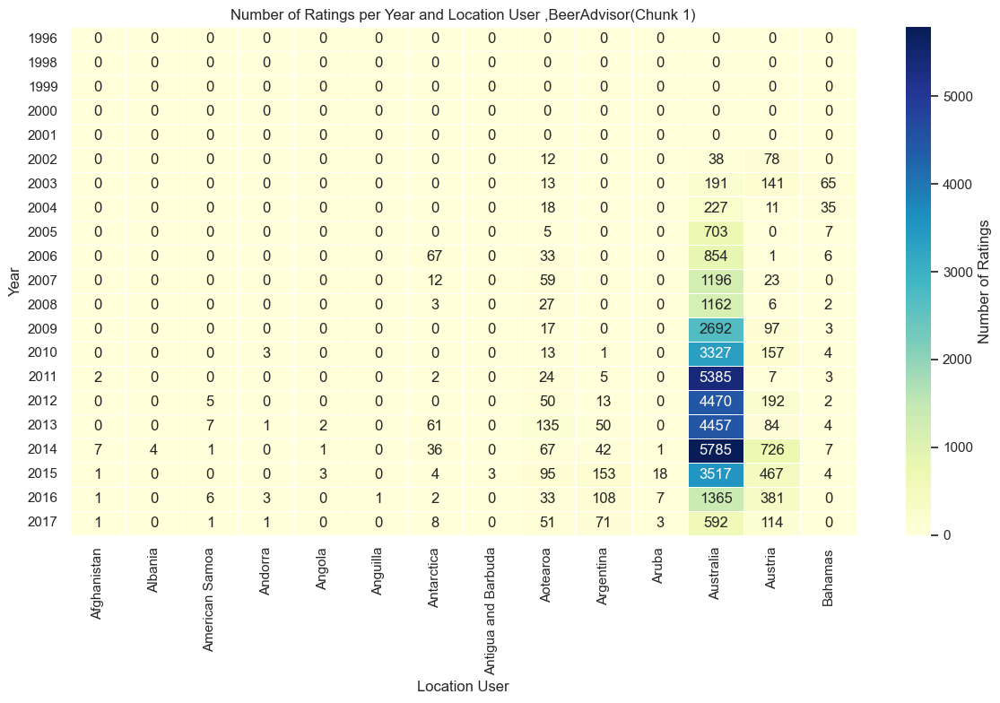

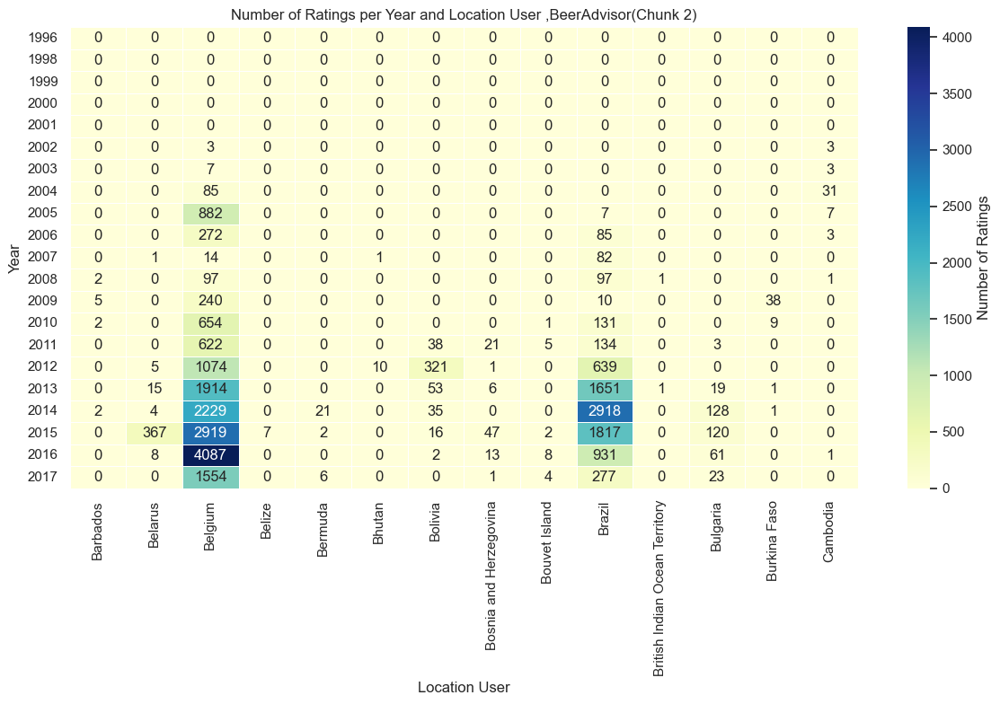

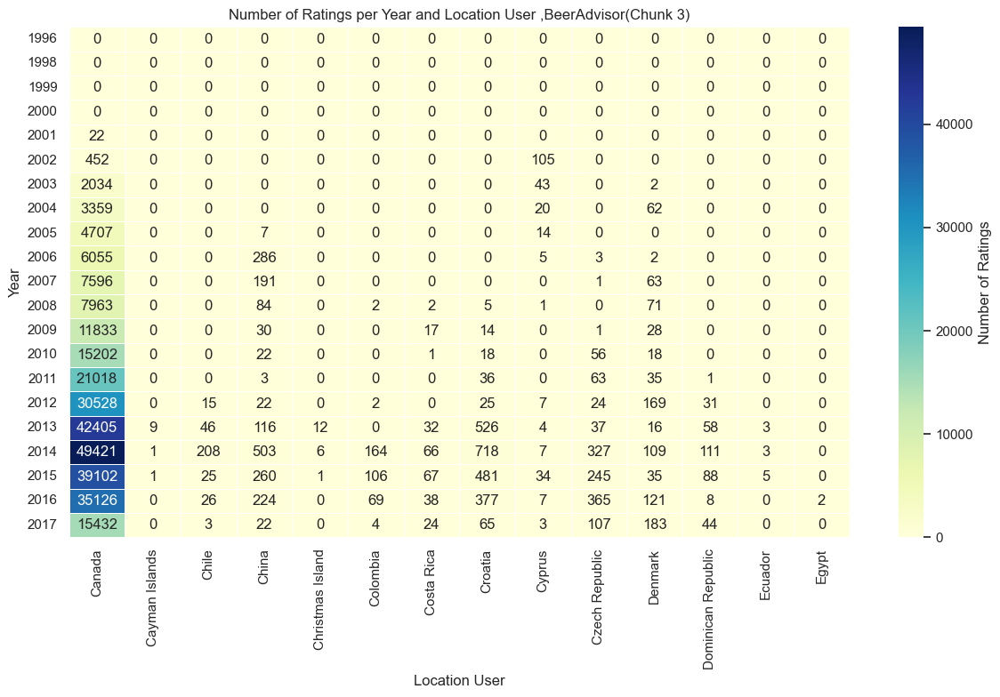

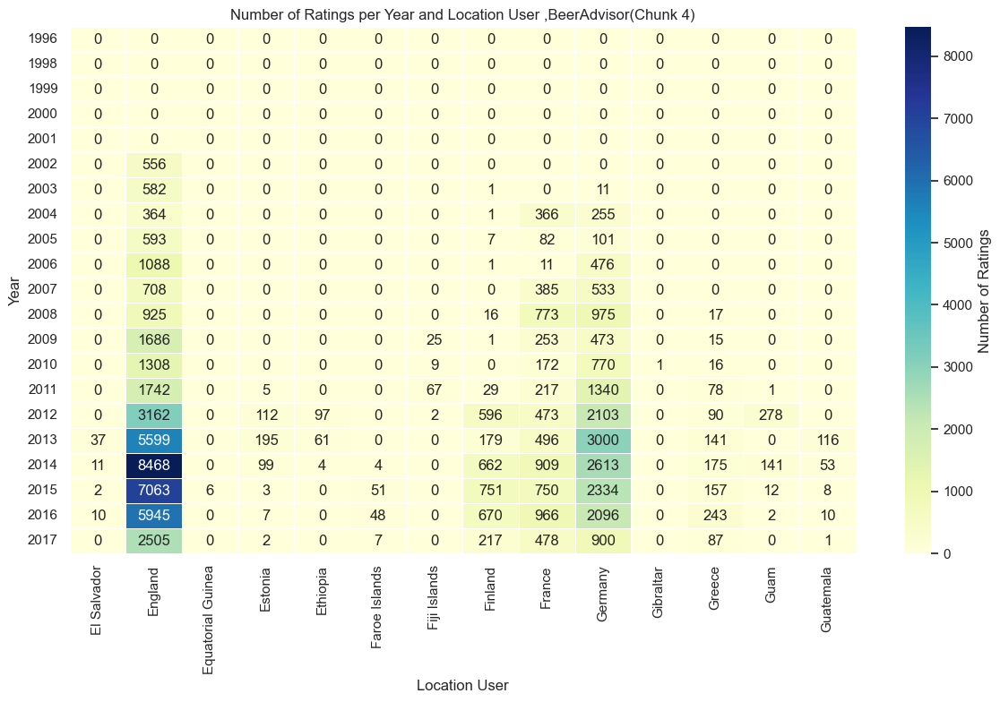

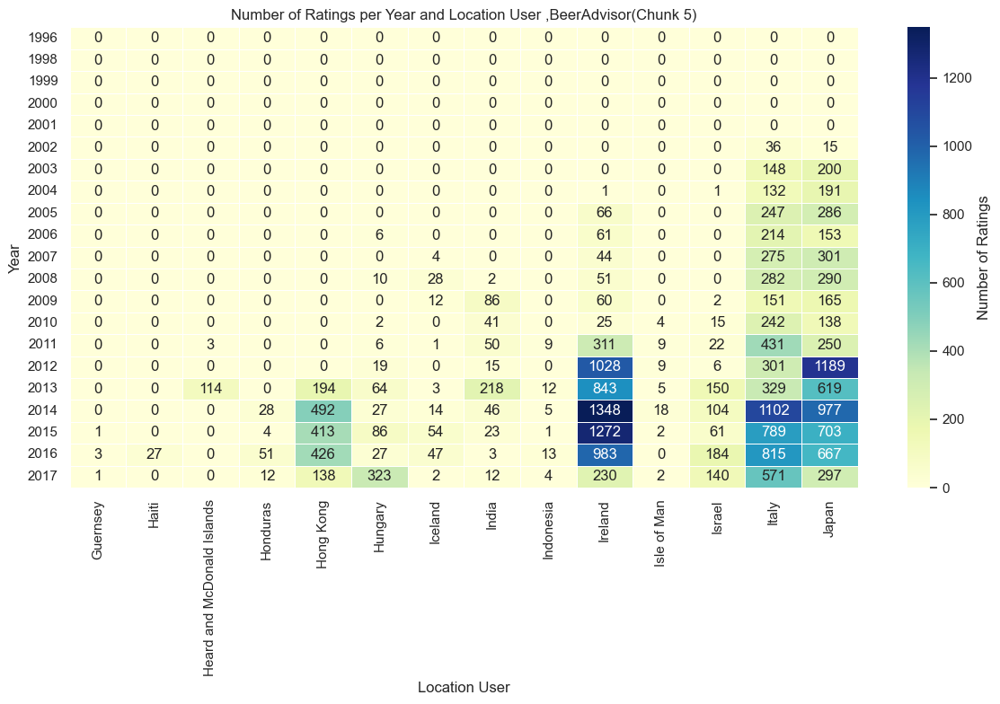

...

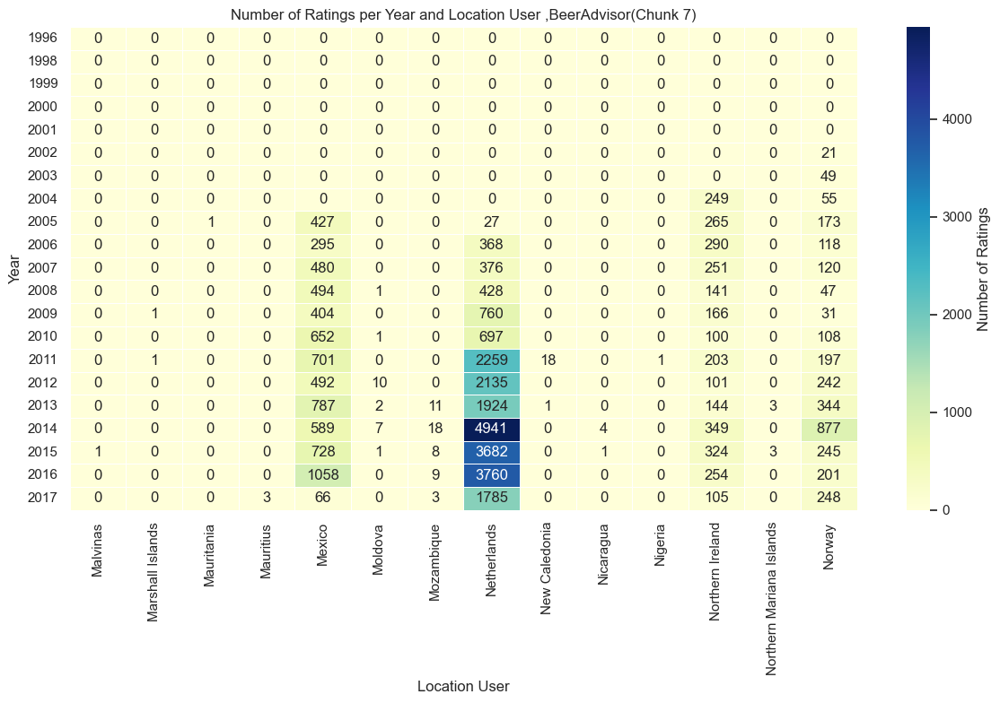

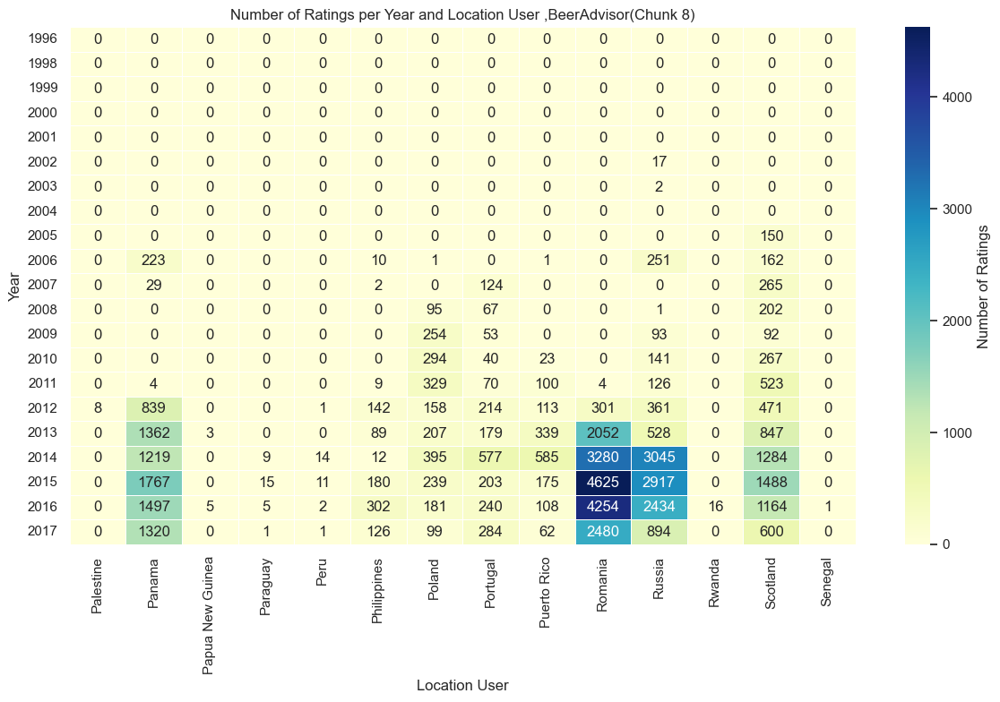

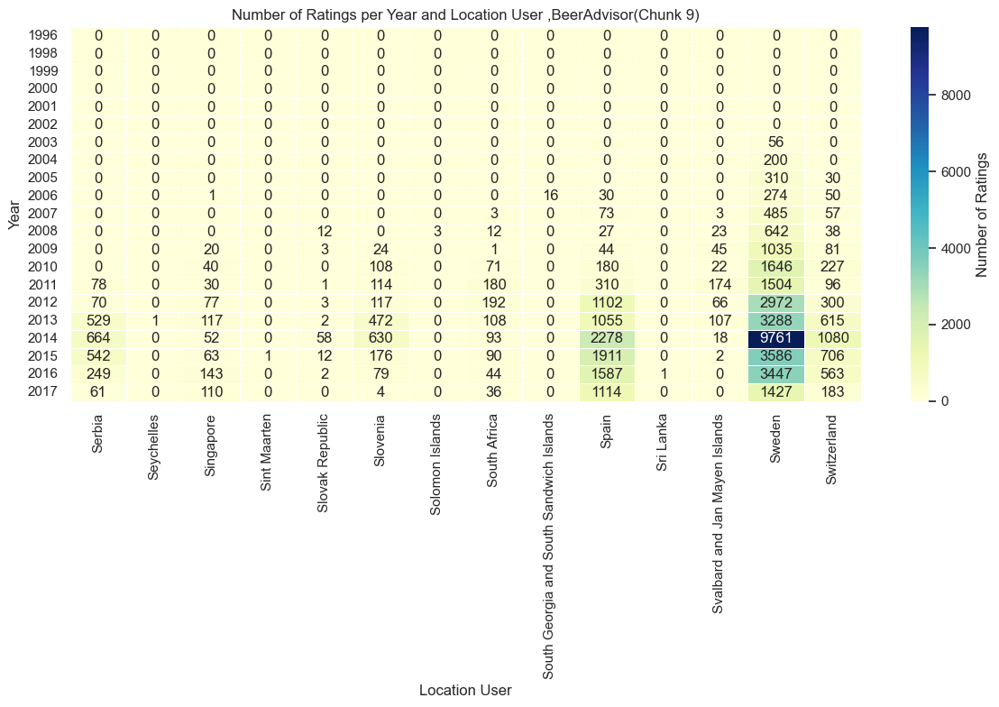

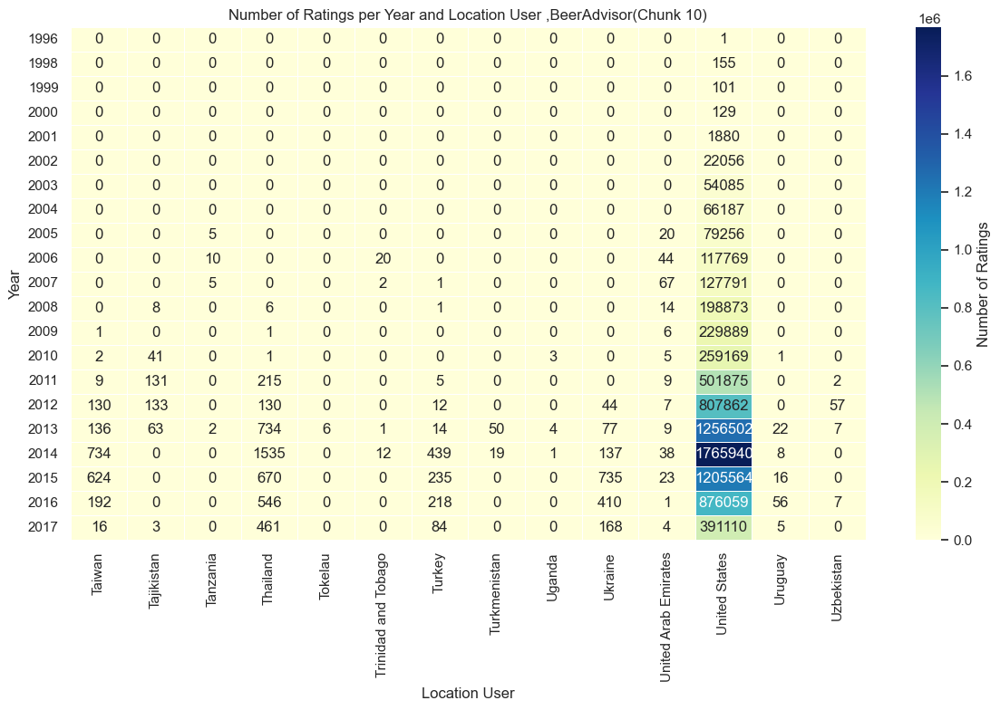

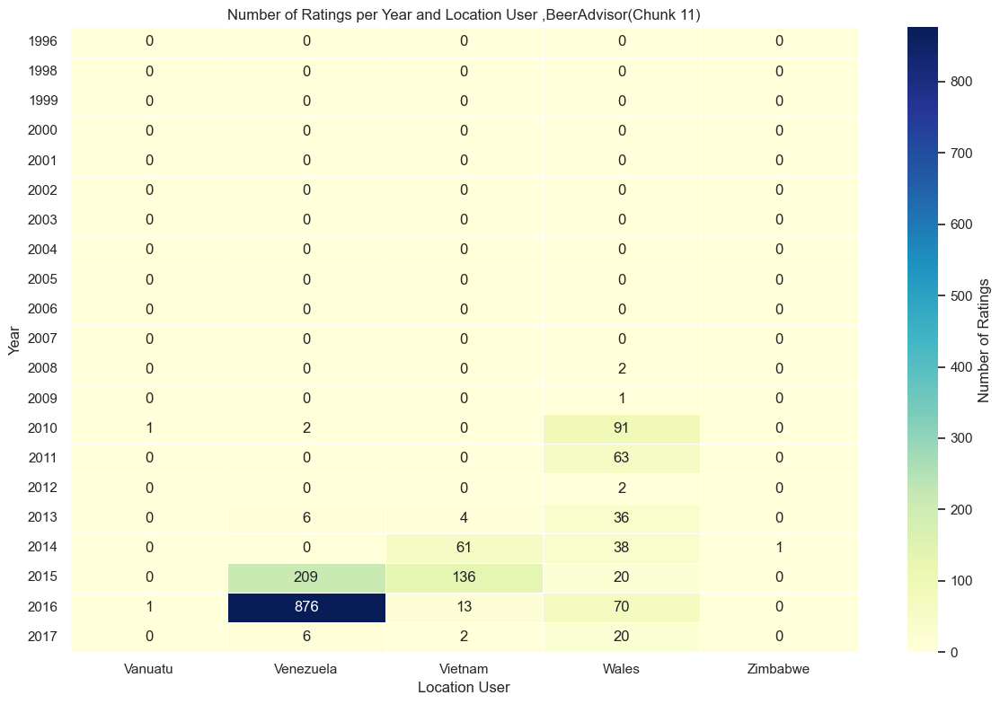

In [105]:
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd


ratings_per_location_year = total_ba.groupby(['year', 'location_user']).size().reset_index(name='num_ratings')


ratings_pivot = ratings_per_location_year.pivot_table(index='year', columns='location_user', values='num_ratings', aggfunc='sum')


ratings_pivot = ratings_pivot.fillna(0).astype(int)  # Fill NaN with 0 and convert to int


num_chunks = len(ratings_pivot.columns) // 14 + (1 if len(ratings_pivot.columns) % 14 != 0 else 0)  # Calculate number of chunks
for i in range(num_chunks):
    
    start_col = i * 14
    end_col = start_col + 14
    chunk = ratings_pivot.iloc[:, start_col:end_col]

    
    plt.figure(figsize=(12, 8))
    sns.heatmap(chunk, cmap='YlGnBu', annot=True, fmt='d', linewidths=0.5, cbar_kws={'label': 'Number of Ratings'})

    
    plt.title(f'Number of Ratings per Year and Location User ,BeerAdvisor(Chunk {i+1})')
    plt.xlabel('Location User')
    plt.ylabel('Year')
    plt.tight_layout()
    plt.show()


/var/folders/np/3hhzvb2x6znbzvj6ph2phb8h0000gn/T/ipykernel_60933/834551646.py:1: DtypeWarning: Columns (17) have mixed types. Specify dtype option on import or set low_memory=False.
  total_rb=pd.read_csv('ratings_processed.csv')


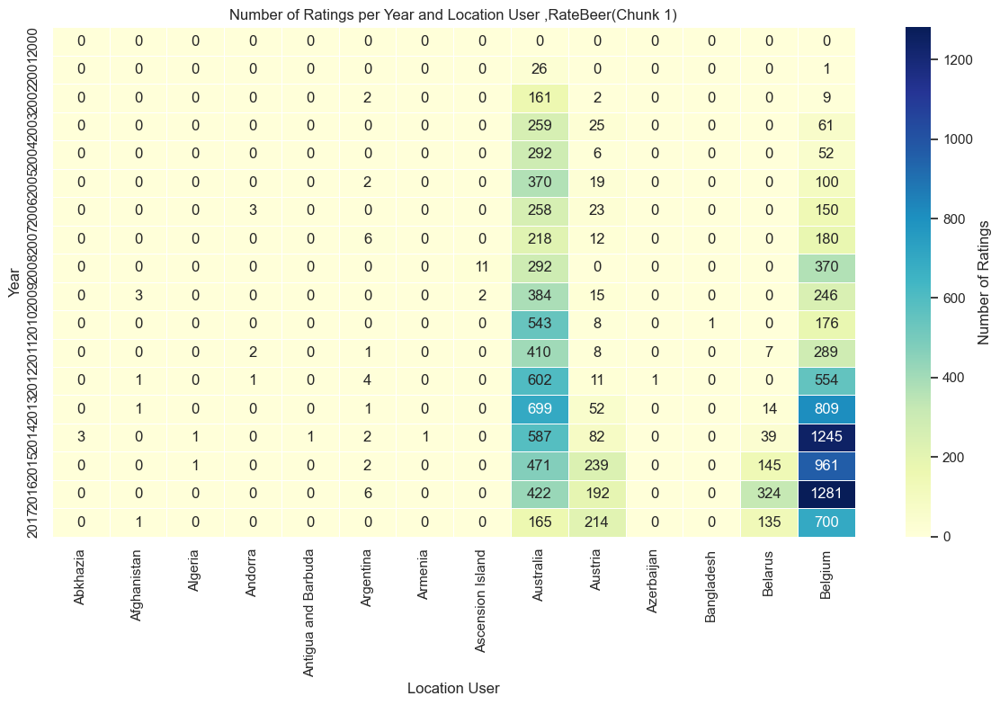

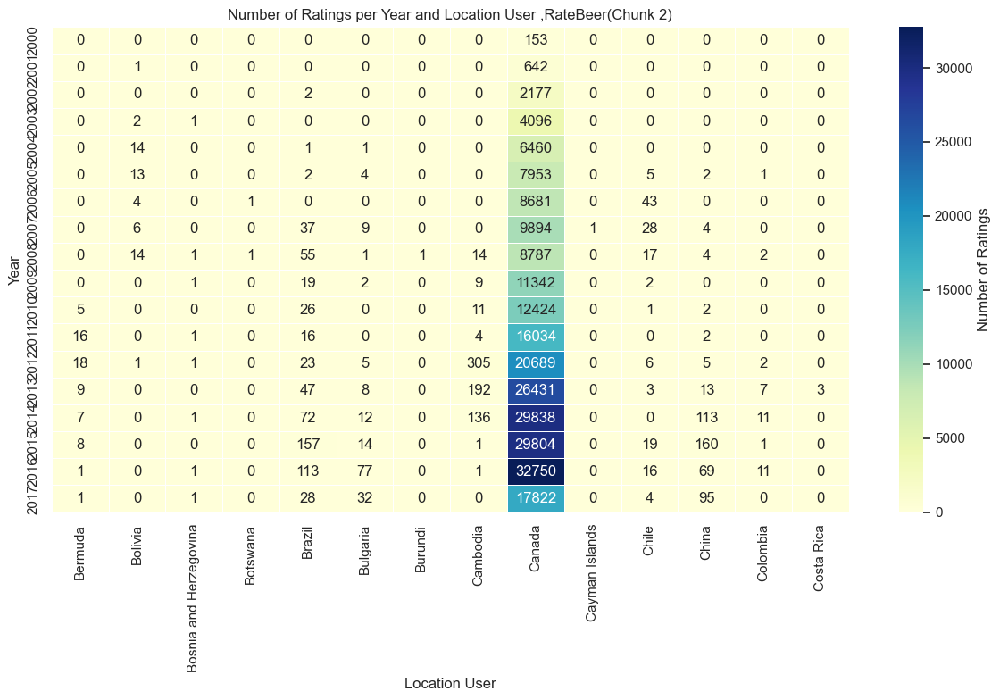

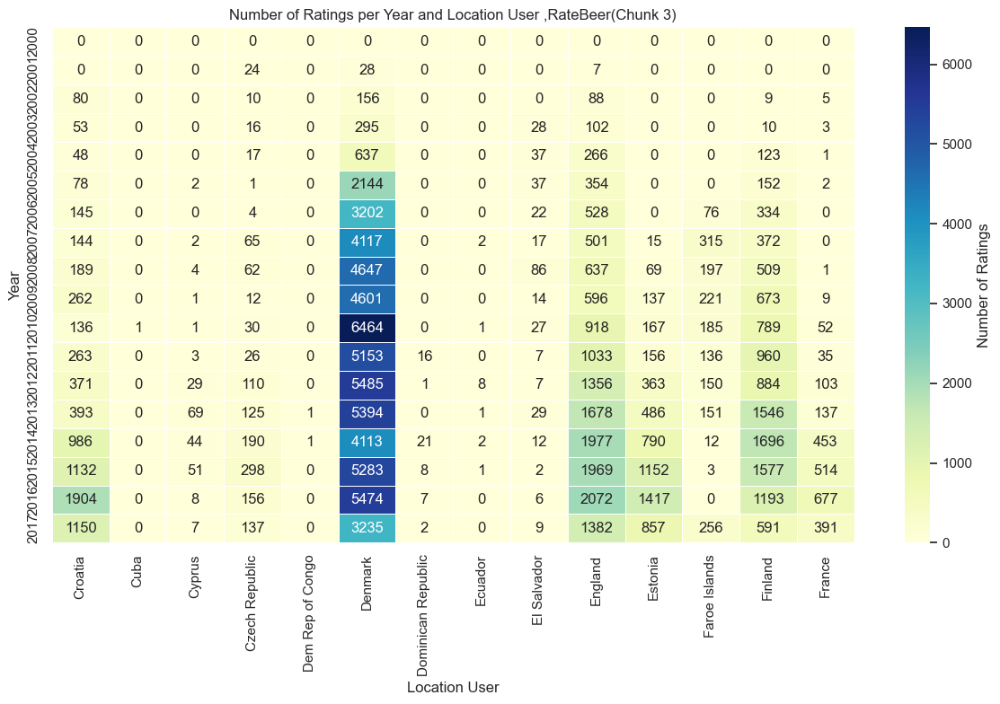

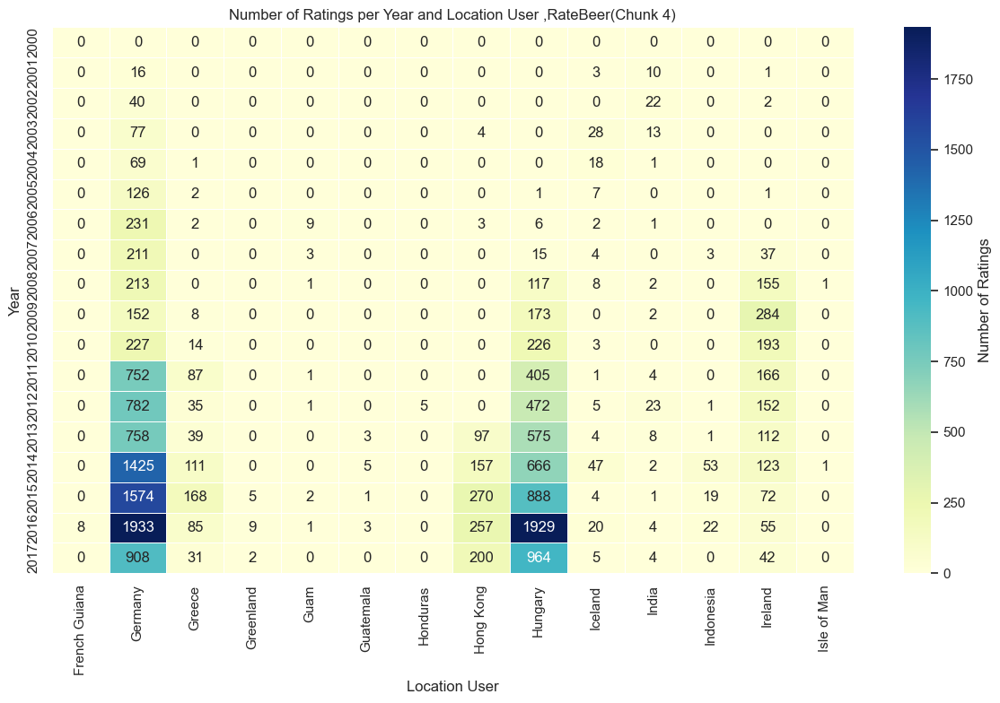

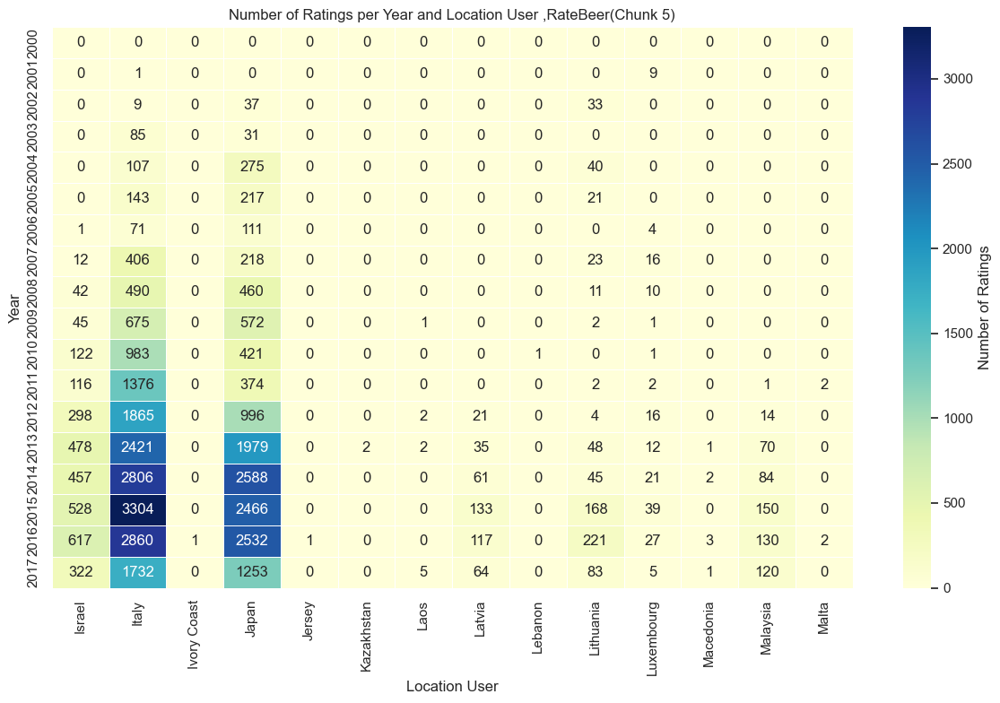

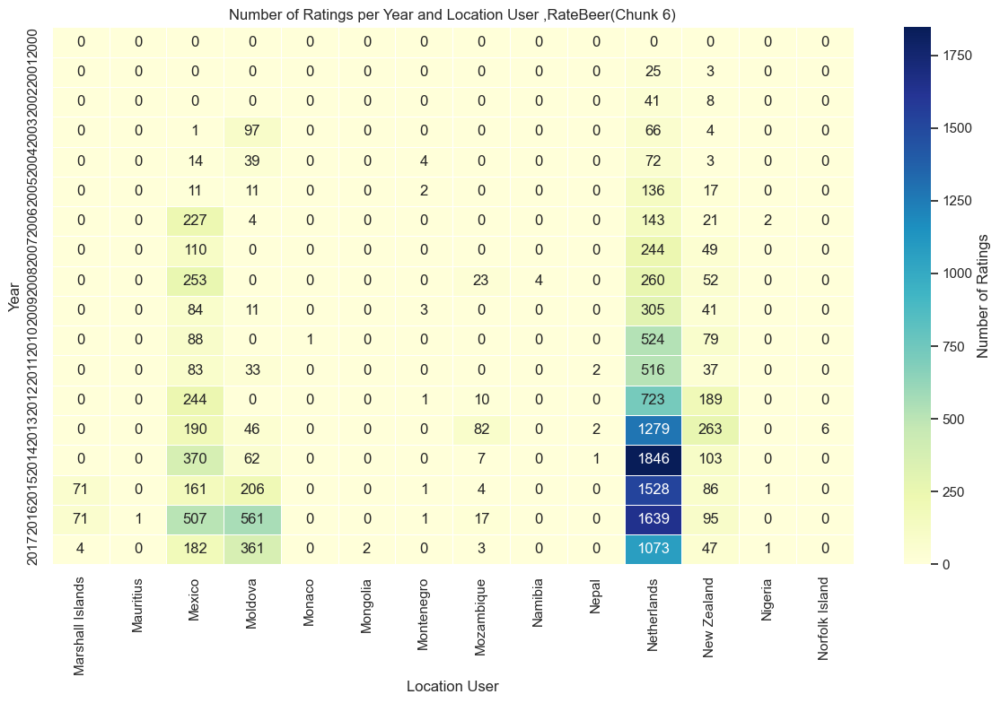

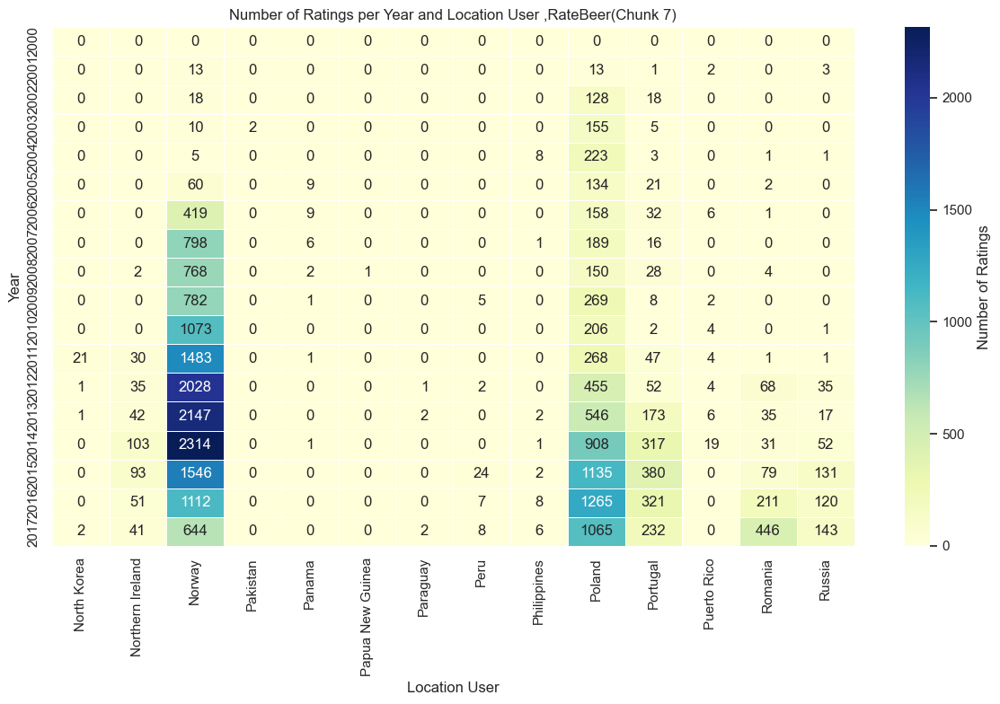

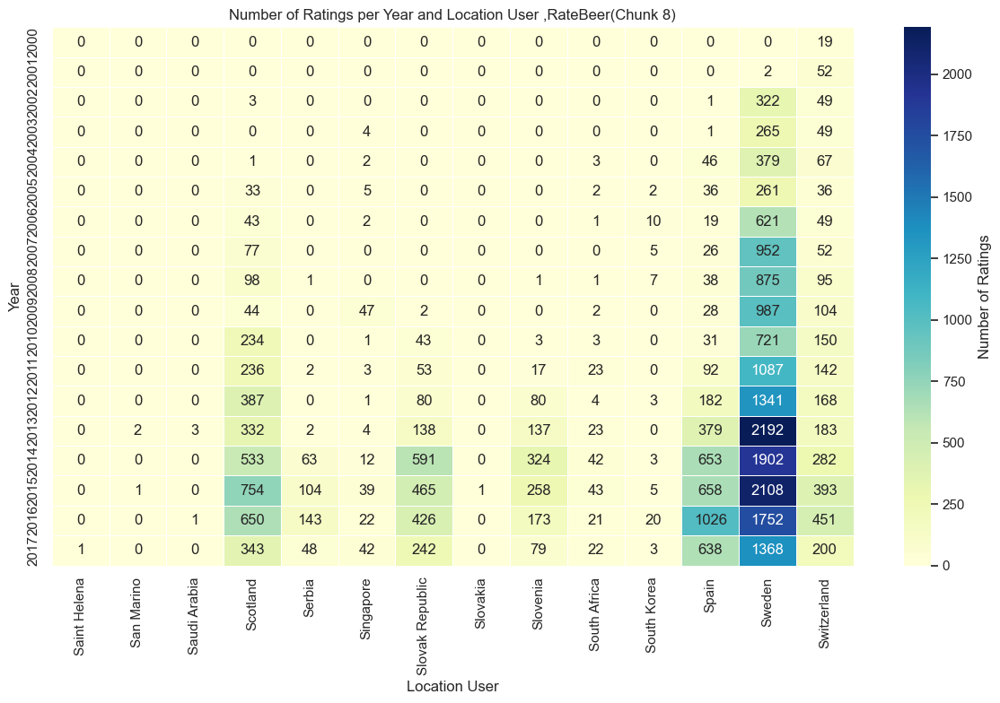

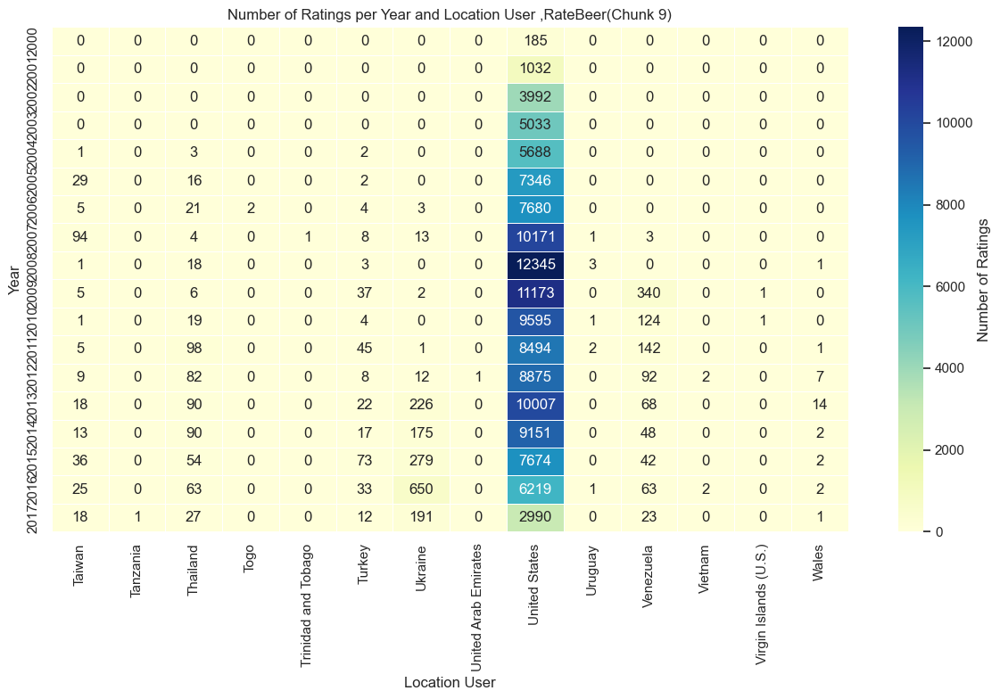

In [106]:


total_rb=pd.read_csv('ratings_processed.csv')
total_rb['date'] = pd.to_datetime(total_rb['date'], errors='coerce')
total_rb['year'] = total_rb['date'].dt.year

ratings_per_location_year_rb = total_rb.groupby(['year', 'location_user']).size().reset_index(name='num_ratings')


ratings_pivot_rb = ratings_per_location_year_rb.pivot_table(index='year', columns='location_user', values='num_ratings', aggfunc='sum')


ratings_pivot_rb = ratings_pivot_rb.fillna(0).astype(int)  # Fill NaN with 0 and convert to int


num_chunks = len(ratings_pivot_rb.columns) // 14 + (1 if len(ratings_pivot_rb.columns) % 14 != 0 else 0)  # Calculate number of chunks
for i in range(num_chunks):
    
    start_col = i * 14
    end_col = start_col + 14
    chunk = ratings_pivot_rb.iloc[:, start_col:end_col]

    
    plt.figure(figsize=(12, 8))
    sns.heatmap(chunk, cmap='YlGnBu', annot=True, fmt='d', linewidths=0.5, cbar_kws={'label': 'Number of Ratings'})

    
    plt.title(f'Number of Ratings per Year and Location User ,RateBeer(Chunk {i+1})')
    plt.xlabel('Location User')
    plt.ylabel('Year')

    
    plt.tight_layout()
    plt.show()


These heatmaps provide a clear visual representation of beer ratings activity across different years and locations, allowing you to quickly identify trends, patterns, and areas of growth in beer ratings. They can help us understand the geographical spread of beer consumption and review activity, user participation, and potential regional interests or trends. We can see that on different site some user are more active than on the other, like English user use more BeerAdvocate. On BeerAdvocate in general there more user and more review

In [109]:


review_counts_ba = total_ba.groupby(['beer_id']).size().reset_index(name='review_count')


reviews_with_counts_ba = pd.merge(total_ba, review_counts_ba, on=['beer_id'])
filtered_reviews_ba = reviews_with_counts_ba[reviews_with_counts_ba['review_count'] >= 5]


weighted_avg_ratings_ba = filtered_reviews_ba.groupby(['beer_id', 'beer_name', 'year', 'review_count','location_user']).apply(
    lambda x: (x['rating'] * x['review_count']).sum() / x['review_count'].sum()
).reset_index(name='weighted_avg_rating')

weighted_avg_ratings_ba['rank'] = (
    weighted_avg_ratings_ba.sort_values(['year', 'location_user', 'weighted_avg_rating', 'review_count'], 
                                        ascending=[True, True, False, False])
    .groupby(['year', 'location_user'])
    .cumcount() + 1
)

# Check results
weighted_avg_ratings_ba.head()


/var/folders/np/3hhzvb2x6znbzvj6ph2phb8h0000gn/T/ipykernel_60933/3480387892.py:8: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  weighted_avg_ratings_ba = filtered_reviews_ba.groupby(['beer_id', 'beer_name', 'year', 'review_count','location_user']).apply(


,beer_id,beer_name,year,review_count,location_user,weighted_avg_rating,rank
0,4,Wildcatter's Crude Stout,2002,10,United States,3.630,2289
1,4,Wildcatter's Crude Stout,2003,10,United States,3.834,2379
2,4,Wildcatter's Crude Stout,2004,10,United States,3.210,5527
3,4,Wildcatter's Crude Stout,2005,10,United States,3.375,5654
4,5,Amber,2001,1678,United States,4.000,379


In [110]:

total_rb_counts = total_rb.groupby(['beer_id']).size().reset_index(name='review_count')

# Step 2: Merge back to the main DataFrame and filter for groups with at least 5 reviews
total_rb_with_counts = pd.merge(total_rb, total_rb_counts, on=['beer_id'])
filtered_total_rb = total_rb_with_counts[total_rb_with_counts['review_count'] >= 5]

# Step 3: Calculate weighted average rating for each group
weighted_avg_ratings_rb = filtered_total_rb.groupby(['beer_id', 'beer_name', 'year', 'review_count','location_user']).apply(
    lambda x: (x['rating'] * x['review_count']).sum() / x['review_count'].sum()
).reset_index(name='weighted_avg_rating')

weighted_avg_ratings_rb['rank'] = (
    weighted_avg_ratings_rb.sort_values(['year', 'location_user', 'weighted_avg_rating', 'review_count'], 
                                        ascending=[True, True, False, False])
    .groupby(['year', 'location_user'])
    .cumcount() + 1
)

# Check results
weighted_avg_ratings_rb.head()

/var/folders/np/3hhzvb2x6znbzvj6ph2phb8h0000gn/T/ipykernel_60933/1675923232.py:8: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  weighted_avg_ratings_rb = filtered_total_rb.groupby(['beer_id', 'beer_name', 'year', 'review_count','location_user']).apply(


,beer_id,beer_name,year,review_count,location_user,weighted_avg_rating,rank
0,27,Big Rock Köld,2000,58,Canada,2.350000,68
1,27,Big Rock Köld,2001,58,Canada,3.450000,83
2,27,Big Rock Köld,2002,58,Canada,1.914286,563
3,27,Big Rock Köld,2003,58,Canada,2.714286,520
4,27,Big Rock Köld,2003,58,Poland,1.900000,129


A weighted average gives more importance to categories with a higher of ratings, ensuring that popular items (with many reviews) influence the results more than less-reviewed ones

To maintain reliability, we included only categories beers that received at least 5 ratings, for each category that we are studing. This prevents skewed results from underrepresented categories.


In [113]:
# Pivot data for heatmap
top_ranked_beers_ba = weighted_avg_ratings_ba[weighted_avg_ratings_ba['rank'] == 1]

pivot_data_ba =top_ranked_beers_ba.pivot_table(
    values='weighted_avg_rating', 
    index='year', 
    columns='location_user', 
    aggfunc='mean'
)





In [114]:
# Pivot data for heatmap
top_ranked_beers_rb = weighted_avg_ratings_rb[weighted_avg_ratings_rb['rank'] == 1]

pivot_data_rb =top_ranked_beers_rb.pivot_table(
    values='weighted_avg_rating', 
    index='year', 
    columns='location_user', 
    aggfunc='mean'
)


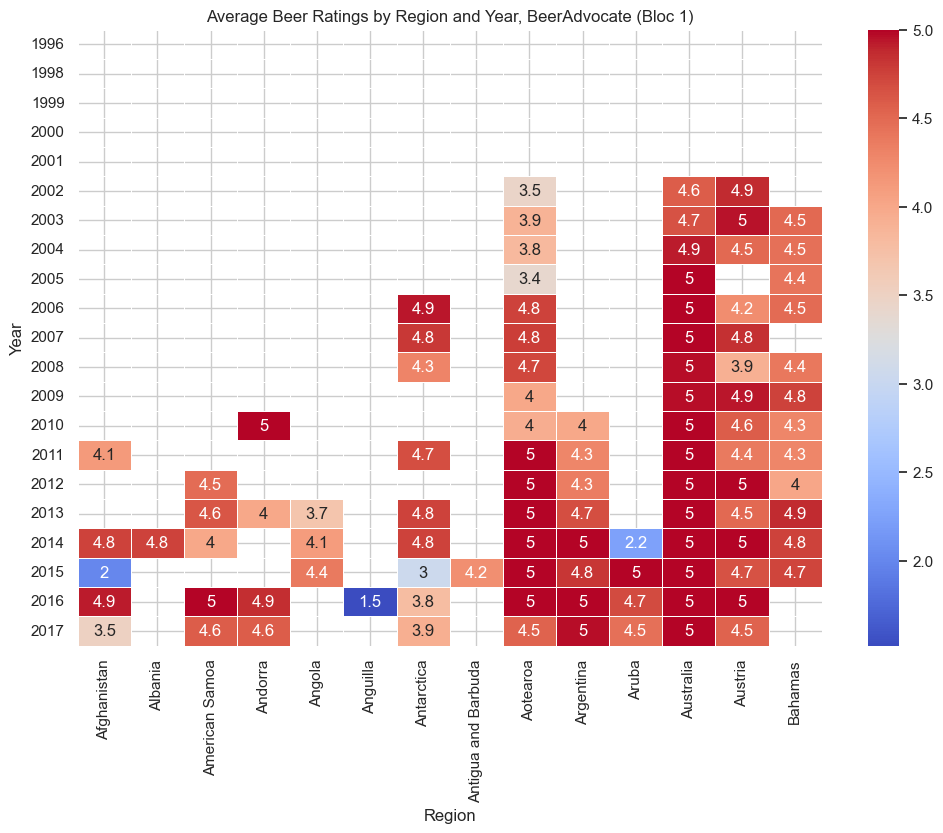

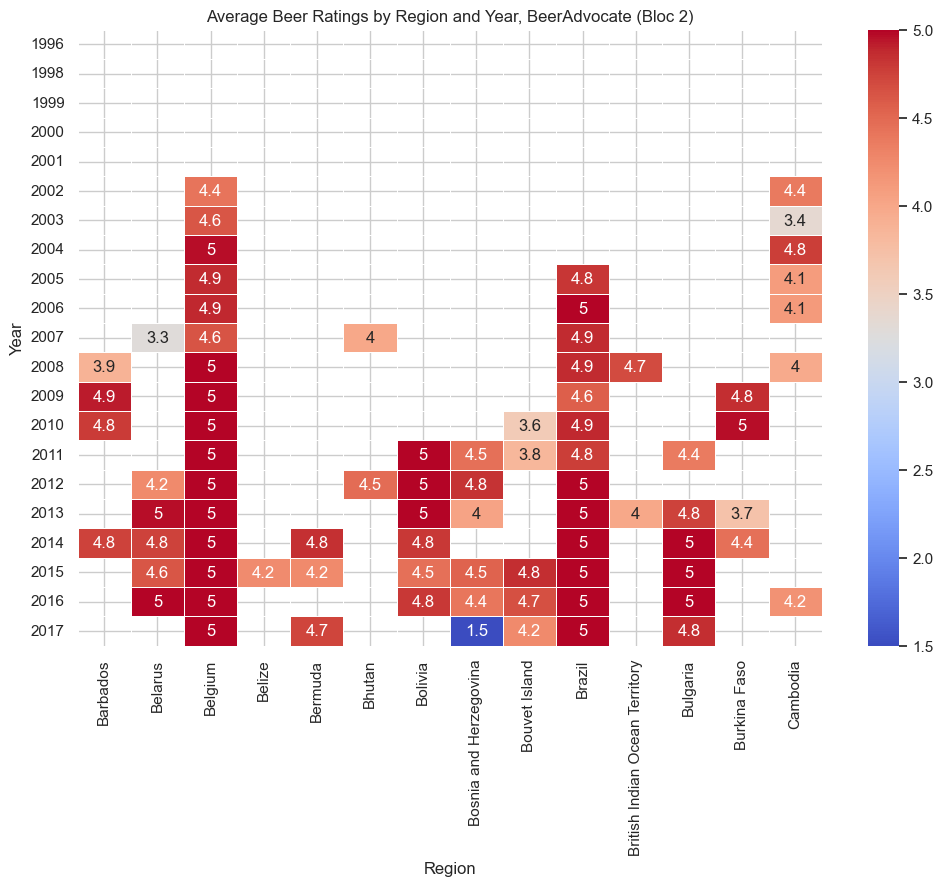

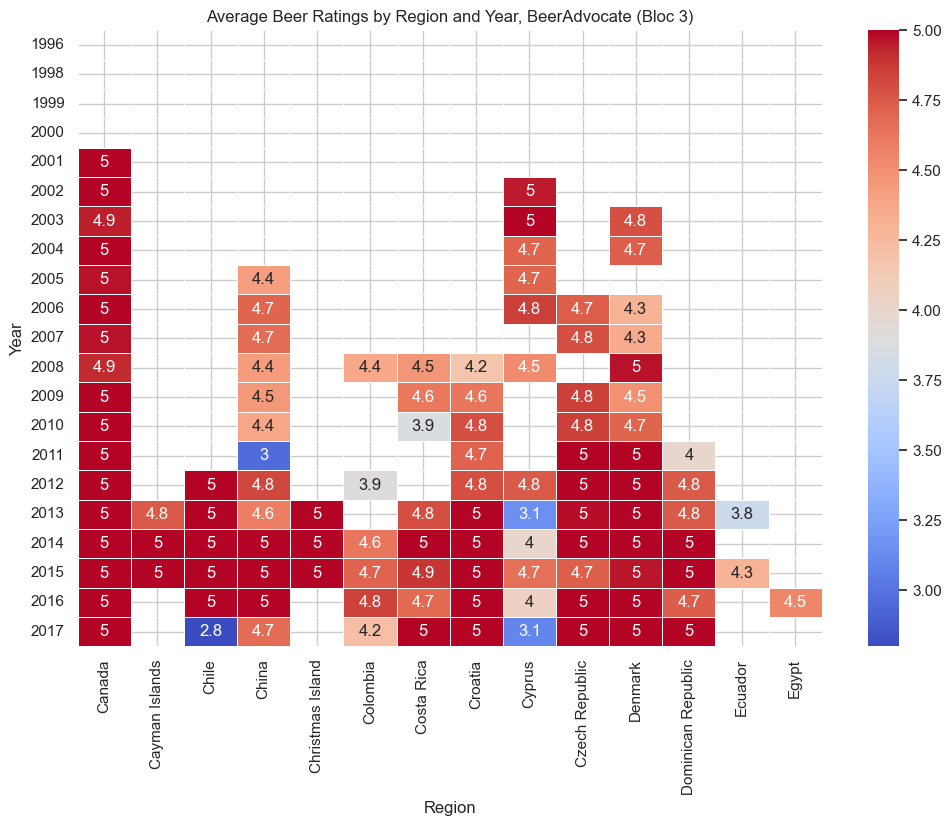

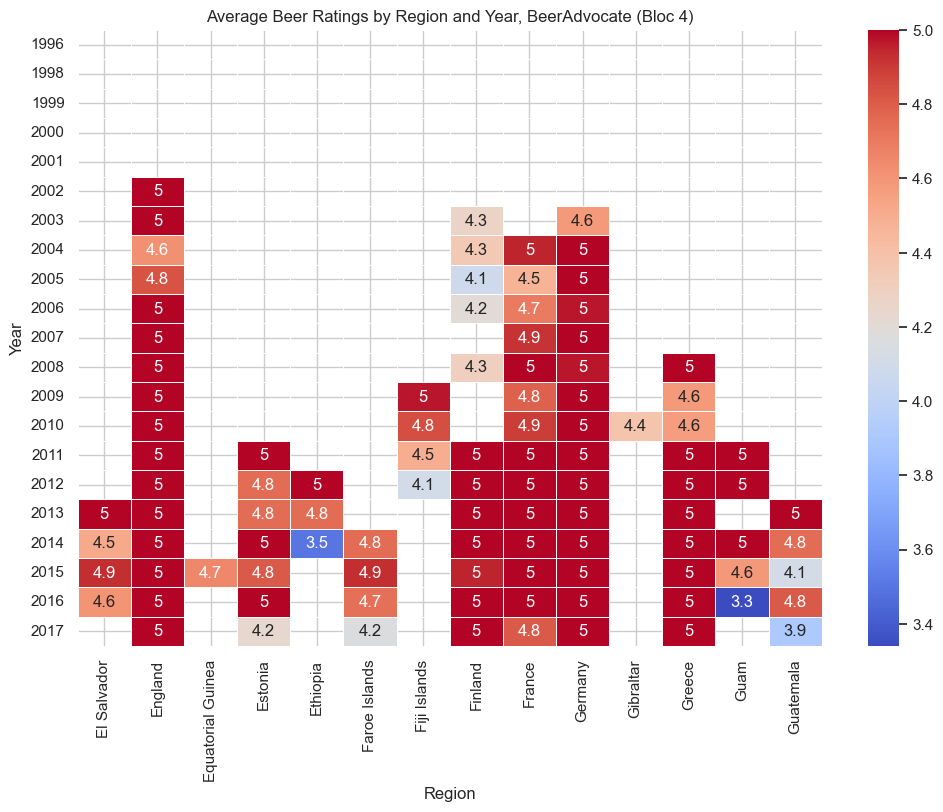

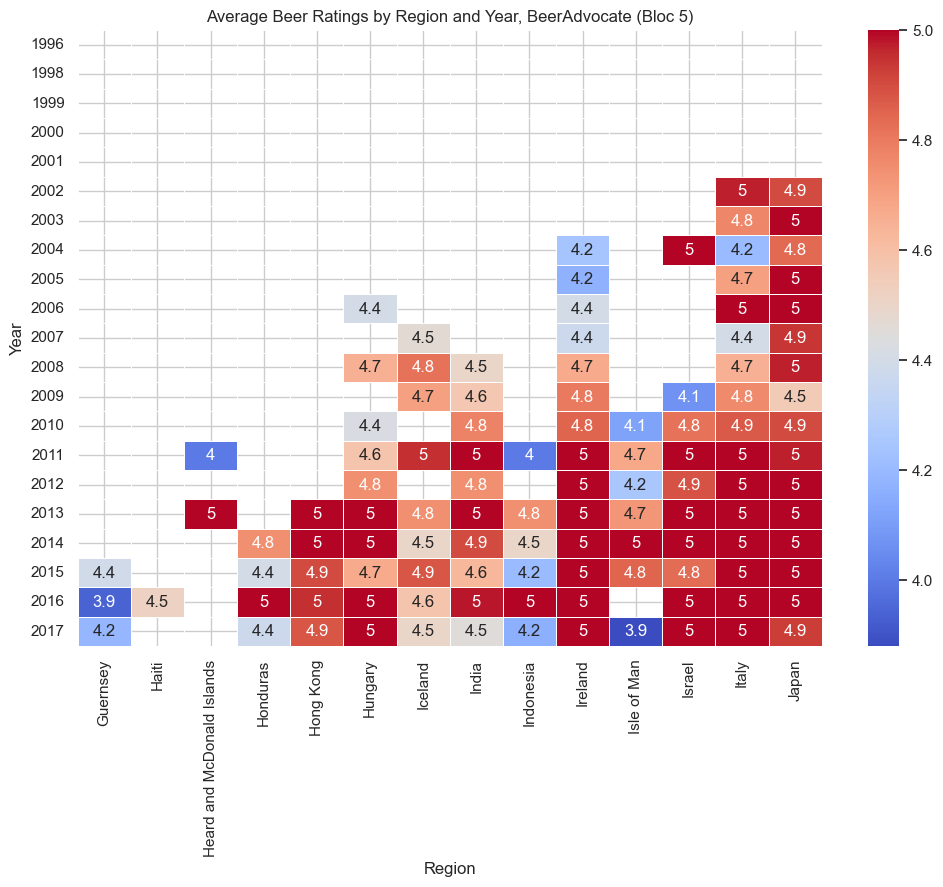

...

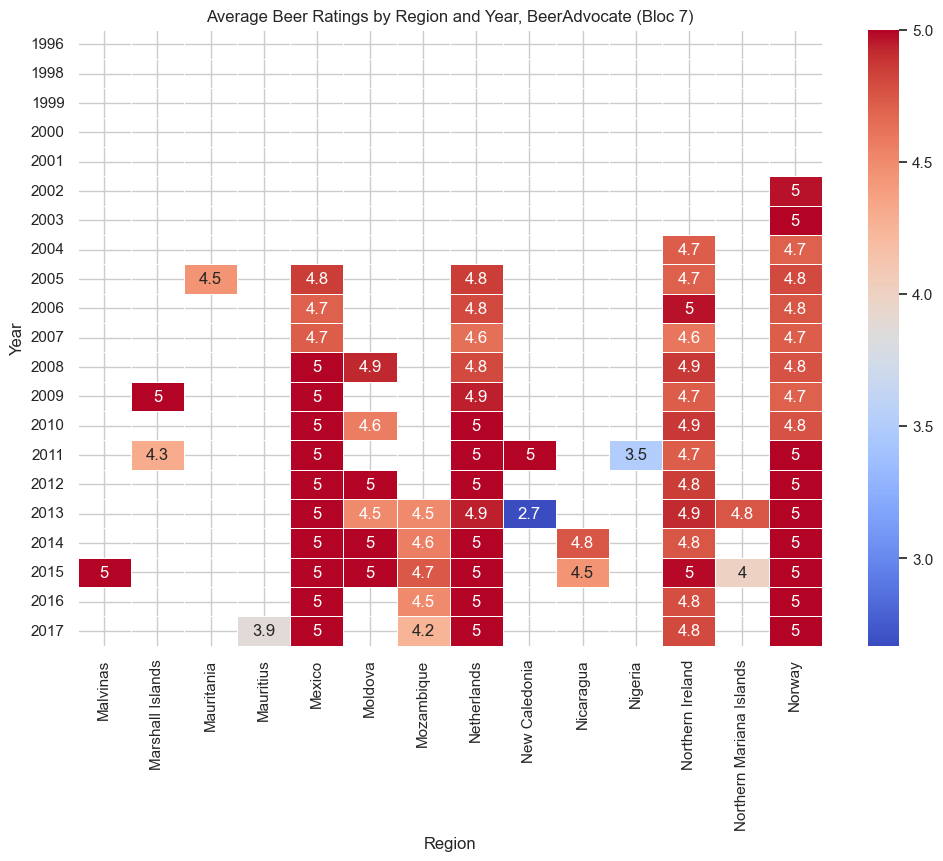

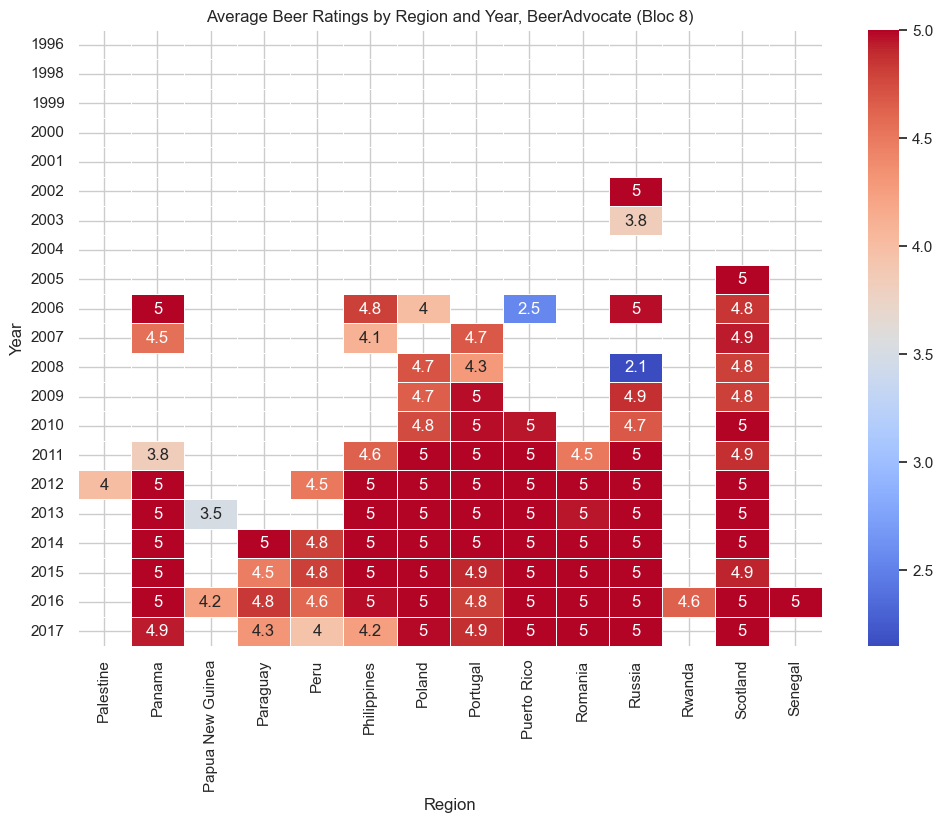

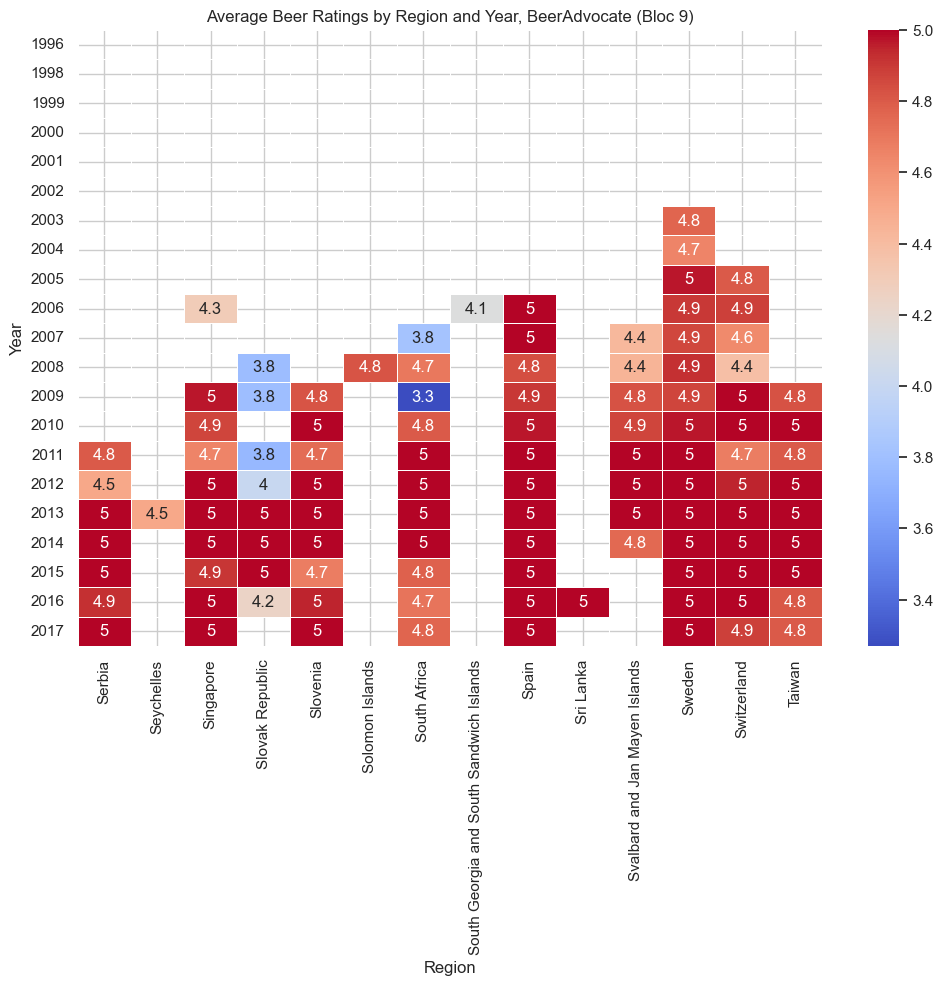

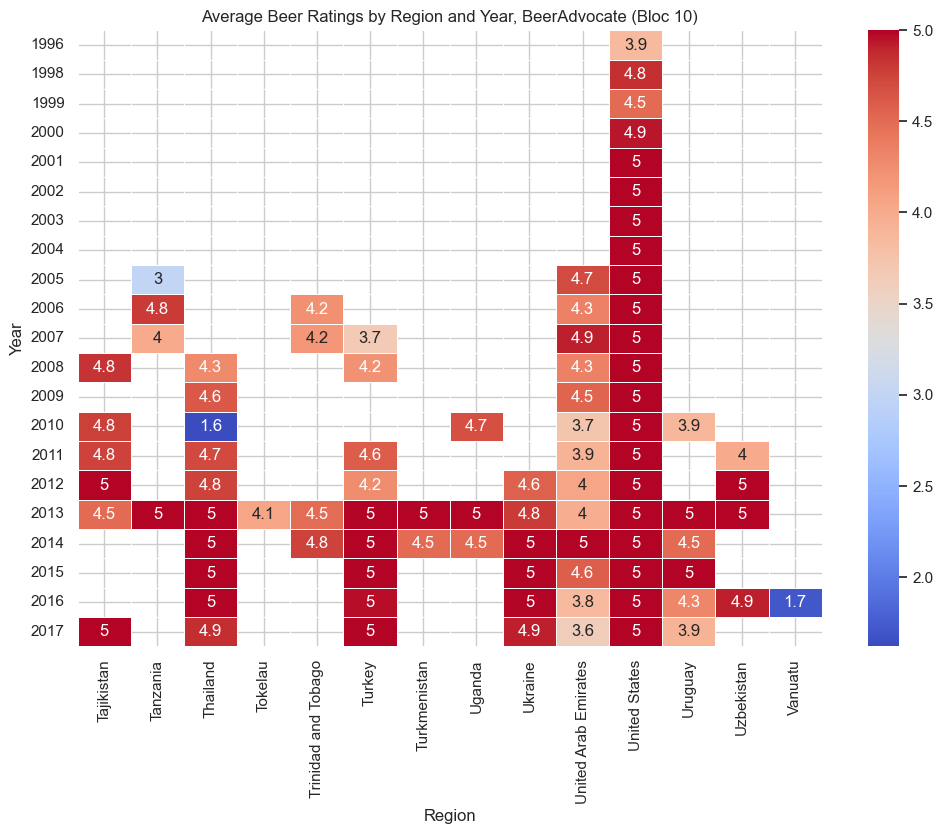

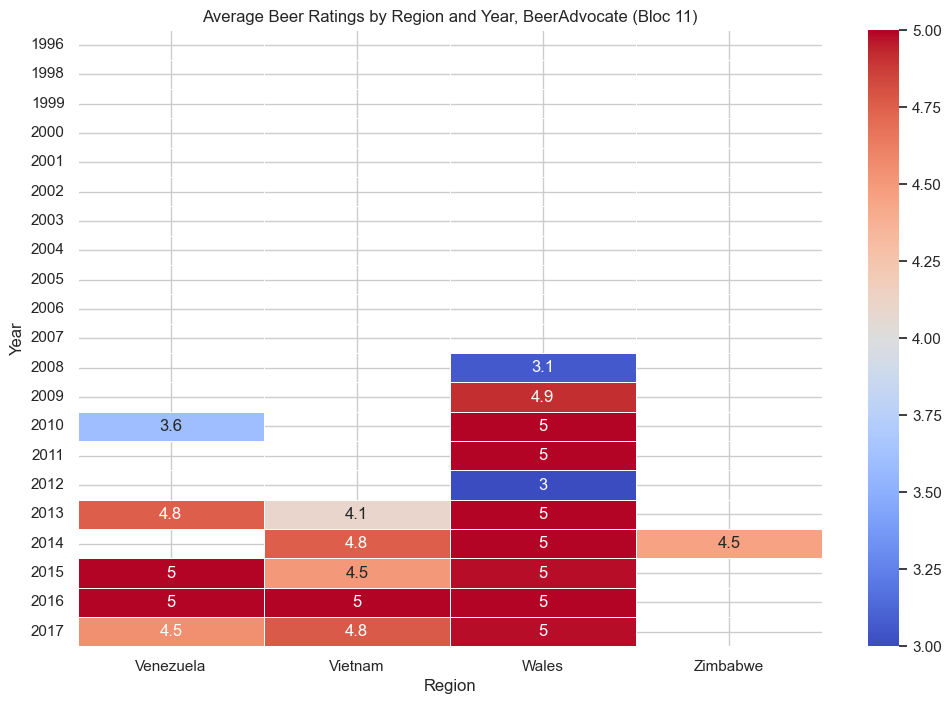

In [116]:

chunk_size = 14


num_chunks = len(pivot_data_ba.columns) // chunk_size + (1 if len(pivot_data_ba.columns) % chunk_size != 0 else 0)

for i in range(num_chunks):
    start = i * chunk_size
    end = start + chunk_size
    chunk = pivot_data_ba.iloc[:, start:end]  # Seleziona le colonne del blocco
    
    plt.figure(figsize=(12, 8))
    sns.heatmap(chunk, annot=True, cmap='coolwarm', linewidths=0.5)
    plt.title(f'Average Beer Ratings by Region and Year, BeerAdvocate (Bloc {i+1})')
    plt.xlabel('Region')
    plt.ylabel('Year')
    plt.show()


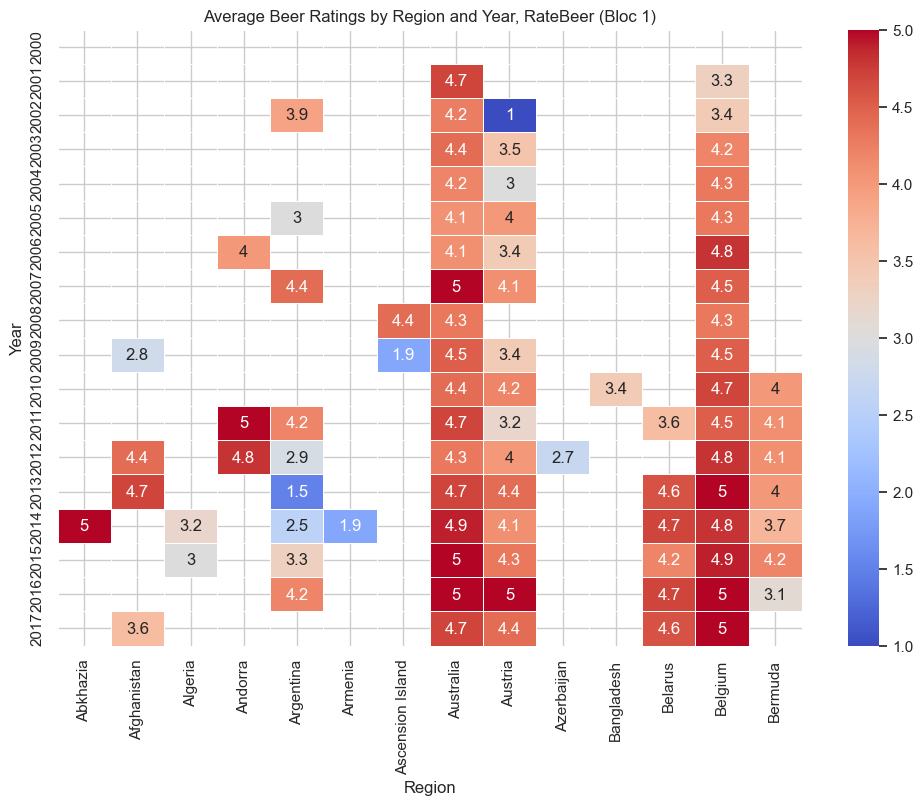

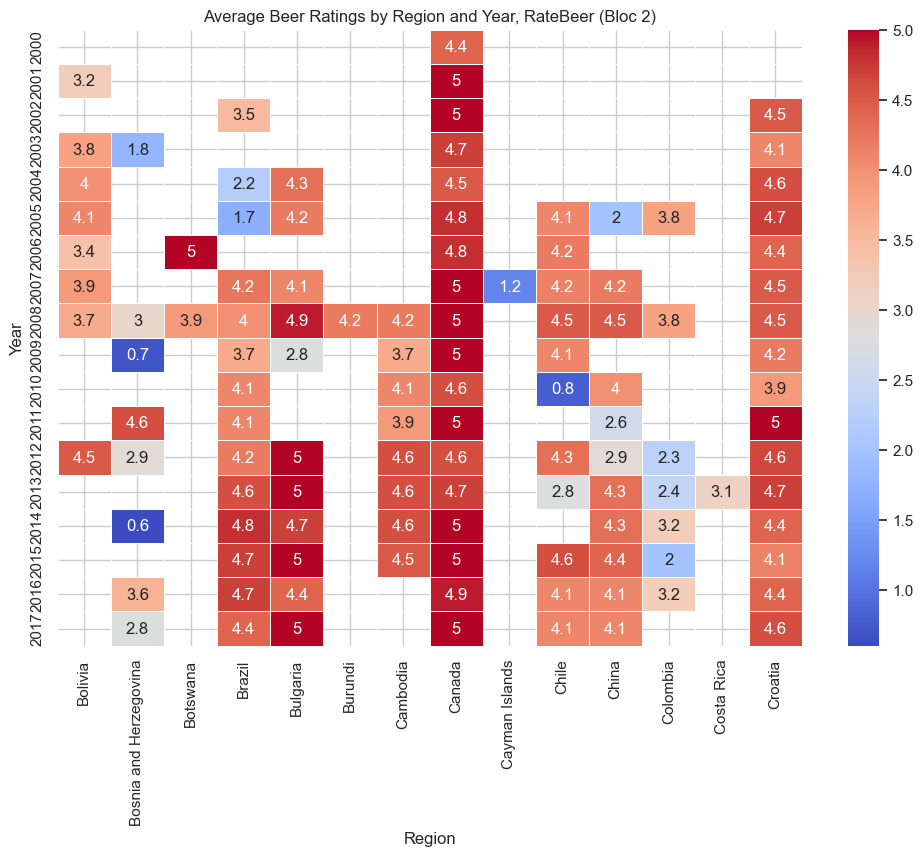

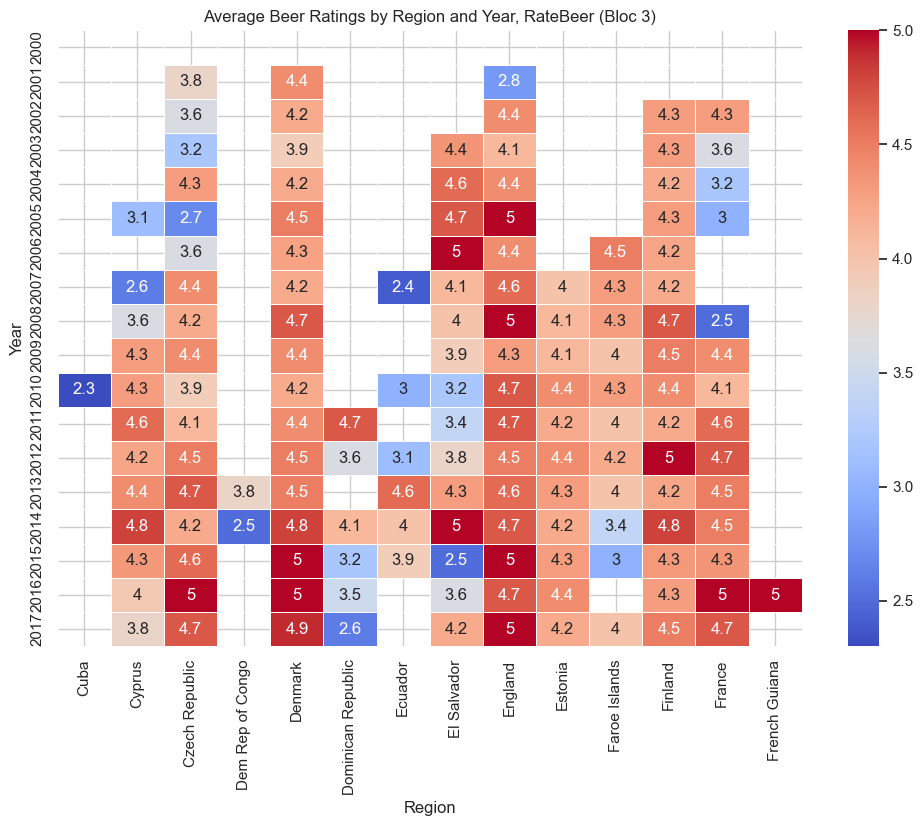

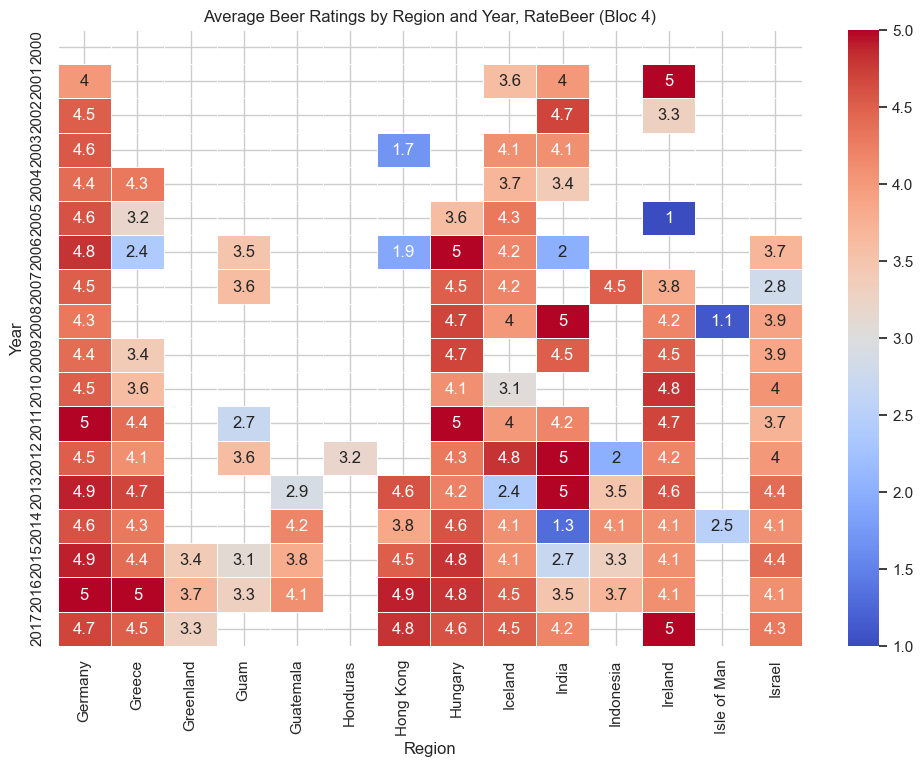

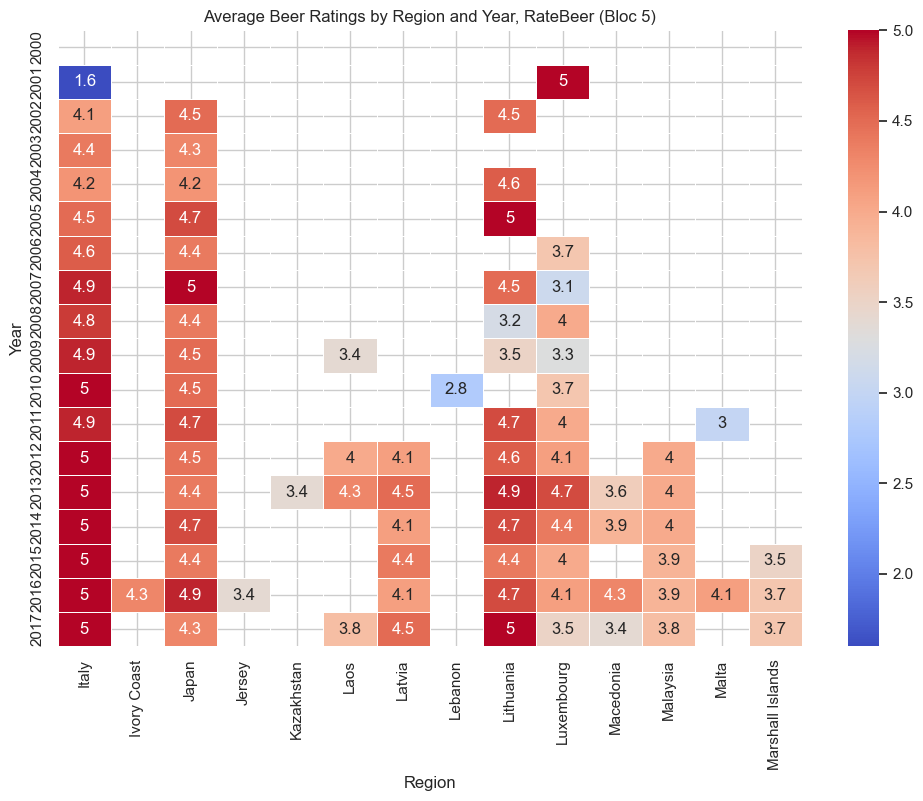

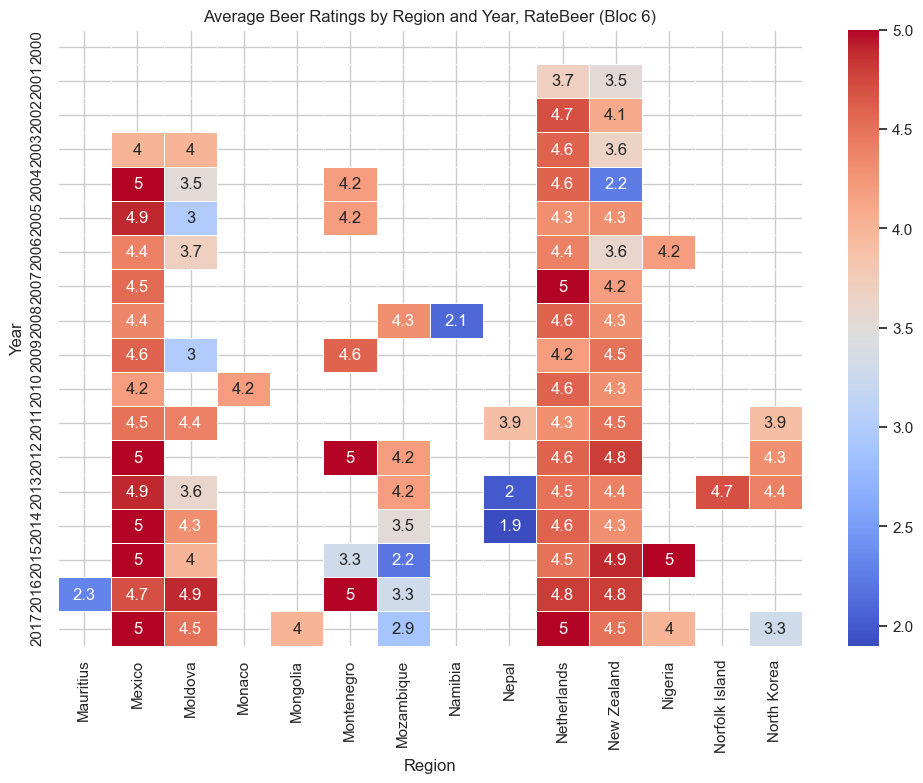

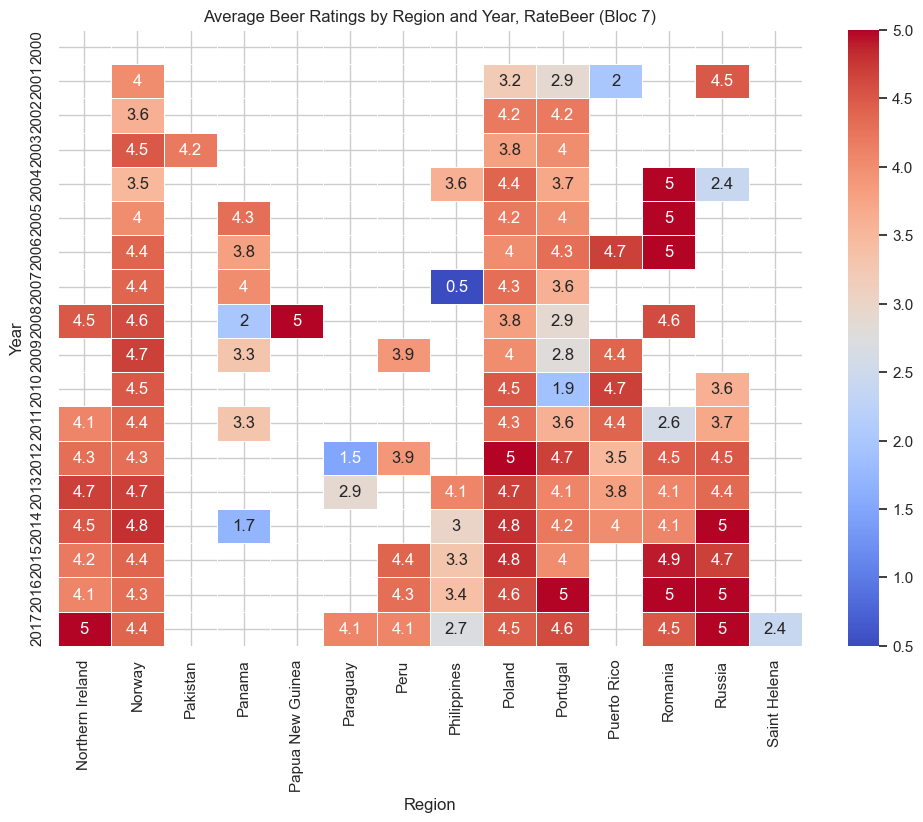

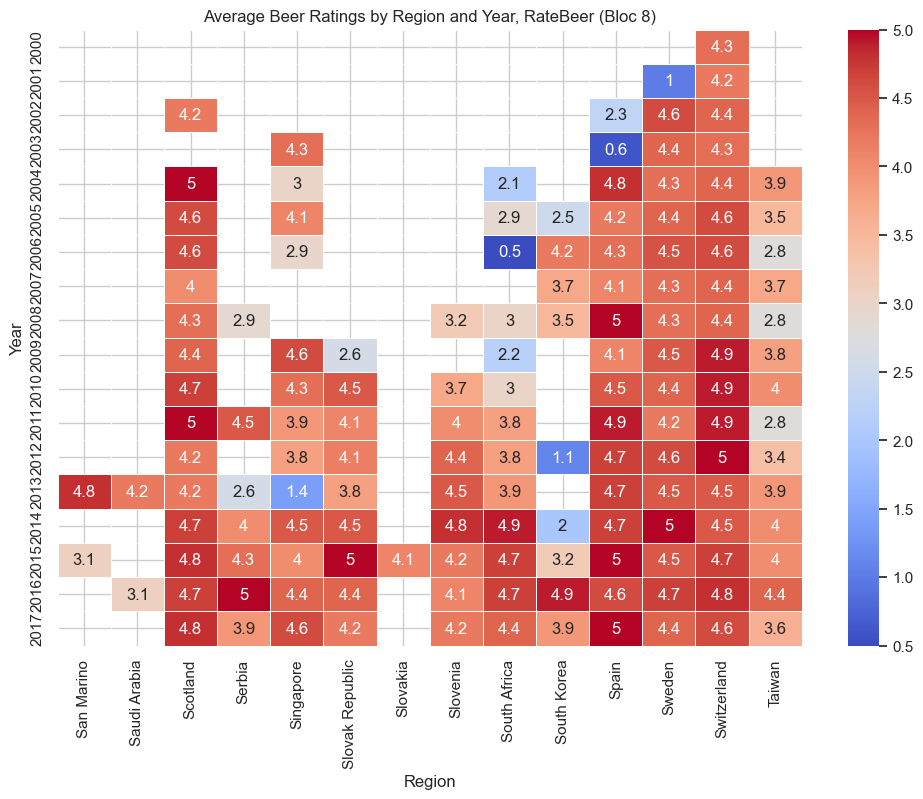

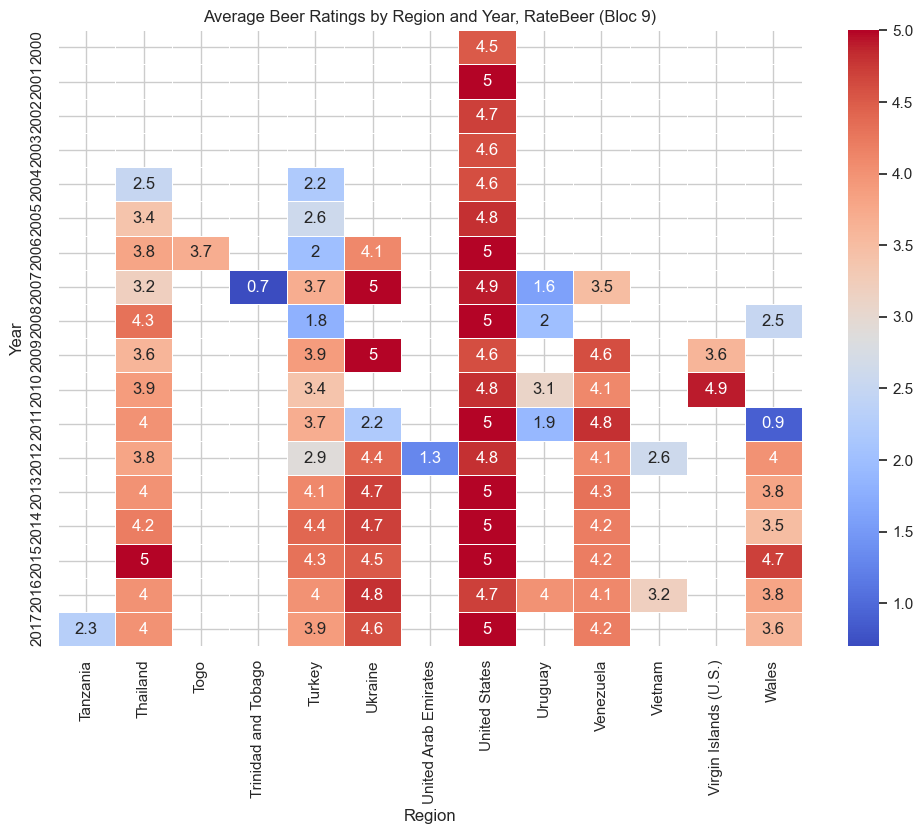

In [117]:

chunk_size = 14


num_chunks = len(pivot_data_rb.columns) // chunk_size + (1 if len(pivot_data_rb.columns) % chunk_size != 0 else 0)

for i in range(num_chunks):
    start = i * chunk_size
    end = start + chunk_size
    chunk = pivot_data_rb.iloc[:, start:end]  # Seleziona le colonne del blocco
    
    plt.figure(figsize=(12, 8))
    sns.heatmap(chunk, annot=True, cmap='coolwarm', linewidths=0.5)
    plt.title(f'Average Beer Ratings by Region and Year, RateBeer (Bloc {i+1})')
    plt.xlabel('Region')
    plt.ylabel('Year')
    plt.show()

The graph above represents the weighted average rating of the most popular beer for each country, broken down by year. As previously mentioned, the United States, having the highest number of users historically, more easily meets the minimum requirement of 5 reviews per beer compared to other countries

The graph also reveals how the weighted average ratings evolve over time, offering insights into whether preferered beers improve or decline  his rating in specific countries.

In [100]:

review_counts_us_ba= total_ba.groupby(['beer_id']).size().reset_index(name='review_count')


reviews_with_counts_us_ba = pd.merge(total_ba, review_counts_us_ba, on=['beer_id'])
filtered_reviews_us_ba = reviews_with_counts_us_ba[reviews_with_counts_us_ba['review_count'] >= 5]

weighted_avg_ratings_us_ba = filtered_reviews_us_ba.groupby(['beer_id', 'beer_name', 'year','review_count', 'location_region_user']).apply(
    lambda x: (x['rating'] * x['review_count']).sum() / x['review_count'].sum()
).reset_index(name='weighted_avg_rating')


weighted_avg_ratings_us_ba['rank'] = (
    weighted_avg_ratings_us_ba.sort_values(['year', 'location_region_user', 'weighted_avg_rating', 'review_count'], 
                                        ascending=[True, True, False, False])
    .groupby(['year', 'location_region_user'])
    .cumcount() + 1
)



NameError: name 'total_ba' is not defined

In [ ]:
review_counts_us_rb = total_rb.groupby(['beer_id']).size().reset_index(name='review_count')


reviews_with_counts_us_rb = pd.merge(total_rb, review_counts_us_rb, on=['beer_id'])
filtered_reviews_us_rb = reviews_with_counts_us_rb[reviews_with_counts_us_rb['review_count'] >= 5]

weighted_avg_ratings_us_rb = filtered_reviews_us_rb.groupby(['beer_id', 'beer_name', 'year','review_count', 'location_region_user']).apply(
    lambda x: (x['rating'] * x['review_count']).sum() / x['review_count'].sum()
).reset_index(name='weighted_avg_rating')


weighted_avg_ratings_us_rb['rank'] = (
    weighted_avg_ratings_us_rb.sort_values(['year', 'location_region_user', 'weighted_avg_rating', 'review_count'], 
                                        ascending=[True, True, False, False])
    .groupby(['year', 'location_region_user'])
    .cumcount() + 1
)


we are doing the same for the US States

In [ ]:
# Pivot data for heatmap
top_ranked_beers_us_ba = weighted_avg_ratings_us_ba[weighted_avg_ratings_us_ba['rank'] == 1]

pivot_data_us_ba= top_ranked_beers_us_ba.pivot_table(
    values='weighted_avg_rating', 
    index='year', 
    columns='location_region_user', 
    aggfunc='mean'
)




In [ ]:
# Pivot data for heatmap
top_ranked_beers_us_rb = weighted_avg_ratings_us_rb[weighted_avg_ratings_us_rb['rank'] == 1]
pivot_data_us_rb= top_ranked_beers_us_rb.pivot_table(
    values='weighted_avg_rating', 
    index='year', 
    columns='location_region_user', 
    aggfunc='mean'
)


In [ ]:

chunk_size = 14
num_chunks = len(pivot_data_us_ba.columns) // chunk_size + (1 if len(pivot_data_us_ba.columns) % chunk_size != 0 else 0)

for i in range(num_chunks):
    start = i * chunk_size
    end = start + chunk_size
    chunk = pivot_data_us_ba.iloc[:, start:end]  
    
    plt.figure(figsize=(12, 8))
    sns.heatmap(chunk, annot=True, cmap='coolwarm', linewidths=0.5)
    plt.title(f'Average Beer Ratings by Region and Year , BeerAdvocate(Bloc {i+1})')
    plt.xlabel('Region')
    plt.ylabel('Year')
    plt.show()

In [ ]:

chunk_size = 14
num_chunks = len(pivot_data_us_rb.columns) // chunk_size + (1 if len(pivot_data_us_rb.columns) % chunk_size != 0 else 0)

for i in range(num_chunks):
    start = i * chunk_size
    end = start + chunk_size
    chunk = pivot_data_us_rb.iloc[:, start:end]  
    
    plt.figure(figsize=(12, 8))
    sns.heatmap(chunk, annot=True, cmap='coolwarm', linewidths=0.5)
    plt.title(f'Average Beer Ratings by Region US and Year, RateBeer (Bloc {i+1})')
    plt.xlabel('Region')
    plt.ylabel('Year')
    plt.show()

In [ ]:
In the RateBeer are  represented less States.

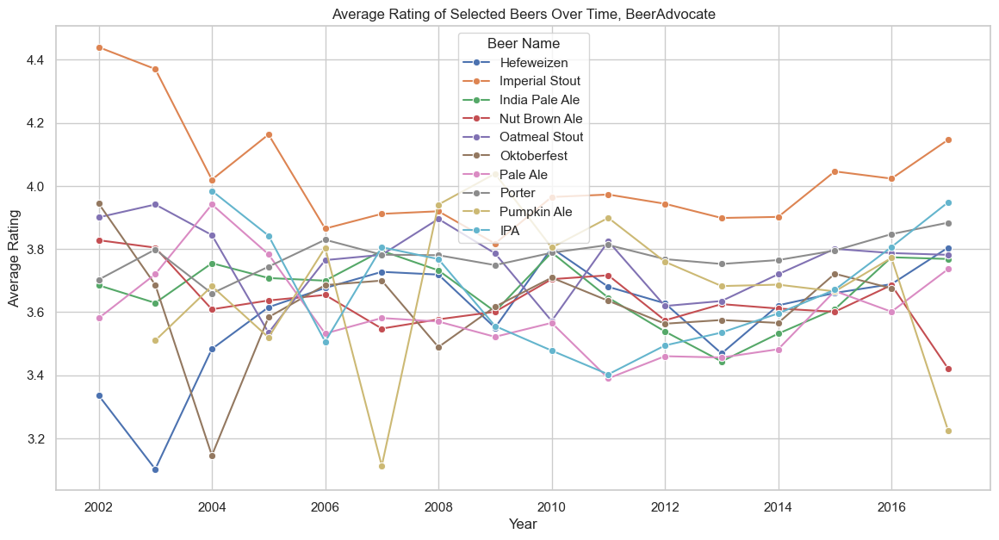

In [266]:

top_beers_ba = weighted_avg_ratings_ba['beer_name'].value_counts().nlargest(10).index
time_series_data_ba = weighted_avg_ratings_ba[weighted_avg_ratings_ba['beer_name'].isin(top_beers_ba)]

time_series_data_ba = time_series_data_ba.groupby(['year', 'beer_name']).agg({'weighted_avg_rating': 'mean'}).reset_index()

plt.figure(figsize=(14, 7))
sns.lineplot(data=time_series_data_ba, x='year', y='weighted_avg_rating', hue='beer_name', marker='o')
plt.title('Average Rating of Selected Beers Over Time, BeerAdvocate')
plt.xlabel('Year')
plt.ylabel('Average Rating')
plt.legend(title='Beer Name')
plt.show()


Imperial Stout seems to be the preferred one beetween the most frequent over the time in the world for BeerAdvocate

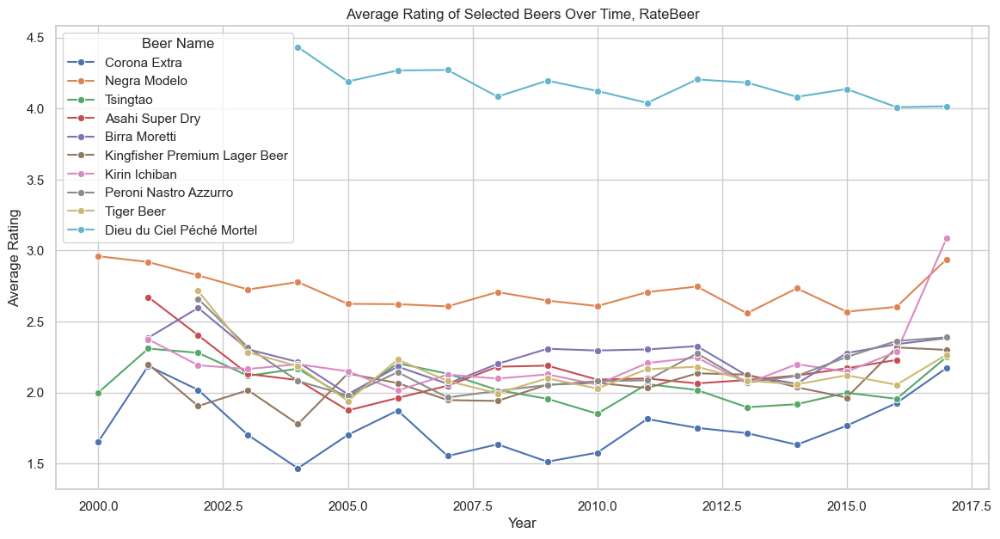

In [332]:
top_beers_rb = weighted_avg_ratings_rb['beer_name'].value_counts().nlargest(10).index
time_series_data_rb= weighted_avg_ratings_rb[weighted_avg_ratings_rb['beer_name'].isin(top_beers_rb)]

time_series_data_rb = time_series_data_rb.groupby(['year', 'beer_name']).agg({'weighted_avg_rating': 'mean'}).reset_index()

plt.figure(figsize=(14, 7))
sns.lineplot(data=time_series_data_rb, x='year', y='weighted_avg_rating', hue='beer_name', marker='o')
plt.title('Average Rating of Selected Beers Over Time, RateBeer')
plt.xlabel('Year')
plt.ylabel('Average Rating')
plt.legend(title='Beer Name')
plt.show()


Dieu du Ciel Péché Mortel seems to be the preferred one beetween the most frequent over the time in the world for RateBeer

The most frequent beer in the two dataset are all different, BeerAdvocate include a much larger number of reviews than the other, leading to a larger pool of reviewed beers. A more frequently reviewed beer in one dataset might not show up in the other if the total number of reviews is smaller.The demographics of the users differ between the two datasets. If one dataset has a larger user base in a specific location or country, it might feature beers that are more popular in that region.

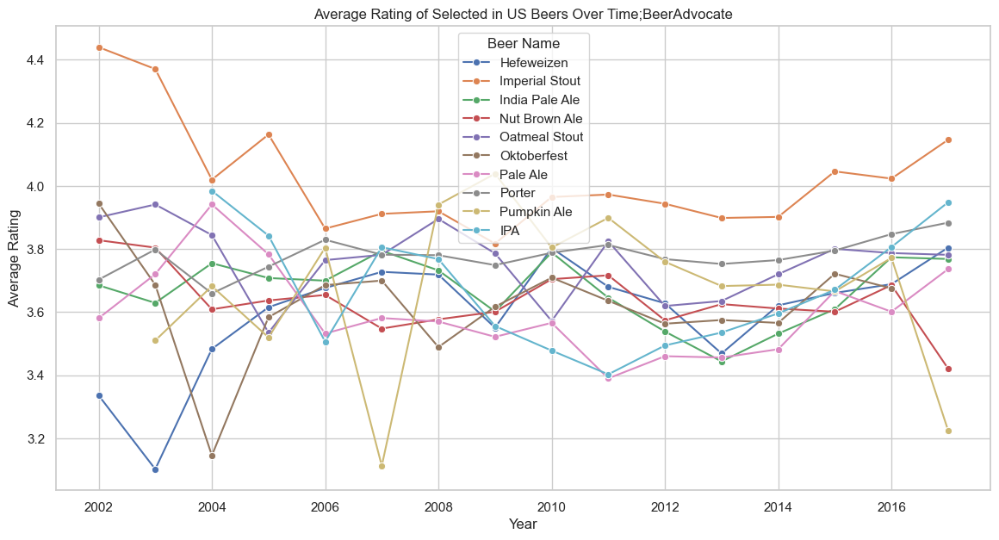

In [268]:

top_beers_ba= weighted_avg_ratings_ba[weighted_avg_ratings_ba['location_user']=='United States']['beer_name'].value_counts().nlargest(10).index
time_series_data_ba = weighted_avg_ratings_ba[weighted_avg_ratings_ba['beer_name'].isin(top_beers_ba)]

time_series_data_ba =time_series_data_ba.groupby(['year', 'beer_name']).agg({'weighted_avg_rating': 'mean'}).reset_index()

plt.figure(figsize=(14, 7))
sns.lineplot(data=time_series_data_ba, x='year', y='weighted_avg_rating', hue='beer_name', marker='o')
plt.title('Average Rating of Selected in US Beers Over Time;BeerAdvocate')
plt.xlabel('Year')
plt.ylabel('Average Rating')
plt.legend(title='Beer Name')
plt.show()


Imperial Stout seems to be the preferred one beetween the most frequent over the time in US for BeerAdvocate

Imperial Stout remain the favorite one in BeerAdvocate, this is because the US user are the majority

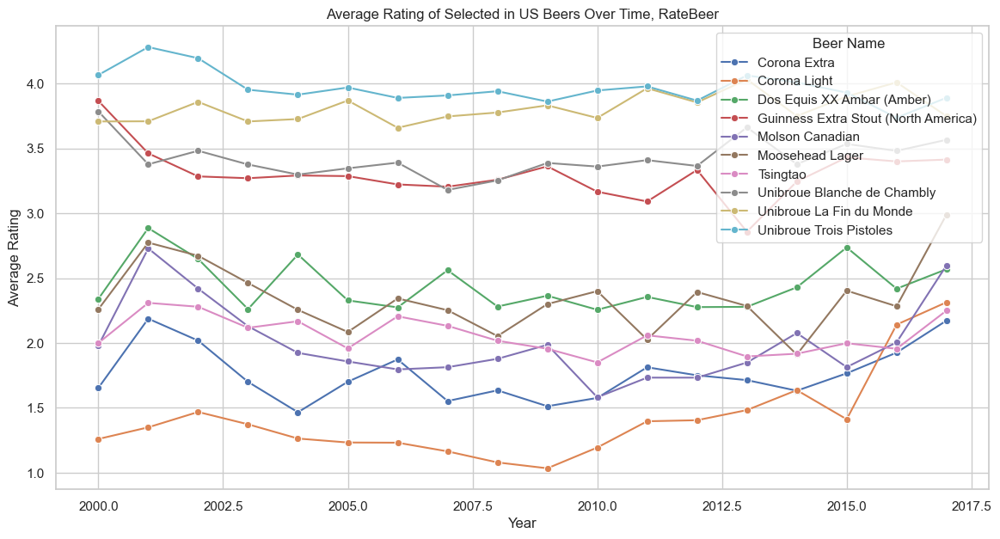

In [269]:
top_beers_rb = weighted_avg_ratings_rb[weighted_avg_ratings_rb['location_user']=='United States']['beer_name'].value_counts().nlargest(10).index
time_series_data_rb = weighted_avg_ratings_rb[weighted_avg_ratings_rb['beer_name'].isin(top_beers_rb)]

time_series_data_rb = time_series_data_rb.groupby(['year', 'beer_name']).agg({'weighted_avg_rating': 'mean'}).reset_index()

plt.figure(figsize=(14, 7))
sns.lineplot(data=time_series_data_rb, x='year', y='weighted_avg_rating', hue='beer_name', marker='o')
plt.title('Average Rating of Selected in US Beers Over Time, RateBeer')
plt.xlabel('Year')
plt.ylabel('Average Rating')
plt.legend(title='Beer Name')
plt.show()

Unibroue Trois Pistoles  seems to be the preferred one beetween the most frequent over the time in US for RateBeer

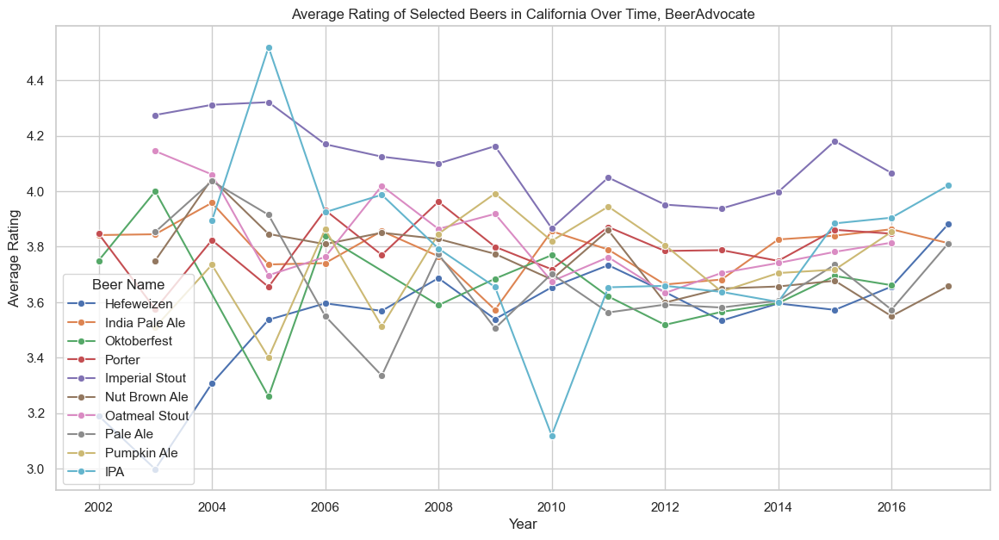

In [270]:

top_beers_cali_ba = weighted_avg_ratings_us_ba[weighted_avg_ratings_us_ba['location_region_user']=='California']['beer_name'].value_counts().nlargest(10).index
time_series_data_cali_ba = weighted_avg_ratings_us_ba[weighted_avg_ratings_us_ba['beer_name'].isin(top_beers_ba)]

time_series_data_cali_ba = time_series_data_cali_ba.groupby(['year', 'beer_name']).agg({'weighted_avg_rating': 'mean'}).reset_index()

plt.figure(figsize=(14, 7))
sns.lineplot(data=time_series_data_cali_ba, x='year', y='weighted_avg_rating', hue='beer_name', marker='o')
plt.title('Average Rating of Selected Beers in California Over Time, BeerAdvocate')
plt.xlabel('Year')
plt.ylabel('Average Rating')
plt.legend(title='Beer Name')
plt.show()



Imperial Stout seems to be the preferred one beetween the most frequent over the time in California for BeerAdvocate

It makes sense, since is the favorite in the US and also in the world. the consistency in the most nominated beers across the BeerAdvocate graphs suggests a strong influence from regions like the US and particularly beer-drinking hubs such as California

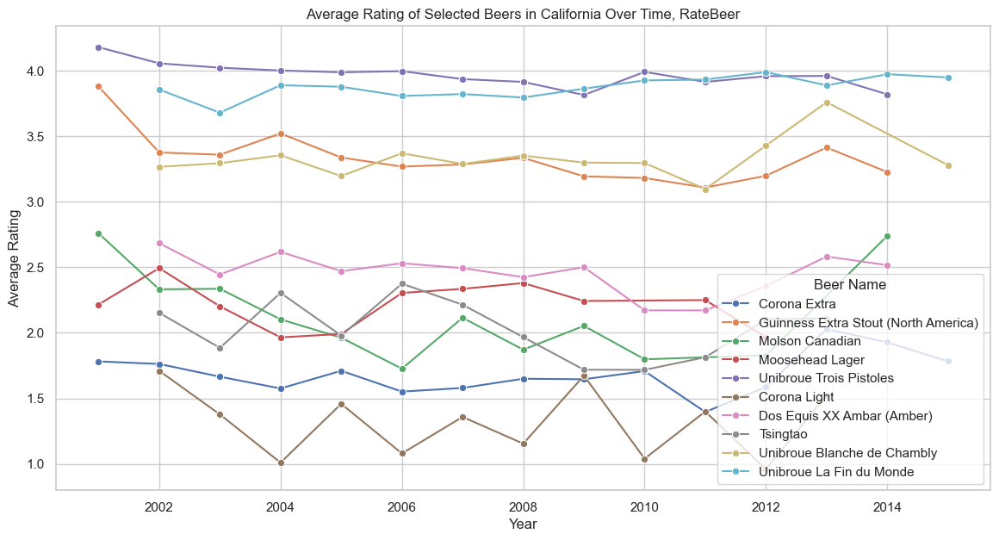

In [271]:

top_beers_cali_rb = weighted_avg_ratings_us_rb[weighted_avg_ratings_us_rb['location_region_user']=='California']['beer_name'].value_counts().nlargest(10).index
time_series_data_cali_rb = weighted_avg_ratings_us_rb[weighted_avg_ratings_us_rb['beer_name'].isin(top_beers_rb)]

time_series_data_cali_rb= time_series_data_cali_rb.groupby(['year', 'beer_name']).agg({'weighted_avg_rating': 'mean'}).reset_index()

plt.figure(figsize=(14, 7))
sns.lineplot(data=time_series_data_cali_rb, x='year', y='weighted_avg_rating', hue='beer_name', marker='o')
plt.title('Average Rating of Selected Beers in California Over Time, RateBeer')
plt.xlabel('Year')
plt.ylabel('Average Rating')
plt.legend(title='Beer Name')
plt.show()

Corona Extra and Unibroue Trois Pistoles  seems to be the preferred one beetween the most frequent over the time in California for RateBeer. This datas work well with the one from the Us plot, the name precence is cosisted

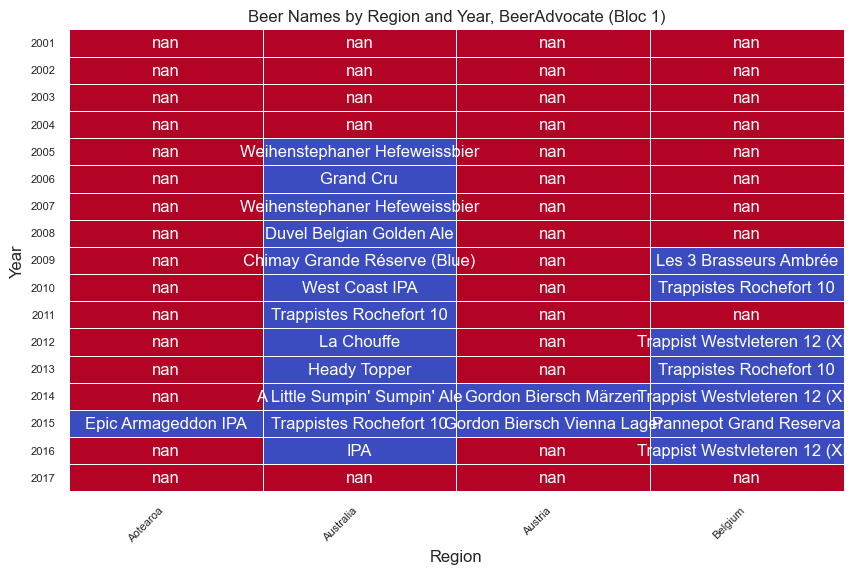

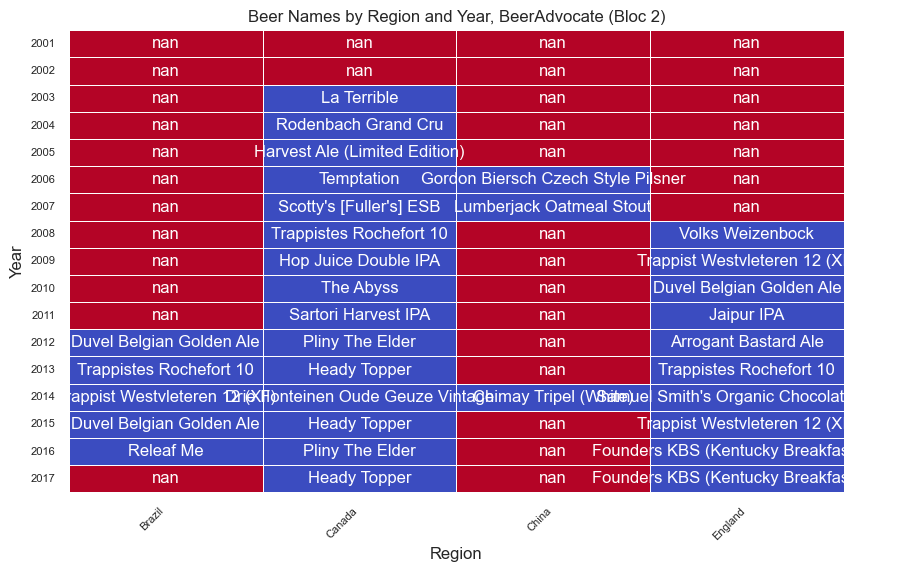

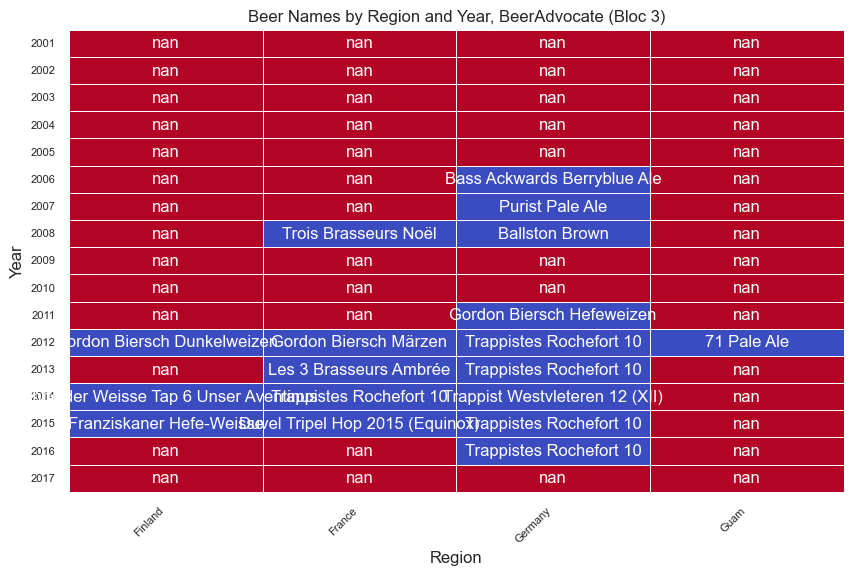

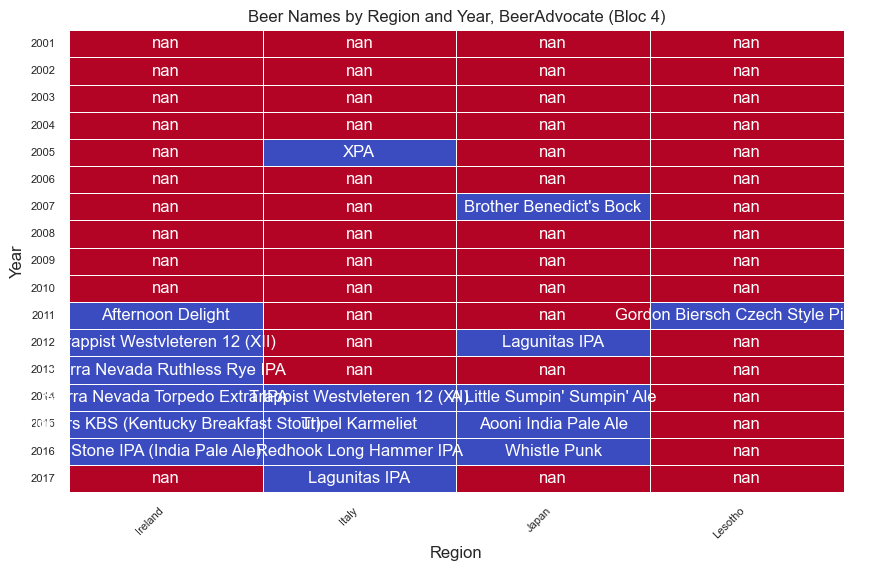

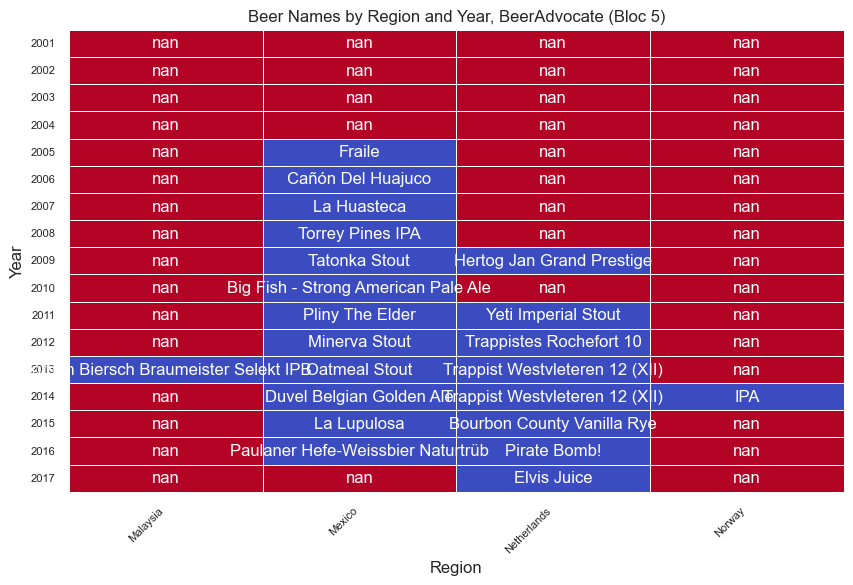

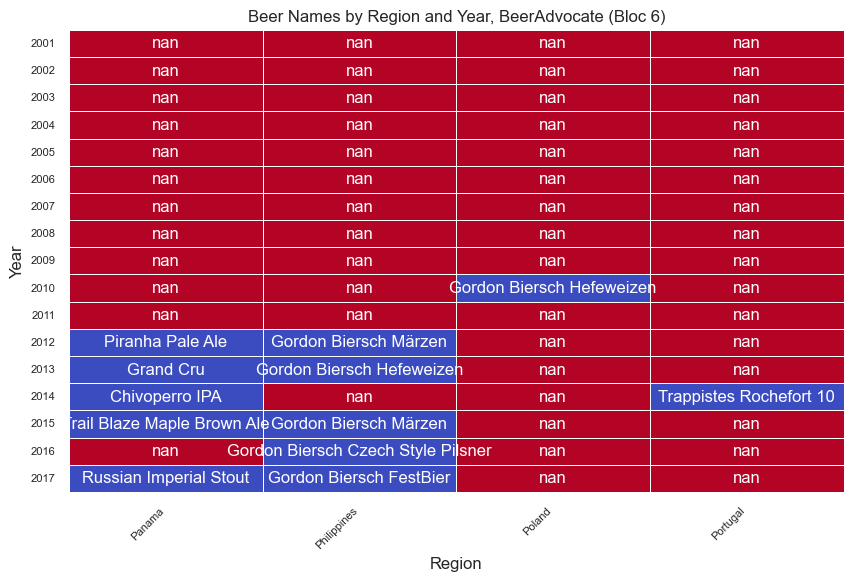

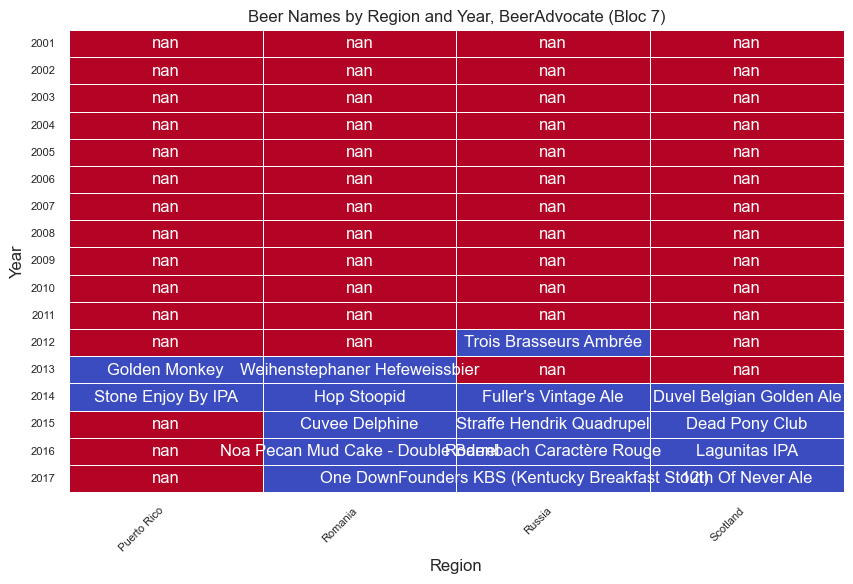

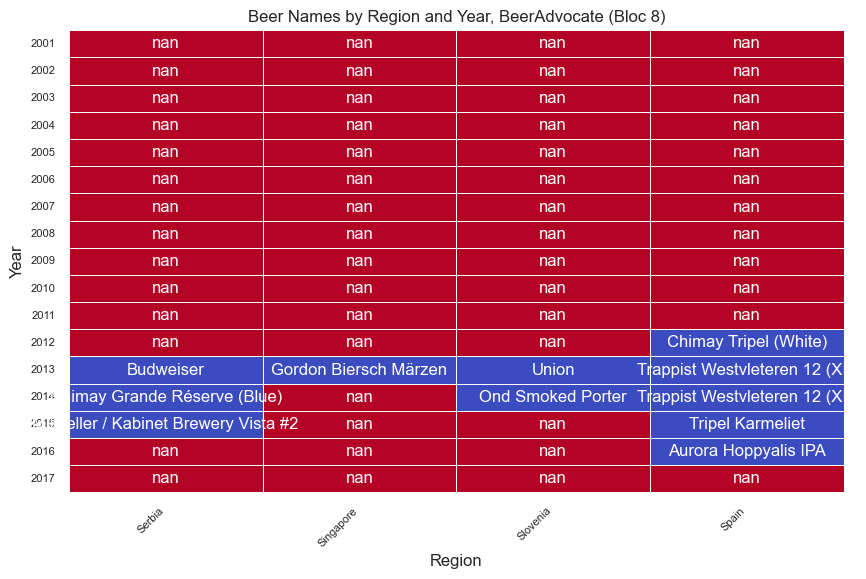

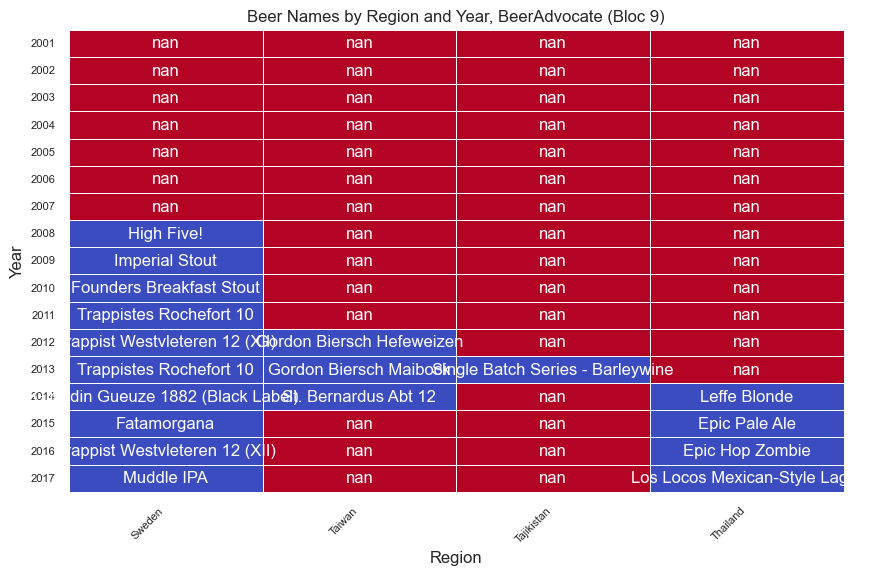

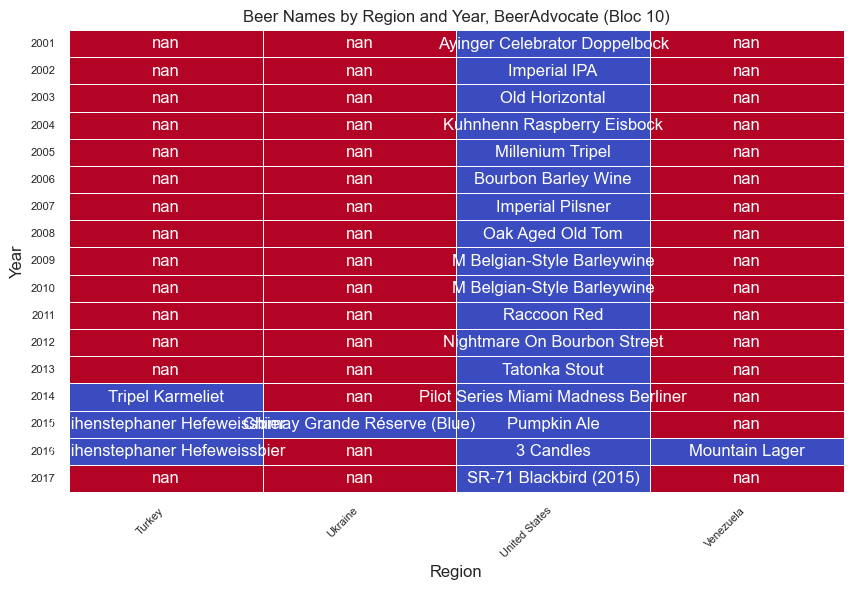

In [272]:

pivot_data_name_ba = top_ranked_beers_ba.pivot_table(
    values='beer_name', 
    index='year', 
    columns='location_user', 
    aggfunc=lambda x: ', '.join(x.dropna())
)


chunk_size = 4  
num_chunks = (pivot_data_name_ba.shape[1] + chunk_size - 1) // chunk_size

for i in range(num_chunks):
    start = i * chunk_size
    end = start + chunk_size
    chunk = pivot_data_name_ba.iloc[:, start:end]  
    
   
    plt.figure(figsize=(10, 6))  
    sns.heatmap(
        chunk.isna().astype(int),  
        annot=chunk, fmt='', cmap='coolwarm', linewidths=0.5, cbar=False
    )
    plt.title(f'Beer Names by Region and Year, BeerAdvocate (Bloc {i+1})')
    plt.xlabel('Region')
    plt.ylabel('Year')
    plt.xticks(rotation=45, ha='right', fontsize=8)
    plt.yticks(fontsize=8)
    plt.show()



This are the Name of the best beer for year for each country, they name change everywhere over the years,byt there are few countries like Philippines that seem to love Gordon beer

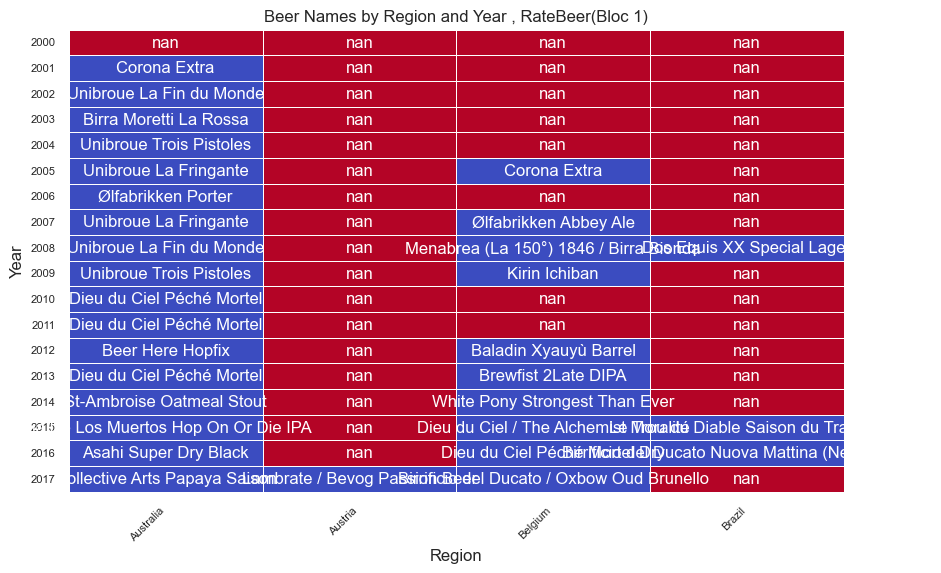

/opt/anaconda3/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 158 (\x9e) missing from font(s) Arial.
  fig.canvas.print_figure(bytes_io, **kw)
/opt/anaconda3/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 146 (\x92) missing from font(s) Arial.
  fig.canvas.print_figure(bytes_io, **kw)
/opt/anaconda3/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 154 (\x9a) missing from font(s) Arial.
  fig.canvas.print_figure(bytes_io, **kw)


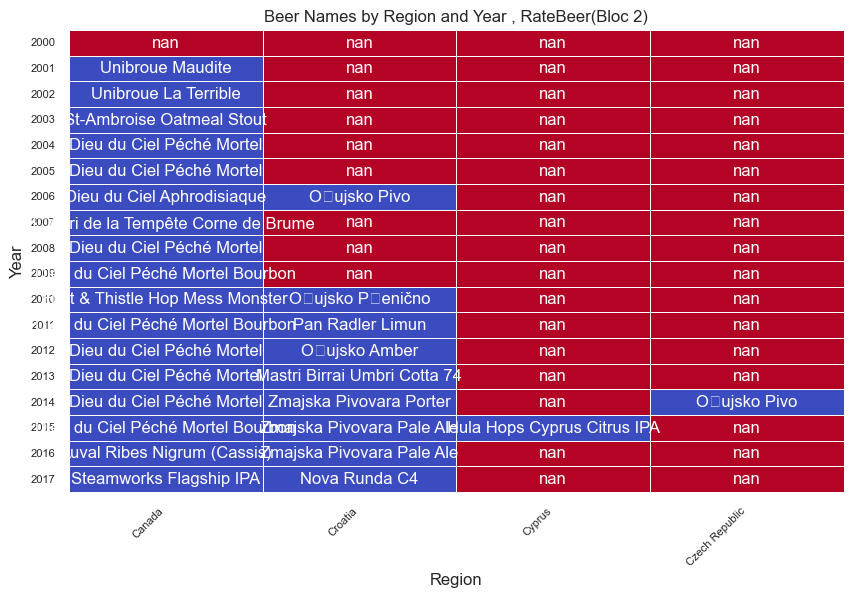

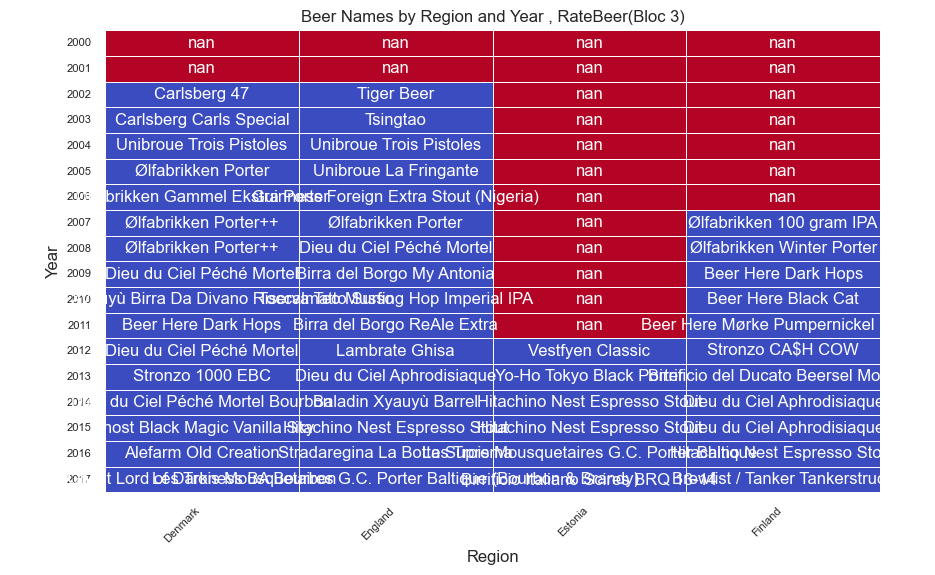

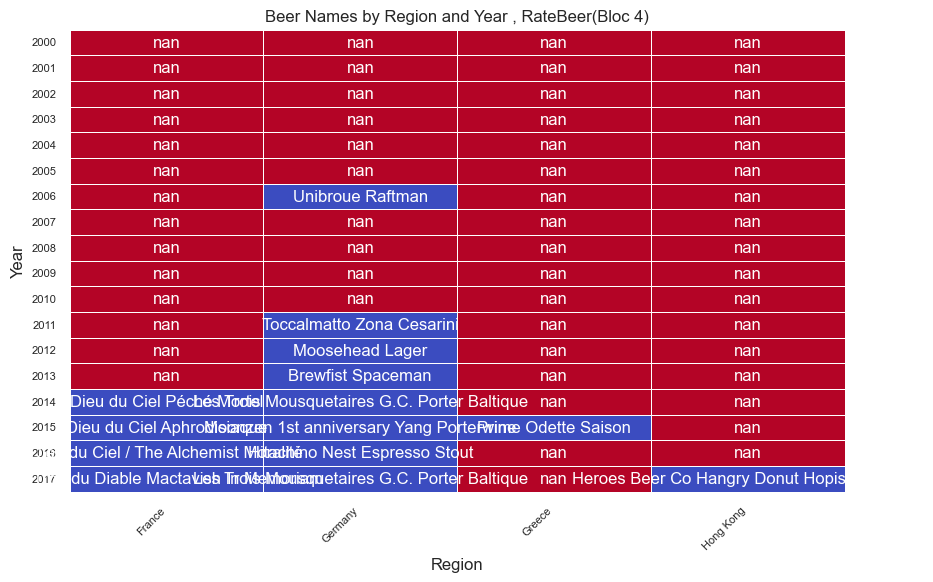

/opt/anaconda3/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 146 (\x92) missing from font(s) Arial.
  fig.canvas.print_figure(bytes_io, **kw)


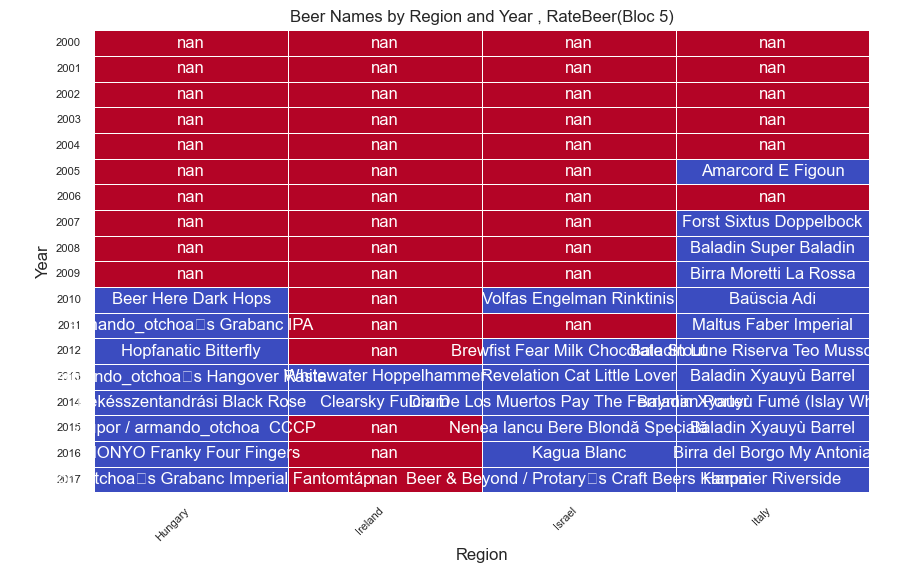

/opt/anaconda3/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 146 (\x92) missing from font(s) Arial.
  fig.canvas.print_figure(bytes_io, **kw)


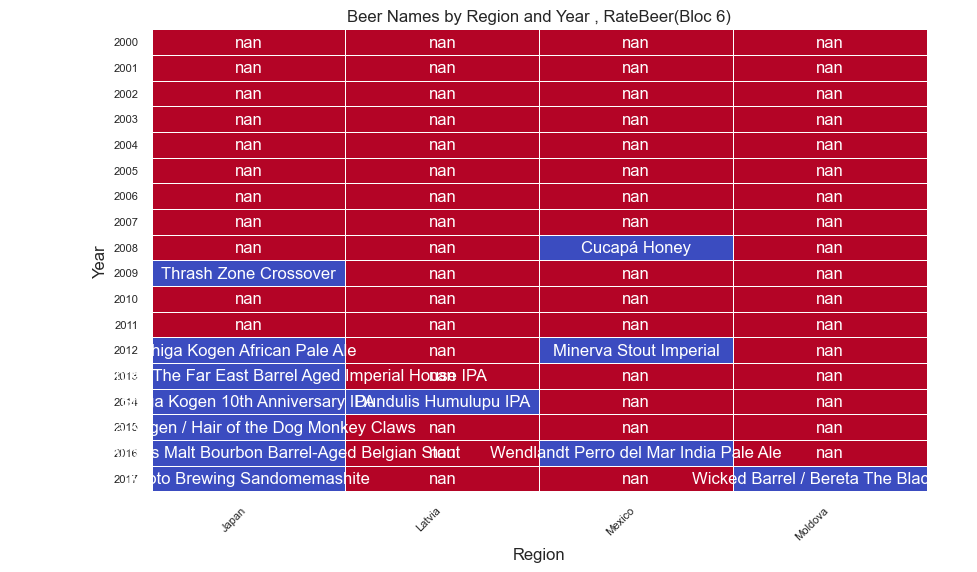

/opt/anaconda3/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 146 (\x92) missing from font(s) Arial.
  fig.canvas.print_figure(bytes_io, **kw)


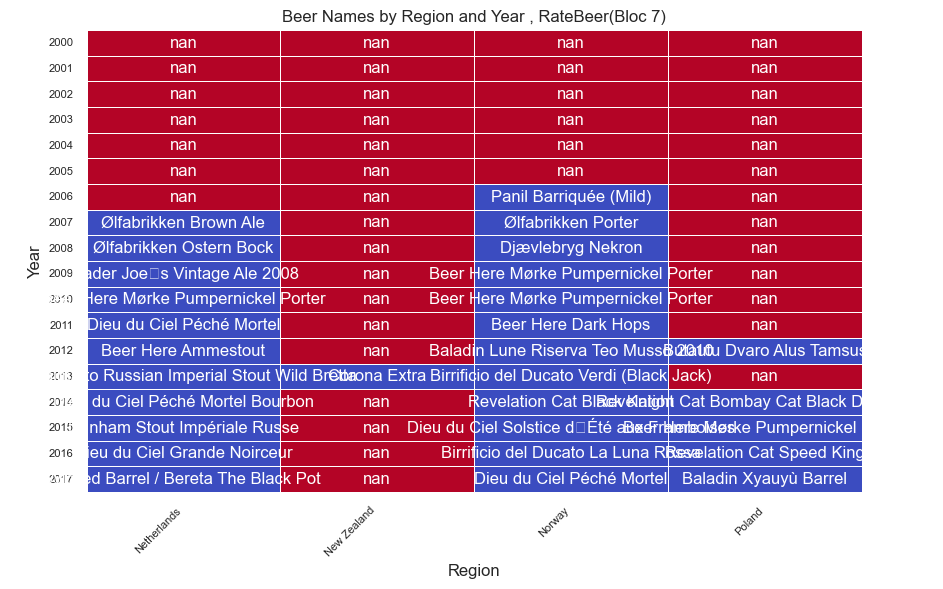

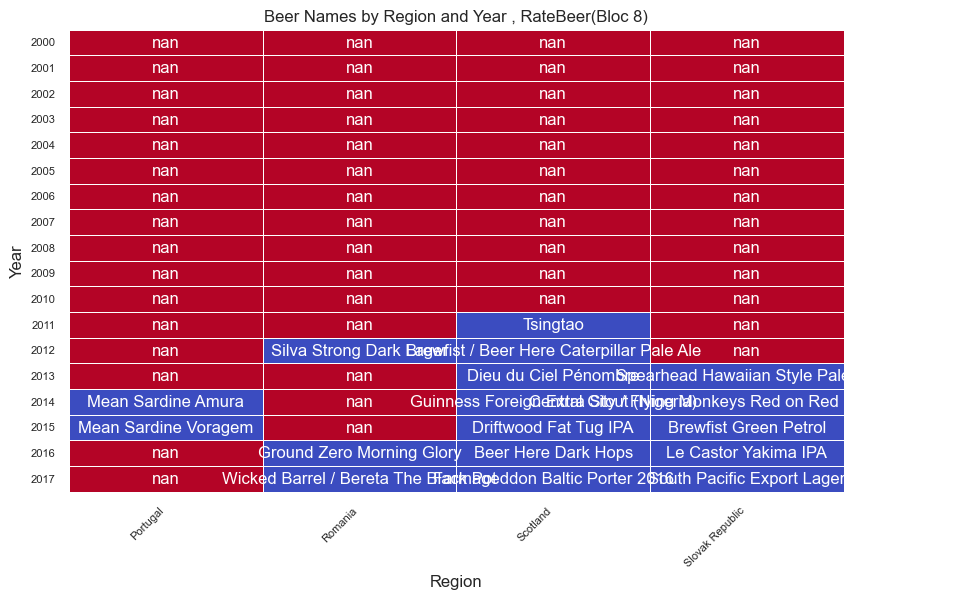

/opt/anaconda3/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 146 (\x92) missing from font(s) Arial.
  fig.canvas.print_figure(bytes_io, **kw)


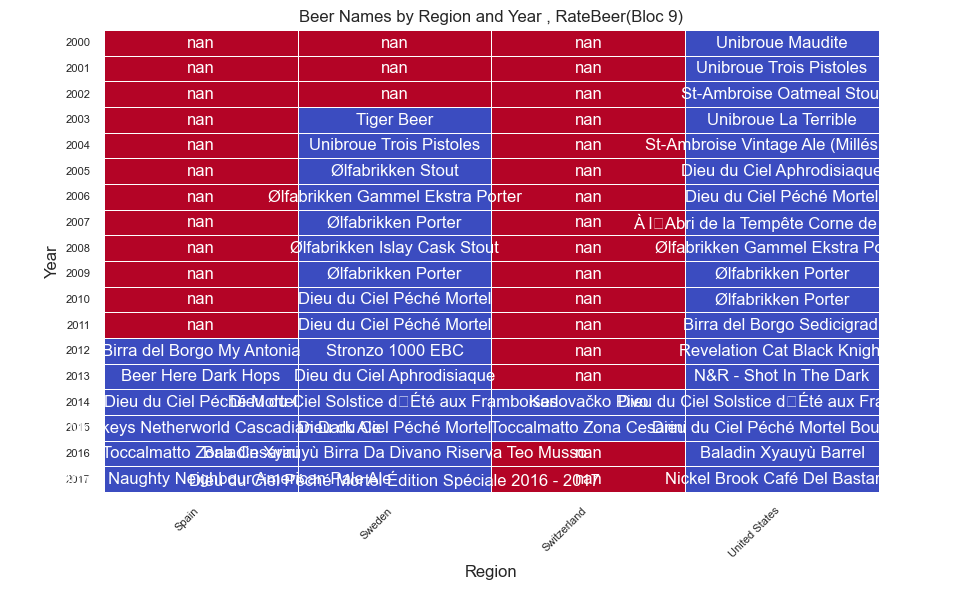

In [273]:
pivot_data_name_rb = top_ranked_beers_rb.pivot_table(
    values='beer_name', 
    index='year', 
    columns='location_user', 
    aggfunc=lambda x: ', '.join(x.dropna())
)


chunk_size = 4  
num_chunks = (pivot_data_name_rb.shape[1] + chunk_size - 1) // chunk_size

for i in range(num_chunks):
    start = i * chunk_size
    end = start + chunk_size
    chunk = pivot_data_name_rb.iloc[:, start:end]  
    
   
    plt.figure(figsize=(10, 6))  
    sns.heatmap(
        chunk.isna().astype(int),  
        annot=chunk, fmt='', cmap='coolwarm', linewidths=0.5, cbar=False
    )
    plt.title(f'Beer Names by Region and Year , RateBeer(Bloc {i+1})')
    plt.xlabel('Region')
    plt.ylabel('Year')
    plt.xticks(rotation=45, ha='right', fontsize=8)
    plt.yticks(fontsize=8)
    plt.show()

Same as for BeerAdvocate they name change everywhere over the years,byt there are few countries like Canada that seem to love Dieu du Ciel péché Mortel. 

In [274]:

review_counts_br_ba = total_ba.groupby(['beer_id']).size().reset_index(name='review_count')


reviews_with_counts_br_ba = pd.merge(total_ba, review_counts_br_ba, on=['beer_id'])
filtered_reviews_br_ba = reviews_with_counts_br_ba[reviews_with_counts_br_ba['review_count'] >= 5]

weighted_avg_ratings_br_ba = filtered_reviews_br_ba.groupby(['brewery_id','brewery_name', 'year','review_count', 'location_user']).apply(
    lambda x: (x['rating'] * x['review_count']).sum() / x['review_count'].sum()
).reset_index(name='weighted_avg_rating')


weighted_avg_ratings_br_ba['rank'] = (
    weighted_avg_ratings_br_ba.sort_values(['year', 'location_user', 'weighted_avg_rating', 'review_count'], 
                                        ascending=[True, True, False, False])
    .groupby(['year', 'location_user'])
    .cumcount() + 1
)

# Check results


/var/folders/np/3hhzvb2x6znbzvj6ph2phb8h0000gn/T/ipykernel_51833/12051656.py:7: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  weighted_avg_ratings_br_ba = filtered_reviews_br_ba.groupby(['brewery_id','brewery_name', 'year','review_count', 'location_user']).apply(


In [275]:
review_counts_br_rb = total_rb.groupby(['beer_id']).size().reset_index(name='review_count')


reviews_with_counts_br_rb = pd.merge(total_rb, review_counts_br_rb, on=['beer_id'])
filtered_reviews_br_rb = reviews_with_counts_br_rb[reviews_with_counts_br_rb['review_count'] >= 5]

weighted_avg_ratings_br_rb = filtered_reviews_br_rb.groupby(['brewery_id','brewery_name', 'year','review_count', 'location_user']).apply(
    lambda x: (x['rating'] * x['review_count']).sum() / x['review_count'].sum()
).reset_index(name='weighted_avg_rating')


weighted_avg_ratings_br_rb['rank'] = (
    weighted_avg_ratings_br_rb.sort_values(['year', 'location_user', 'weighted_avg_rating', 'review_count'], 
                                        ascending=[True, True, False, False])
    .groupby(['year', 'location_user'])
    .cumcount() + 1
)


/var/folders/np/3hhzvb2x6znbzvj6ph2phb8h0000gn/T/ipykernel_51833/1783301994.py:7: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  weighted_avg_ratings_br_rb = filtered_reviews_br_rb.groupby(['brewery_id','brewery_name', 'year','review_count', 'location_user']).apply(


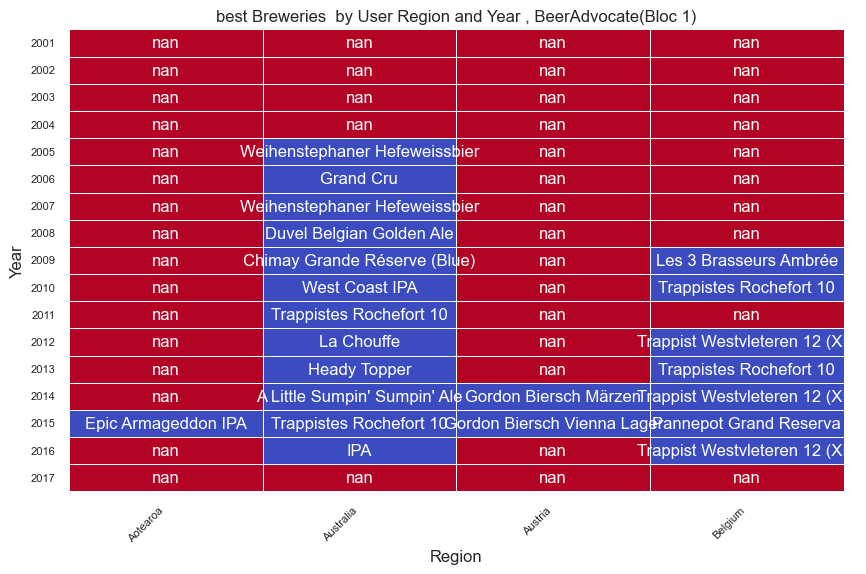

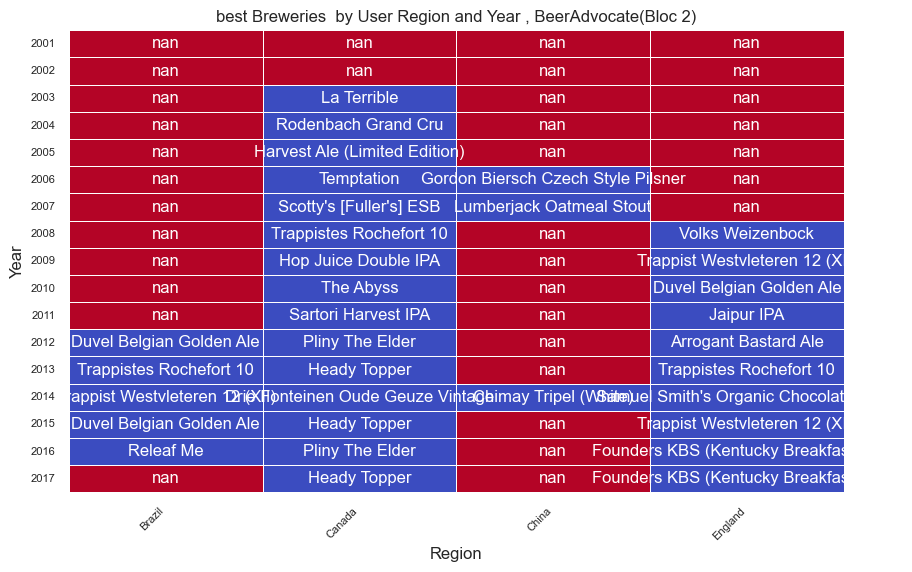

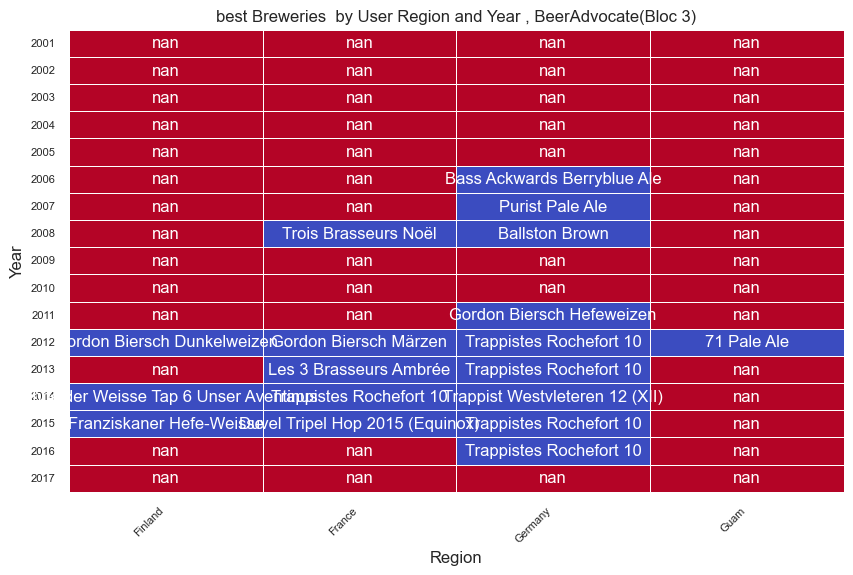

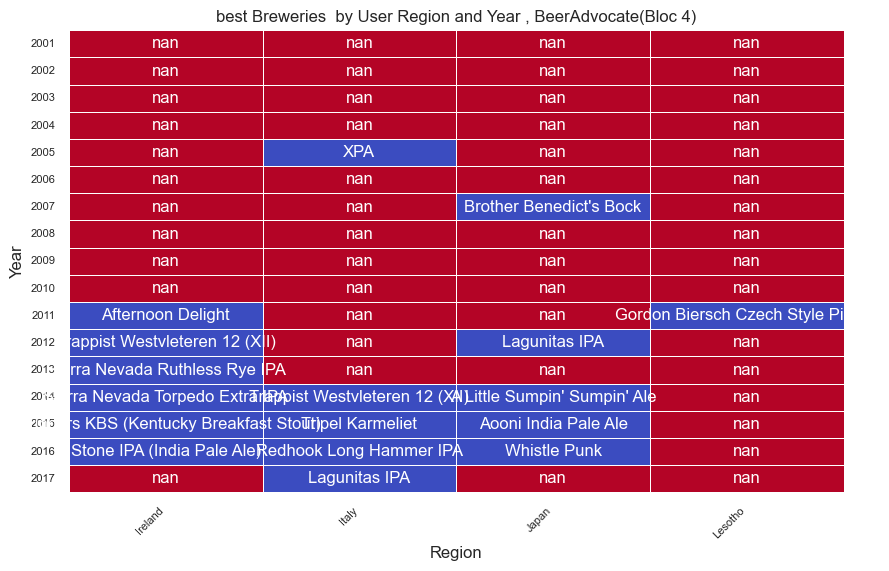

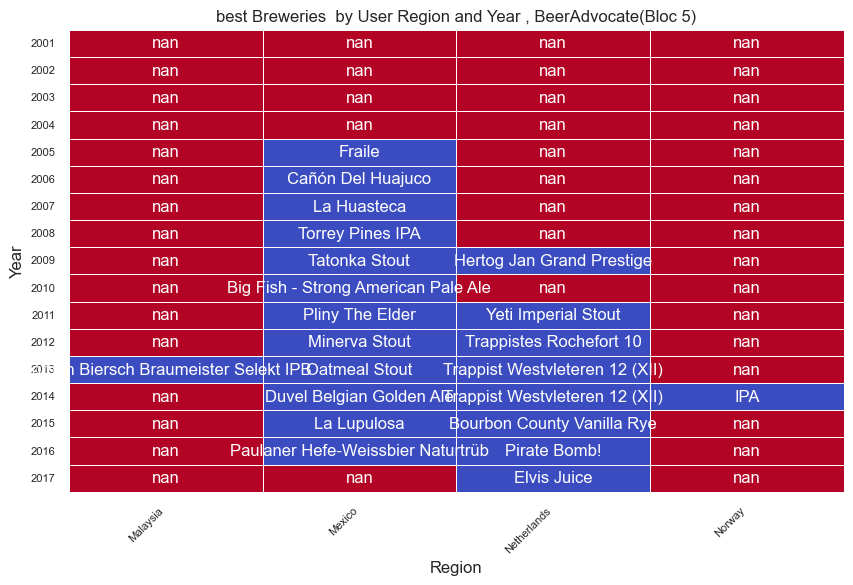

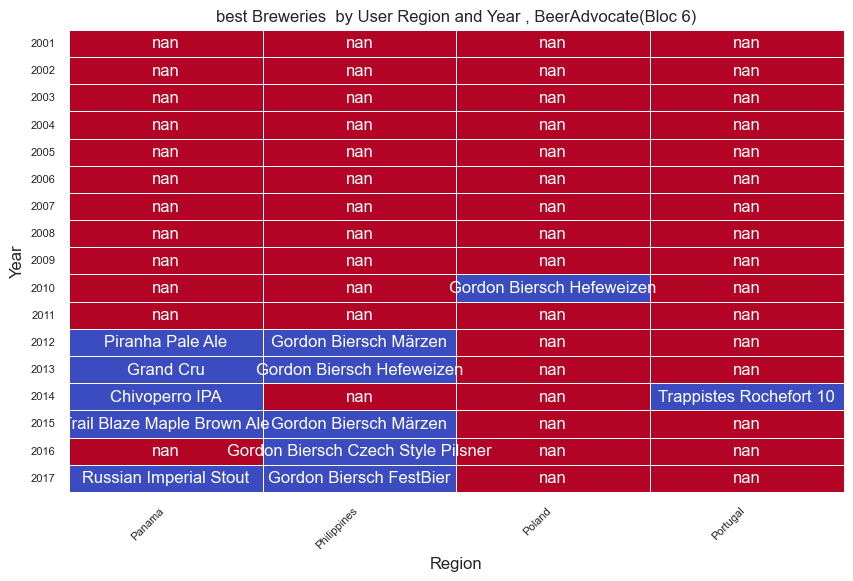

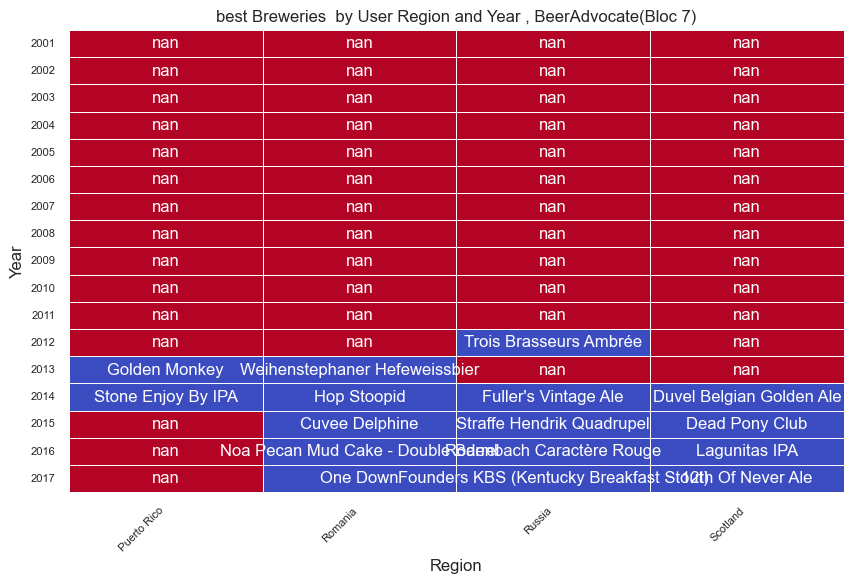

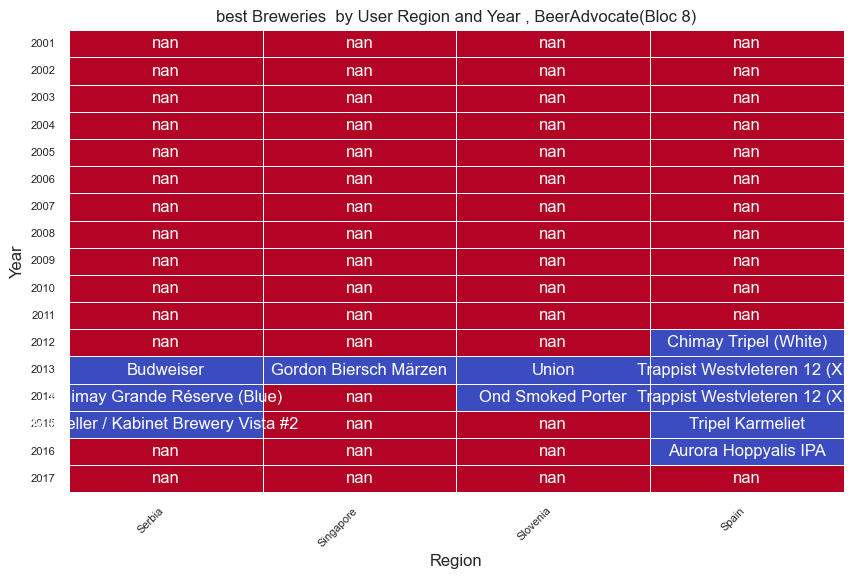

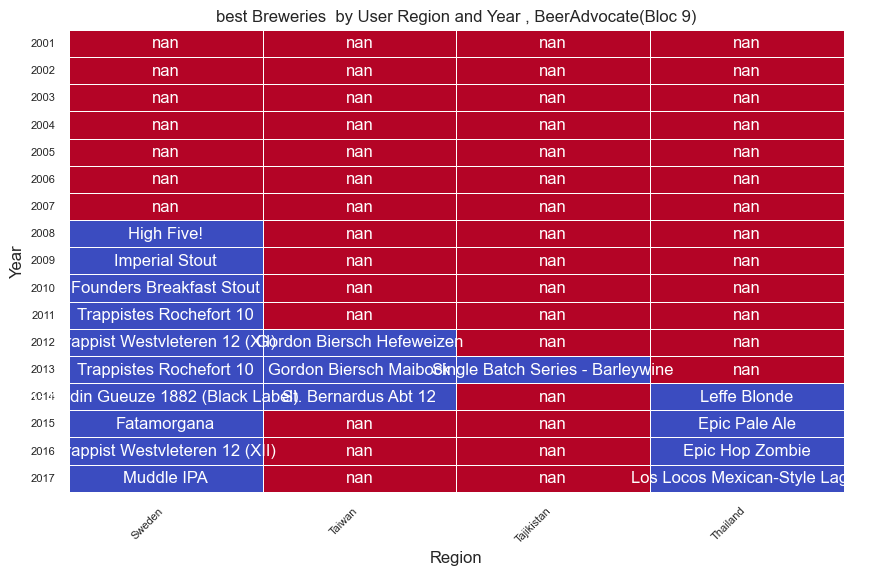

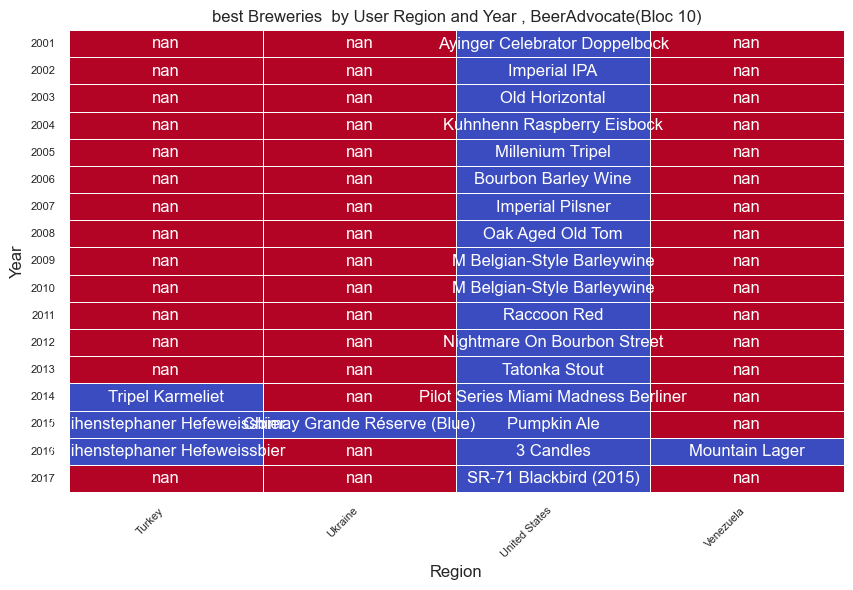

In [276]:
top_ranked_beers_br_ba = weighted_avg_ratings_br_ba[weighted_avg_ratings_br_ba['rank'] == 1]


pivot_data_br_ba = top_ranked_beers_br_ba.pivot_table(
    values='brewery_name', 
    index='year', 
    columns='location_user', 
    aggfunc=lambda x: ', '.join(x.dropna())
)


chunk_size = 4  
num_chunks = (pivot_data_name_ba.shape[1] + chunk_size - 1) // chunk_size

for i in range(num_chunks):
    start = i * chunk_size
    end = start + chunk_size
    chunk = pivot_data_name_ba.iloc[:, start:end] 
    
    
    plt.figure(figsize=(10, 6))  
    sns.heatmap(
        chunk.isna().astype(int), 
        annot=chunk, fmt='', cmap='coolwarm', linewidths=0.5, cbar=False
    )
    plt.title(f'best Breweries  by User Region and Year , BeerAdvocate(Bloc {i+1})')
    plt.xlabel('Region')
    plt.ylabel('Year')
    plt.xticks(rotation=45, ha='right', fontsize=8)
    plt.yticks(fontsize=8)
    plt.show()



This are the best Breweries over the time for BeerAdvocate

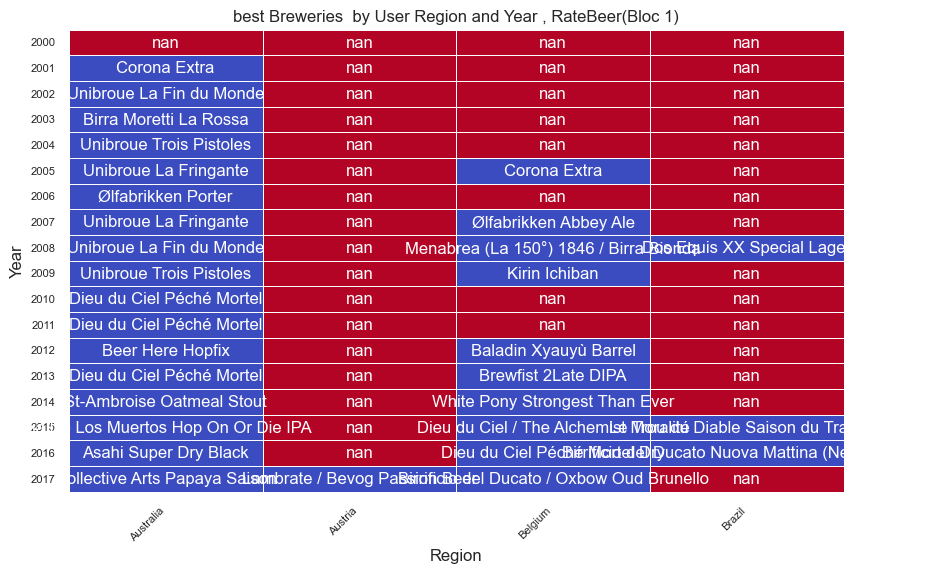

/opt/anaconda3/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 158 (\x9e) missing from font(s) Arial.
  fig.canvas.print_figure(bytes_io, **kw)
/opt/anaconda3/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 146 (\x92) missing from font(s) Arial.
  fig.canvas.print_figure(bytes_io, **kw)
/opt/anaconda3/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 154 (\x9a) missing from font(s) Arial.
  fig.canvas.print_figure(bytes_io, **kw)


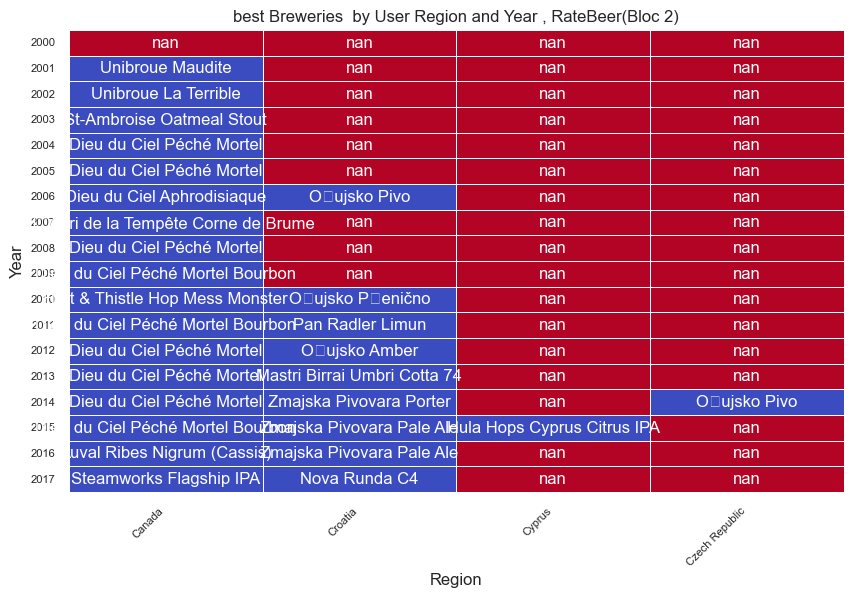

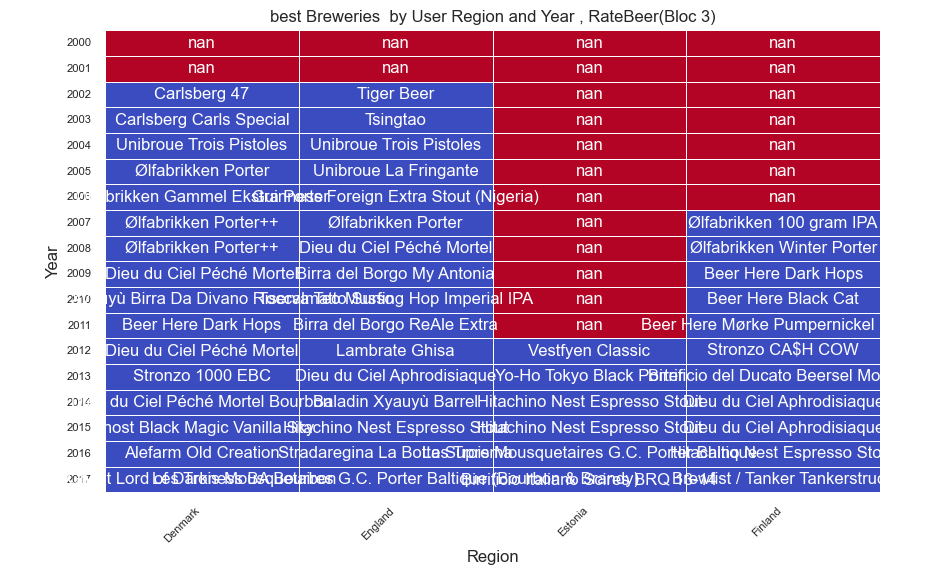

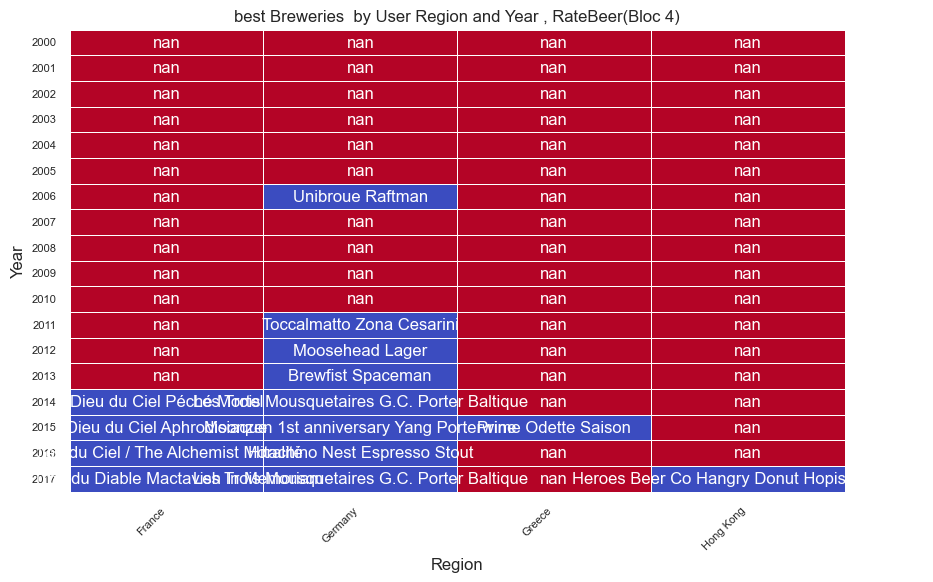

/opt/anaconda3/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 146 (\x92) missing from font(s) Arial.
  fig.canvas.print_figure(bytes_io, **kw)


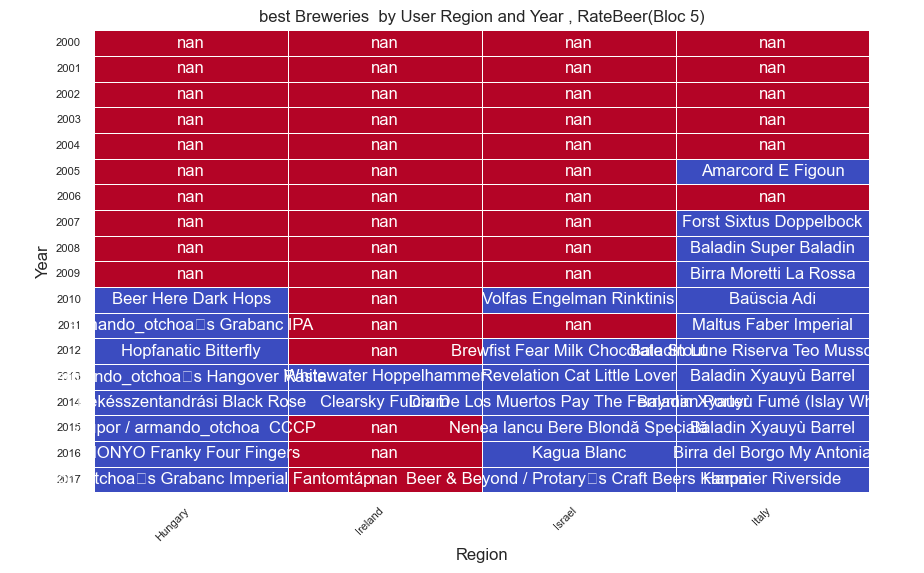

/opt/anaconda3/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 146 (\x92) missing from font(s) Arial.
  fig.canvas.print_figure(bytes_io, **kw)


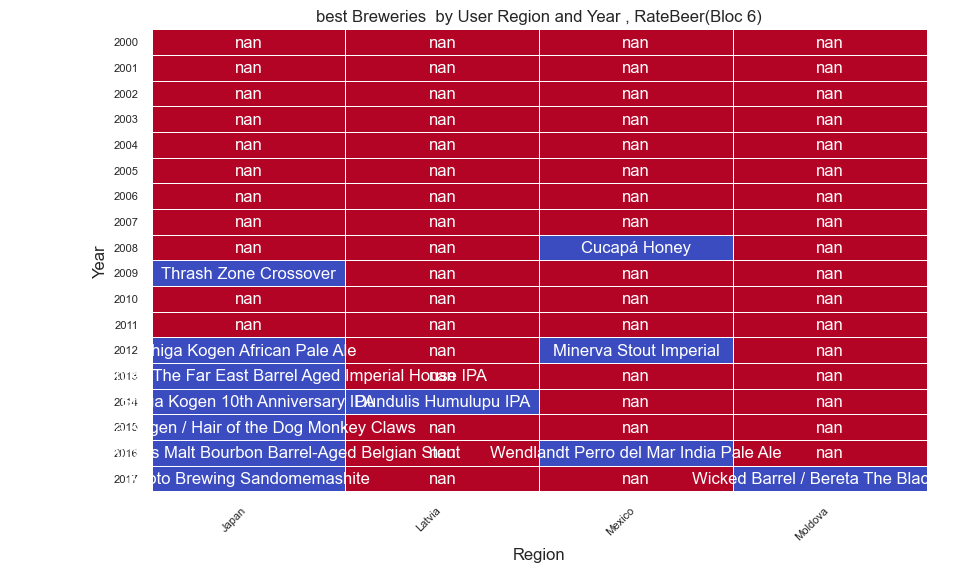

/opt/anaconda3/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 146 (\x92) missing from font(s) Arial.
  fig.canvas.print_figure(bytes_io, **kw)


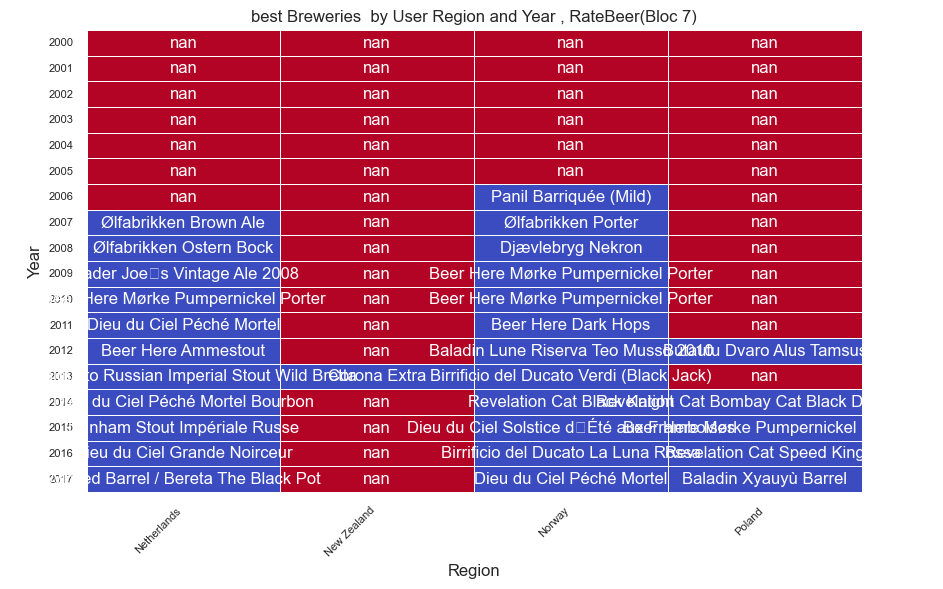

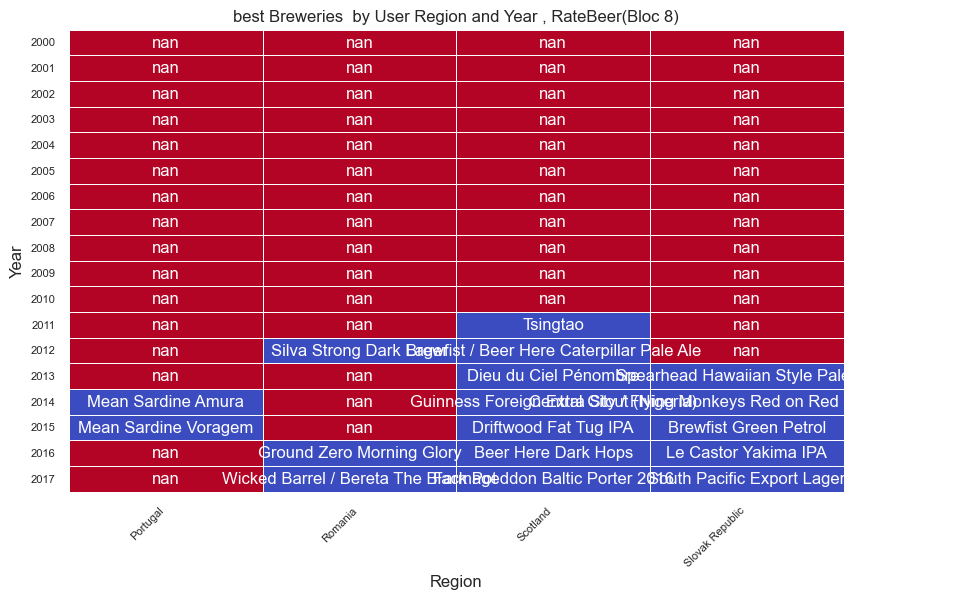

/opt/anaconda3/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 146 (\x92) missing from font(s) Arial.
  fig.canvas.print_figure(bytes_io, **kw)


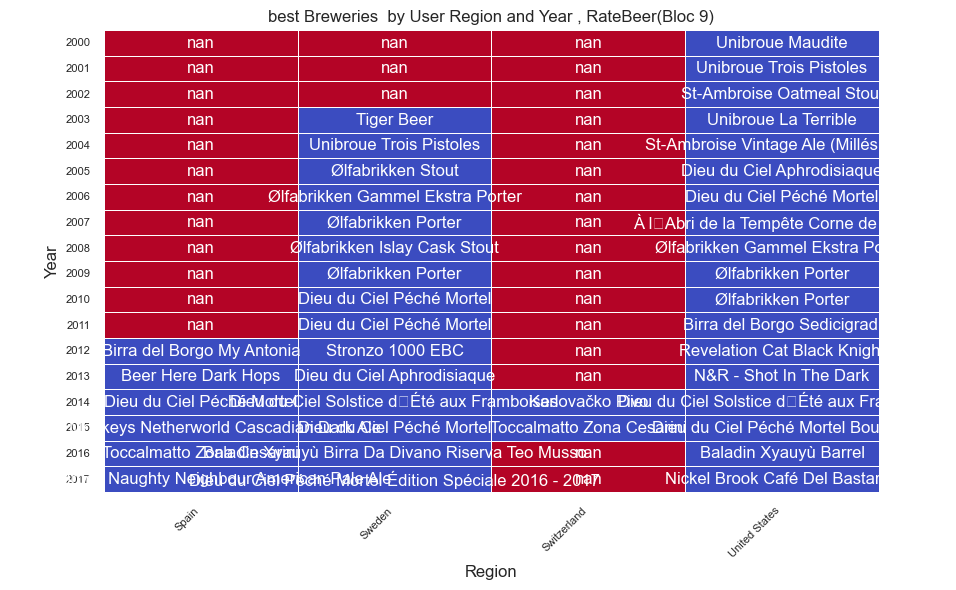

In [277]:
top_ranked_beers_br_rb = weighted_avg_ratings_br_rb[weighted_avg_ratings_br_rb['rank'] == 1]


pivot_data_br_rb = top_ranked_beers_br_rb.pivot_table(
    values='brewery_name', 
    index='year', 
    columns='location_user', 
    aggfunc=lambda x: ', '.join(x.dropna())
)


chunk_size = 4  
num_chunks = (pivot_data_name_rb.shape[1] + chunk_size - 1) // chunk_size

for i in range(num_chunks):
    start = i * chunk_size
    end = start + chunk_size
    chunk = pivot_data_name_rb.iloc[:, start:end] 
    
    
    plt.figure(figsize=(10, 6))  
    sns.heatmap(
        chunk.isna().astype(int), 
        annot=chunk, fmt='', cmap='coolwarm', linewidths=0.5, cbar=False
    )
    plt.title(f'best Breweries  by User Region and Year , RateBeer(Bloc {i+1})')
    plt.xlabel('Region')
    plt.ylabel('Year')
    plt.xticks(rotation=45, ha='right', fontsize=8)
    plt.yticks(fontsize=8)
    plt.show()


This are the best Breweries for RateBeer user 

Correlation between Number of reviews and average rating, BeerAdvocate: 0.055518135128566945


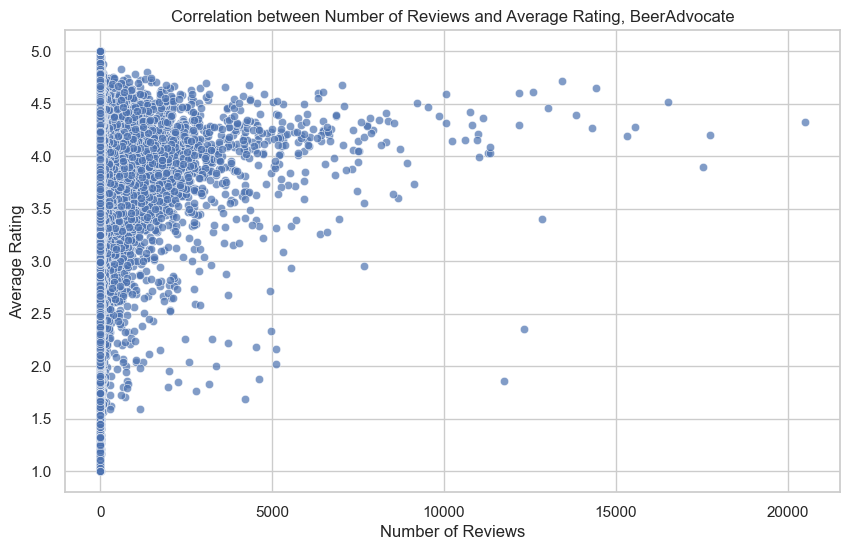

In [278]:

# Calculate the total ratings and review count for each beer
beer_stats_ba = total_ba.groupby('beer_id').agg(
    total_ratings=('rating', 'sum'),       # Sum of regular ratings for each beer
    review_count=('rating', 'count')       # Count of the number of reviews for each beer
).reset_index()

# Calculate the average rating for each beer (regular, not weighted)
beer_stats_ba['average_rating'] = beer_stats_ba['total_ratings'] / beer_stats_ba['review_count']

# Calculate correlation between the number of reviews and the average rating
correlation_ba = beer_stats_ba[['review_count', 'average_rating']].corr().iloc[0, 1]
print(f"Correlation between Number of reviews and average rating, BeerAdvocate: {correlation_ba}")

# Visualize the correlation between review count and average rating
plt.figure(figsize=(10, 6))
sns.scatterplot(data=beer_stats_ba, x='review_count', y='average_rating', alpha=0.7)
plt.title('Correlation between Number of Reviews and Average Rating, BeerAdvocate')
plt.xlabel('Number of Reviews')
plt.ylabel('Average Rating')
plt.grid(True)
plt.show()

We are not usiging weight on average rating because we want observe the correlation with the number of ratings.


The low correlation between the number of votes  and the average rating suggests on BeerAdvocate that popularity (as measured by the number of reviews) does not necessarily equate to higher quality or better appreciation

Correlation between Number of reviews and average rating(RB): -0.008951125354406838


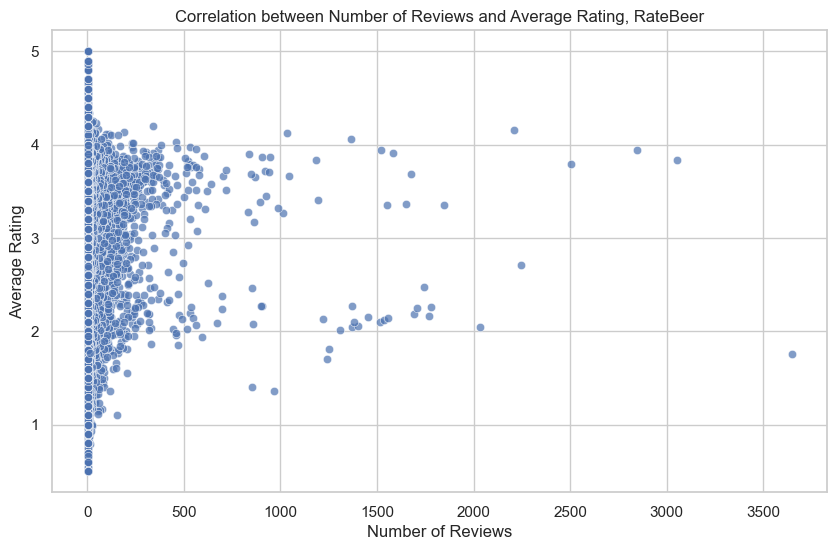

In [279]:

# Calculate the total ratings and review count for each beer
beer_stats_rb = total_rb.groupby('beer_id').agg(
    total_ratings=('rating', 'sum'),       # Sum of regular ratings for each beer
    review_count=('rating', 'count')       # Count of the number of reviews for each beer
).reset_index()

# Calculate the average rating for each beer (regular, not weighted)
beer_stats_rb['average_rating'] = beer_stats_rb['total_ratings'] / beer_stats_rb['review_count']

# Calculate correlation between the number of reviews and the average rating
correlation = beer_stats_rb[['review_count', 'average_rating']].corr().iloc[0, 1]
print(f"Correlation between Number of reviews and average rating(RB): {correlation}")

# Visualize the correlation between review count and average rating
plt.figure(figsize=(10, 6))
sns.scatterplot(data=beer_stats_rb, x='review_count', y='average_rating', alpha=0.7)
plt.title('Correlation between Number of Reviews and Average Rating, RateBeer')
plt.xlabel('Number of Reviews')
plt.ylabel('Average Rating')
plt.grid(True)
plt.show()


The low correlation between the number of votes  and the average rating suggests on RateBeer that popularity (as measured by the number of reviews) does not necessarily equate to higher quality or better appreciation

In [280]:

review_counts_fl_ba = total_ba.groupby(['beer_id']).size().reset_index(name='review_count')


reviews_with_counts_fl_ba = pd.merge(total_ba, review_counts_fl_ba, on=['beer_id'])
filtered_reviews_fl_ba= reviews_with_counts_fl_ba[reviews_with_counts_fl_ba['review_count'] >= 5]

weighted_avg_ratings_fl_ba= filtered_reviews_fl_ba.groupby(['style', 'year','review_count', 'location_user']).apply(
    lambda x: (x['rating'] * x['review_count']).sum() / x['review_count'].sum()
).reset_index(name='weighted_avg_rating')


weighted_avg_ratings_fl_ba['rank'] = (
    weighted_avg_ratings_fl_ba.sort_values(['year', 'location_user', 'weighted_avg_rating', 'review_count'], 
                                        ascending=[True, True, False, False])
    .groupby(['year', 'location_user'])
    .cumcount() + 1
)




/var/folders/np/3hhzvb2x6znbzvj6ph2phb8h0000gn/T/ipykernel_51833/3541018838.py:7: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  weighted_avg_ratings_fl_ba= filtered_reviews_fl_ba.groupby(['style', 'year','review_count', 'location_user']).apply(


In [281]:

review_counts_fl_rb = total_rb.groupby(['beer_id']).size().reset_index(name='review_count')


reviews_with_counts_fl_rb = pd.merge(total_rb, review_counts_fl_rb, on=['beer_id'])
filtered_reviews_fl_rb = reviews_with_counts_fl_rb[reviews_with_counts_fl_rb['review_count'] >= 5]

weighted_avg_ratings_fl_rb = filtered_reviews_fl_rb.groupby(['style', 'year','review_count', 'location_user']).apply(
    lambda x: (x['rating'] * x['review_count']).sum() / x['review_count'].sum()
).reset_index(name='weighted_avg_rating')


weighted_avg_ratings_fl_rb['rank'] = (
    weighted_avg_ratings_fl_rb.sort_values(['year', 'location_user', 'weighted_avg_rating', 'review_count'], 
                                        ascending=[True, True, False, False])
    .groupby(['year', 'location_user'])
    .cumcount() + 1
)


/var/folders/np/3hhzvb2x6znbzvj6ph2phb8h0000gn/T/ipykernel_51833/4009867656.py:7: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  weighted_avg_ratings_fl_rb = filtered_reviews_fl_rb.groupby(['style', 'year','review_count', 'location_user']).apply(


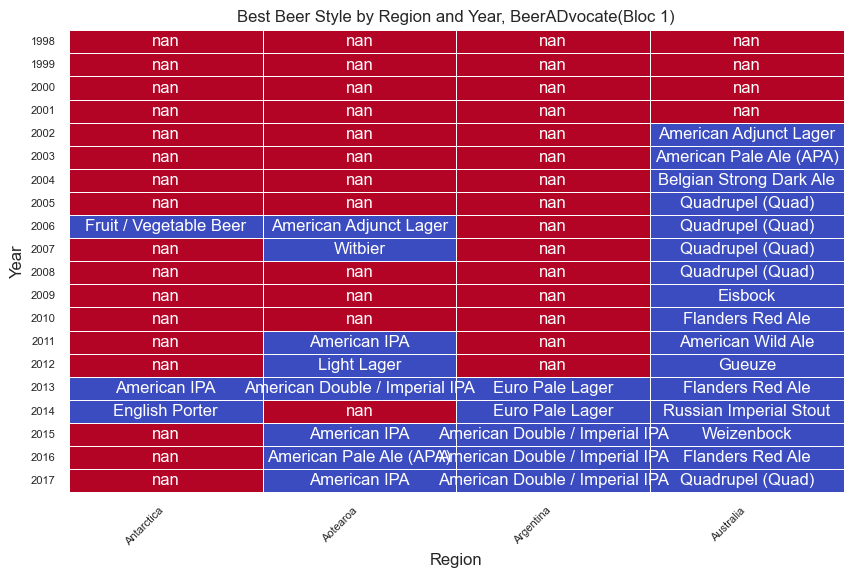

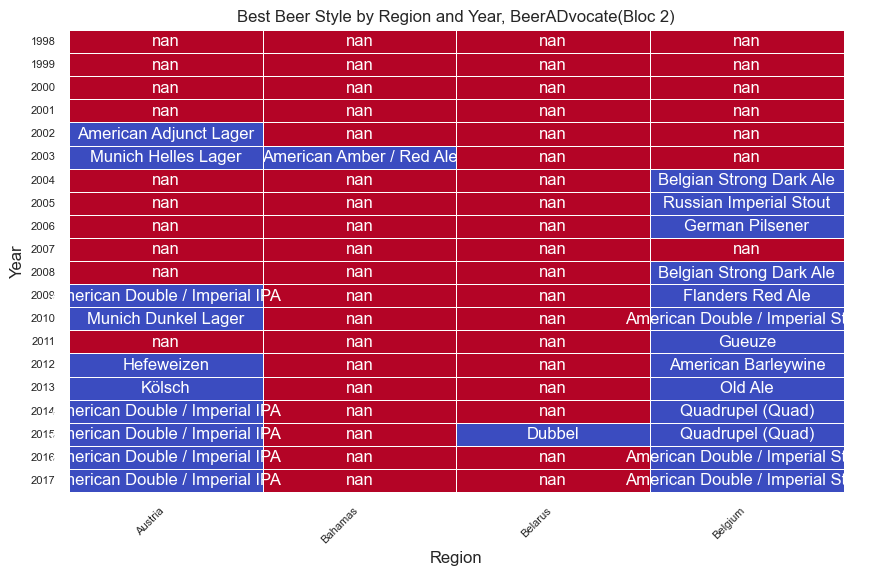

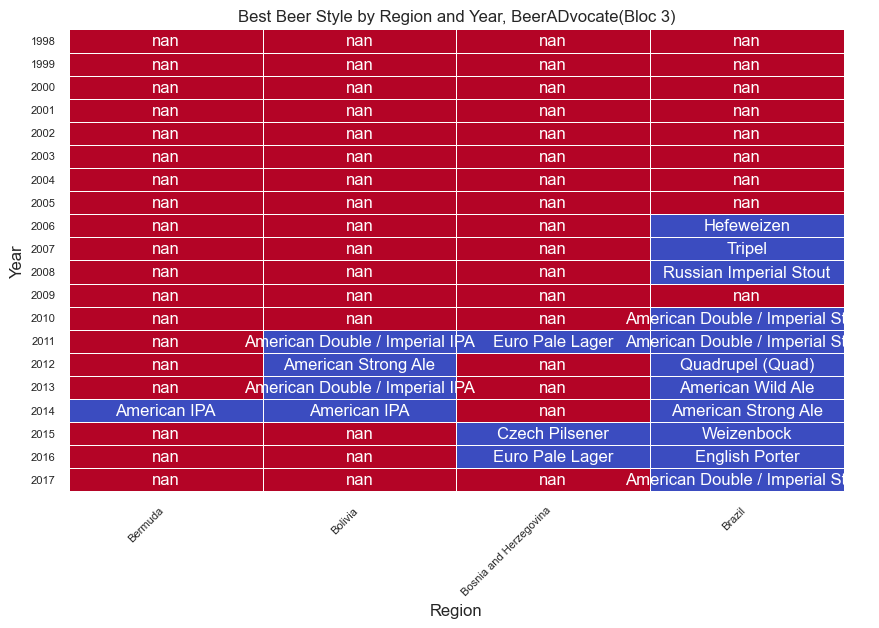

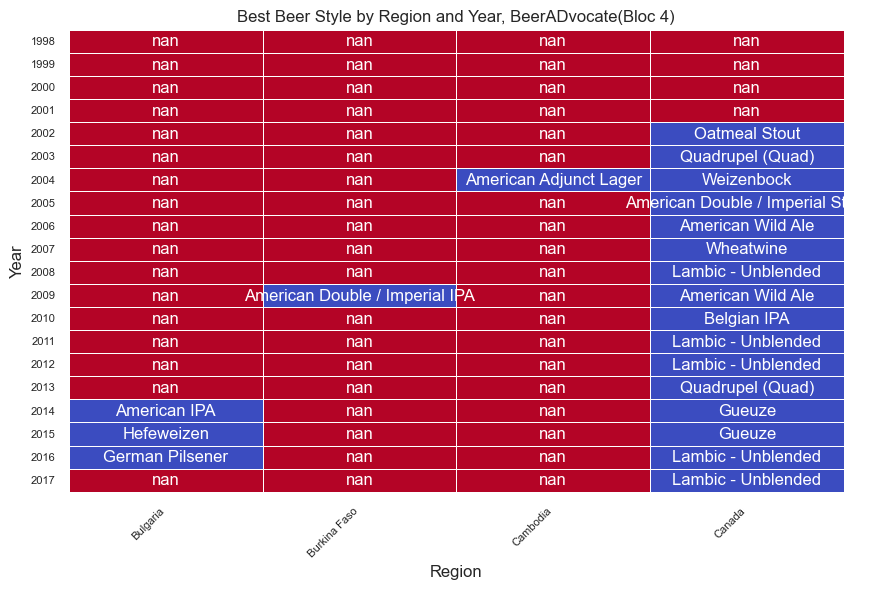

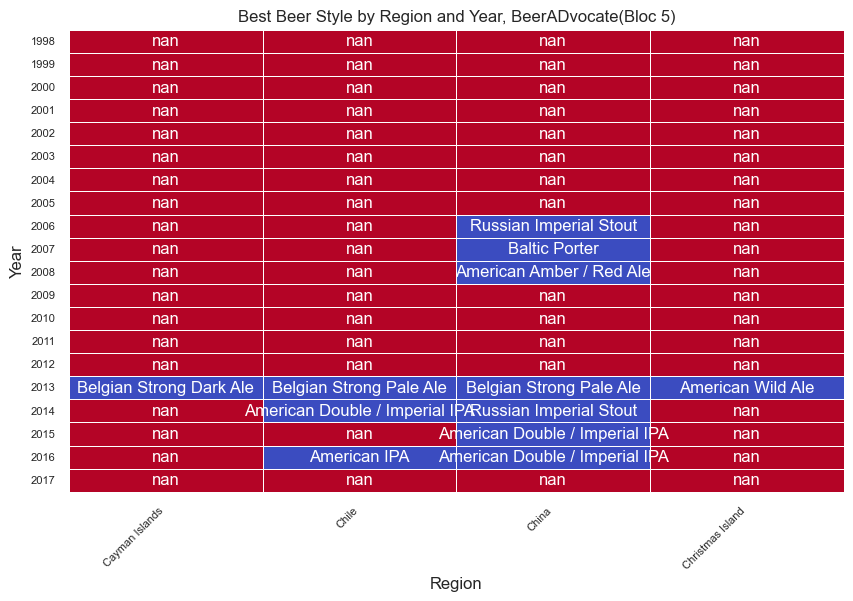

...

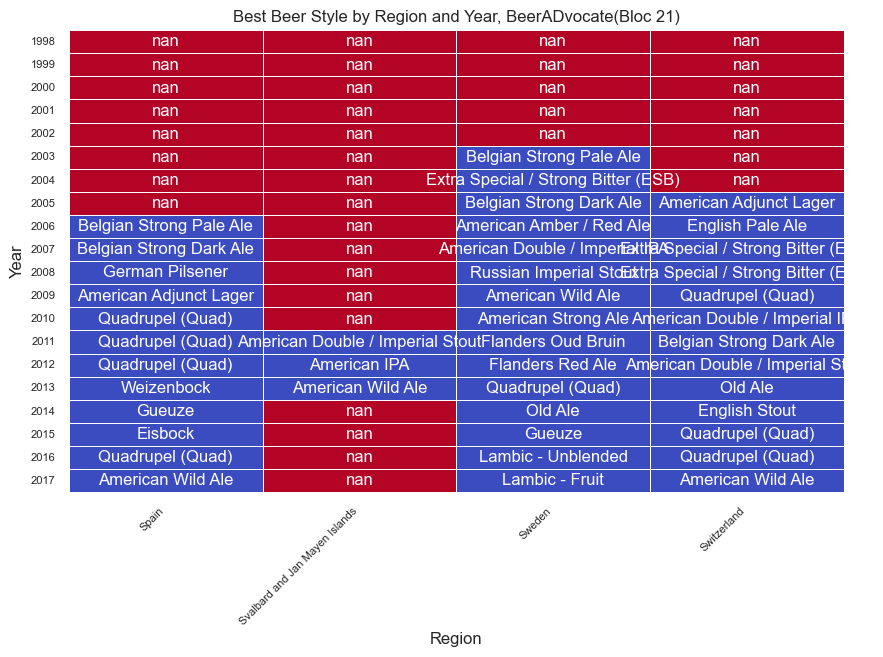

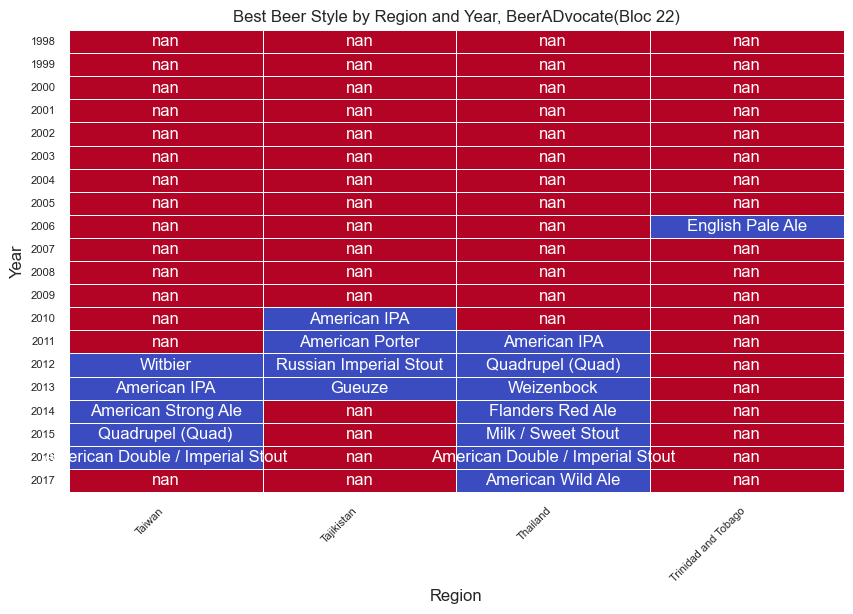

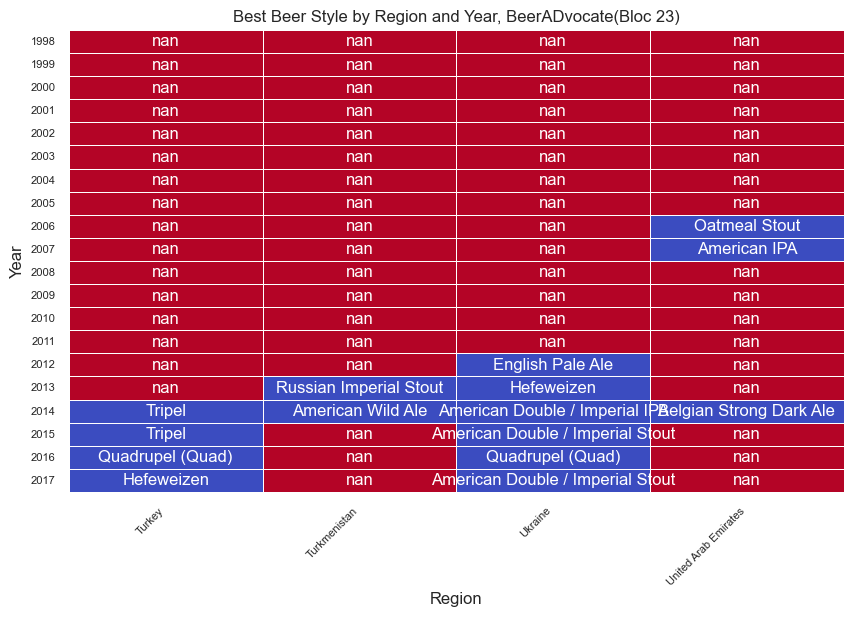

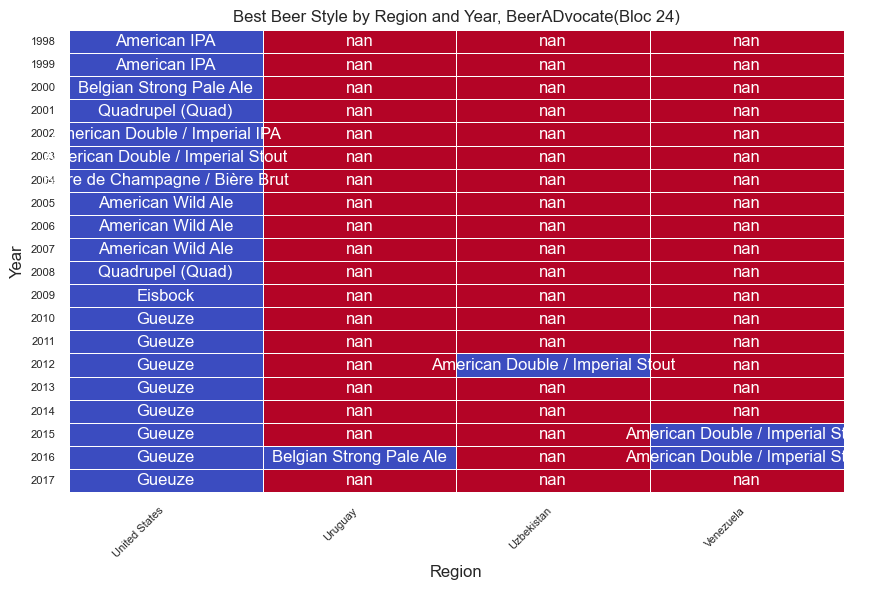

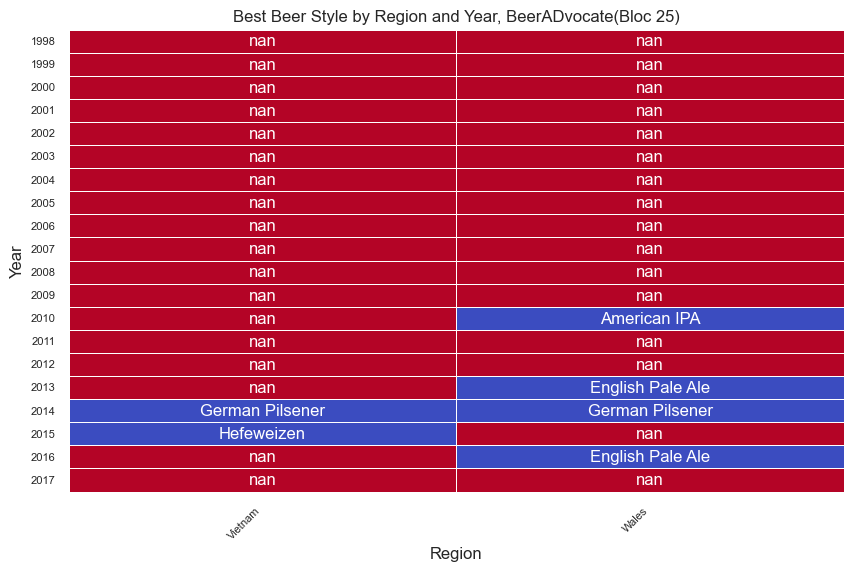

In [282]:
top_ranked_beers_fl_ba = weighted_avg_ratings_fl_ba[weighted_avg_ratings_fl_ba['rank'] == 1]

pivot_data_fl_ba = top_ranked_beers_fl_ba.pivot_table(
    values='style', 
    index='year', 
    columns='location_user', 
    aggfunc=lambda x: ', '.join(x.dropna())
)


chunk_size = 4  
num_chunks = (pivot_data_fl_ba.shape[1] + chunk_size - 1) // chunk_size

for i in range(num_chunks):
    start = i * chunk_size
    end = start + chunk_size
    chunk = pivot_data_fl_ba.iloc[:, start:end] 
   
    plt.figure(figsize=(10, 6)) 
    sns.heatmap(
        chunk.isna().astype(int), 
        annot=chunk, fmt='', cmap='coolwarm', linewidths=0.5, cbar=False
    )
    plt.title(f'Best Beer Style by Region and Year, BeerADvocate(Bloc {i+1})')
    plt.xlabel('Region')
    plt.ylabel('Year')
    plt.xticks(rotation=45, ha='right', fontsize=8)
    plt.yticks(fontsize=8)
    plt.show()


The graph displaying the preferred beer style by year for each state for BeerAdvocate  reveal  some trends over the years in some countries , but overall, there is a lot of variability in preferences across years

In [ ]:
This variability highlights the dynamic nature of the craft beer scene, where consumer tastes and brewery offerings can evolve quickly.
Beyond a few exceptions, most states do not demonstrate a clear, recurring trend in style preference, emphasizing the dynamic and localized nature of beer culture.

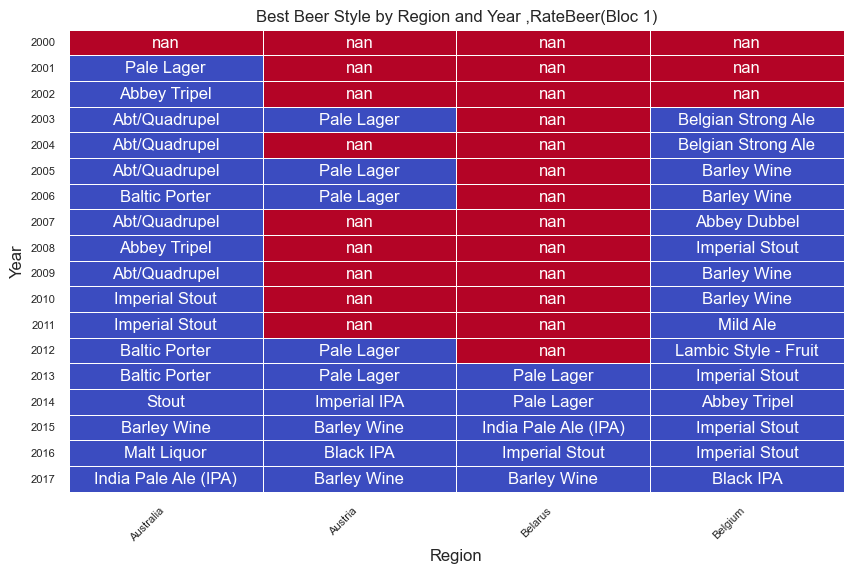

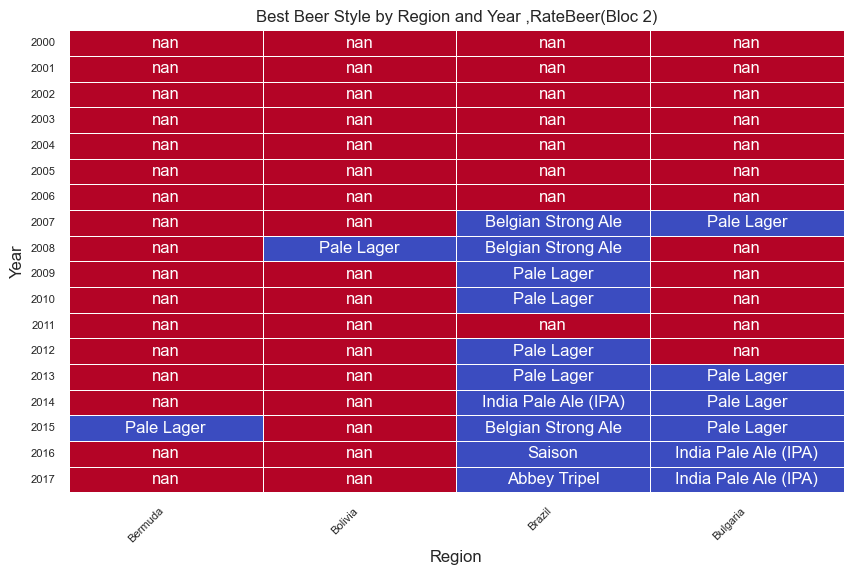

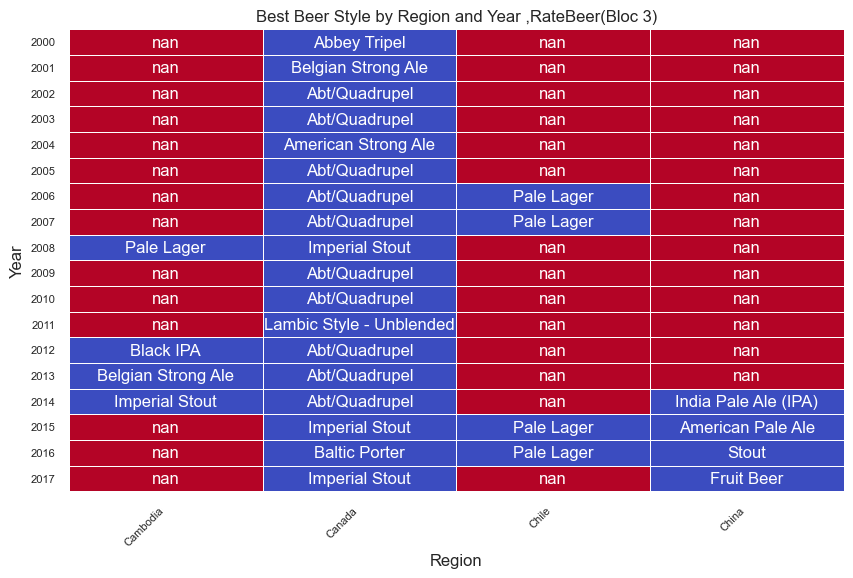

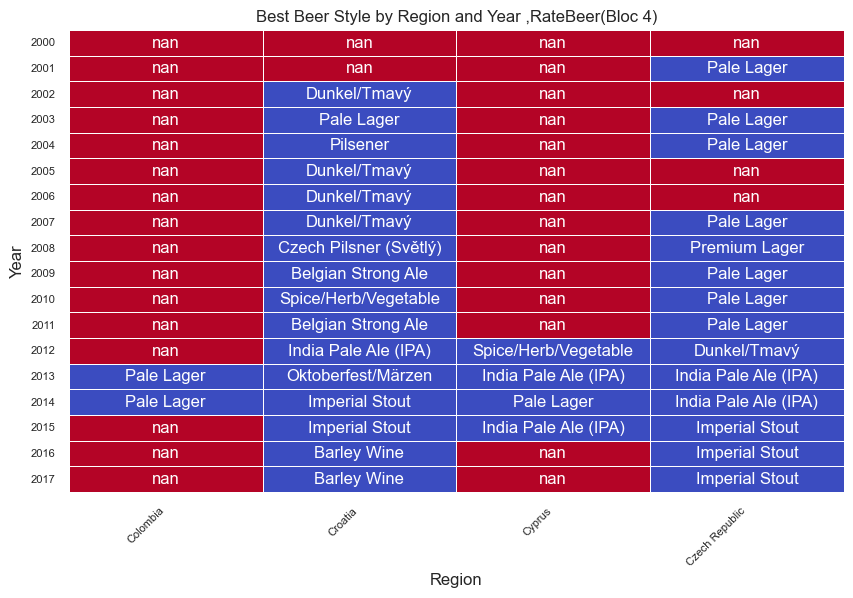

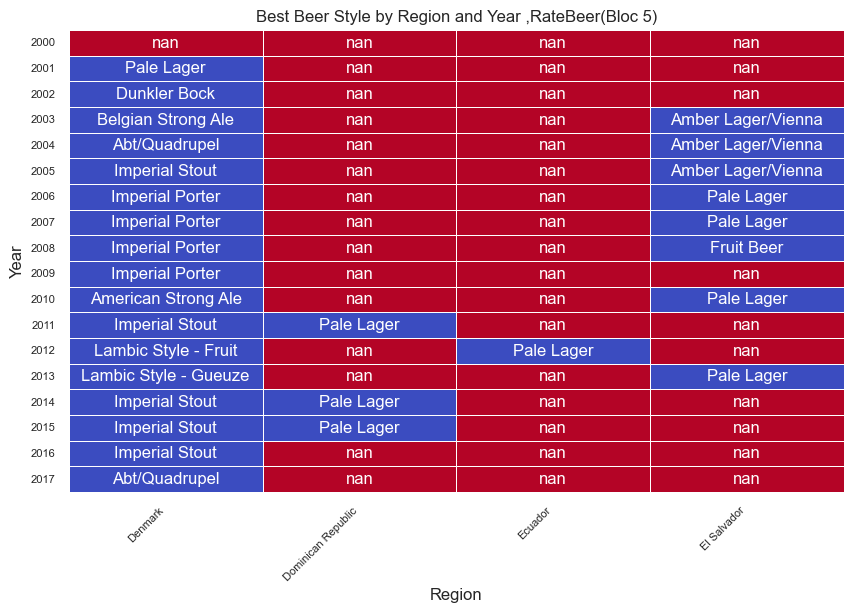

...

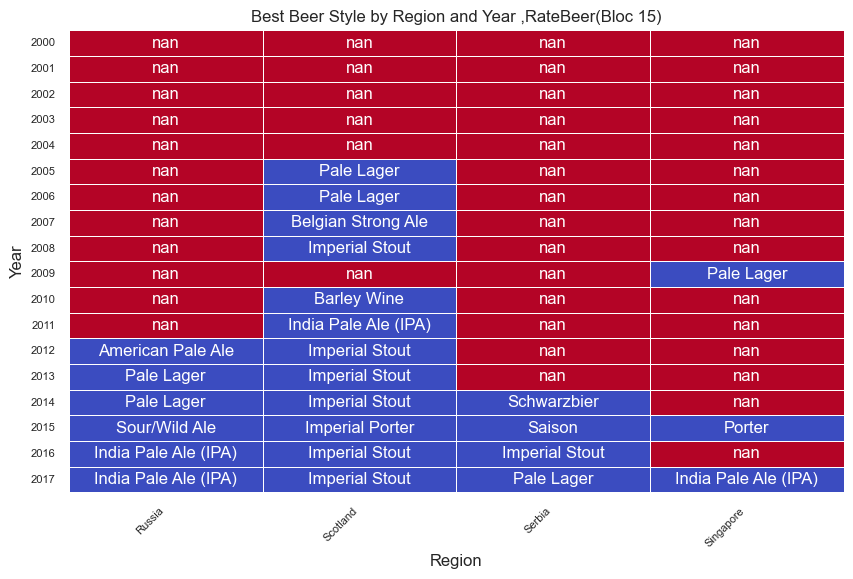

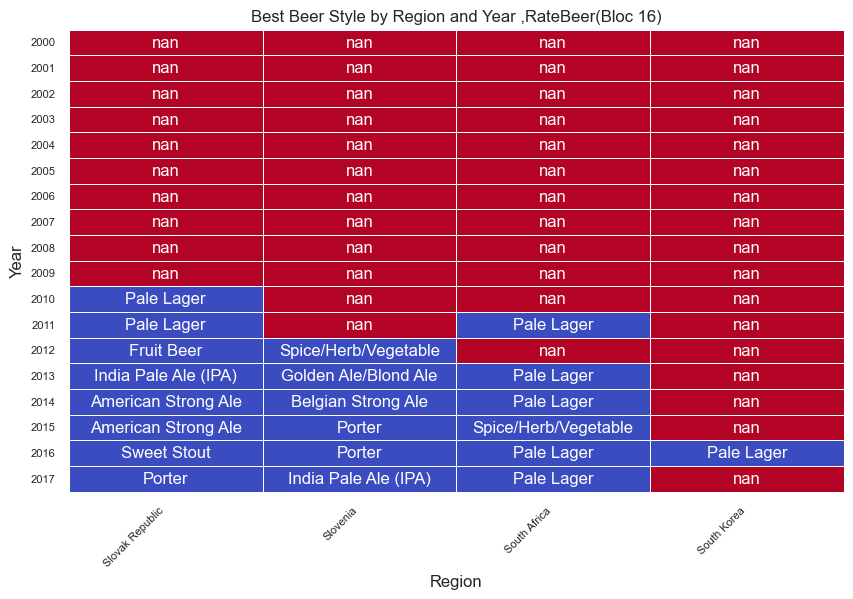

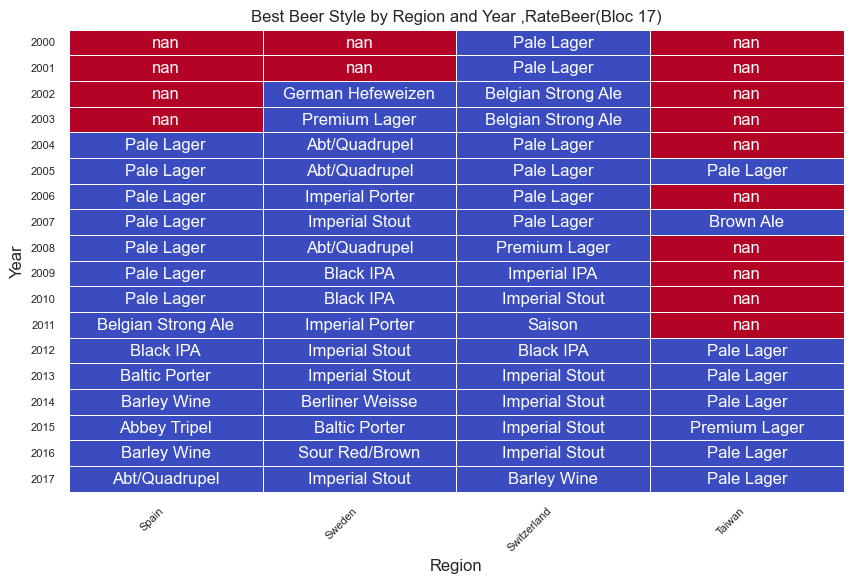

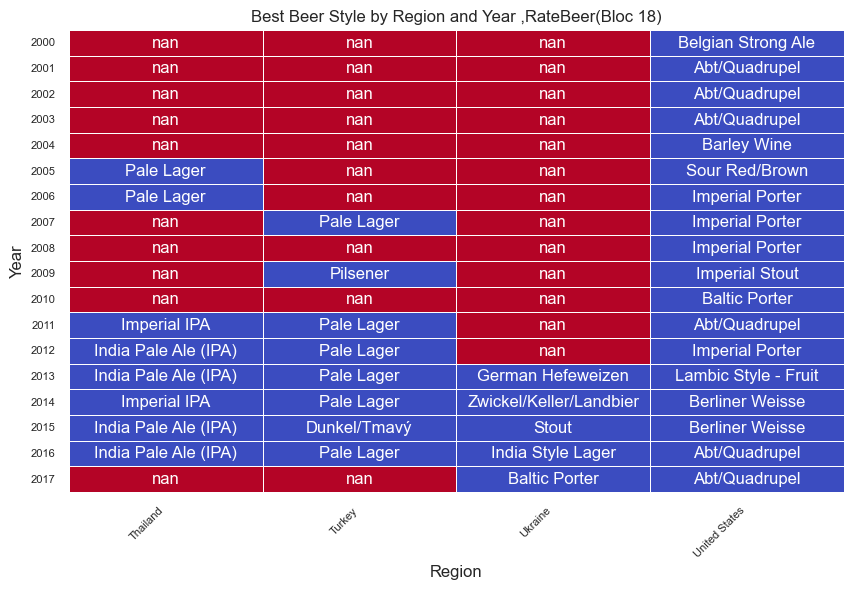

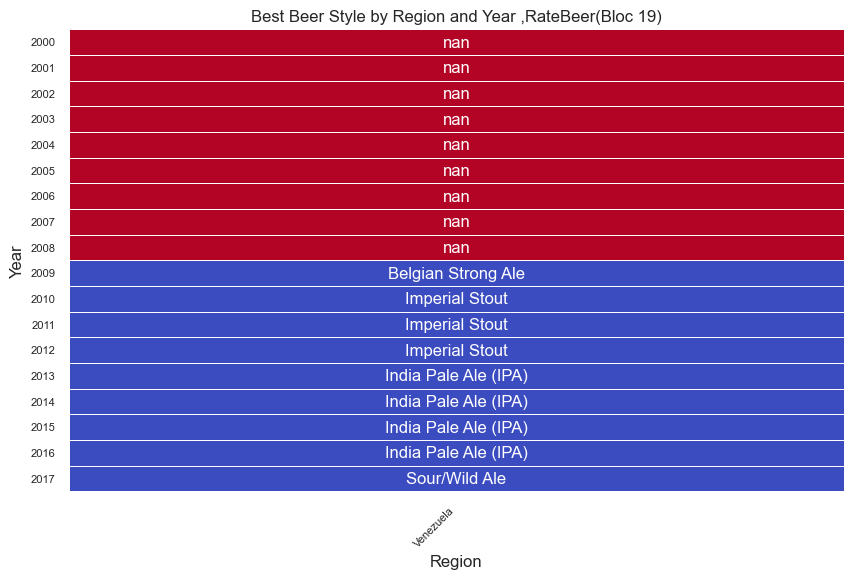

In [283]:
top_ranked_beers_fl_rb = weighted_avg_ratings_fl_rb[weighted_avg_ratings_fl_rb['rank'] == 1]

pivot_data_fl_rb = top_ranked_beers_fl_rb.pivot_table(
    values='style', 
    index='year', 
    columns='location_user', 
    aggfunc=lambda x: ', '.join(x.dropna())
)


chunk_size = 4  
num_chunks = (pivot_data_fl_rb.shape[1] + chunk_size - 1) // chunk_size

for i in range(num_chunks):
    start = i * chunk_size
    end = start + chunk_size
    chunk = pivot_data_fl_rb.iloc[:, start:end] 
   
    plt.figure(figsize=(10, 6)) 
    sns.heatmap(
        chunk.isna().astype(int), 
        annot=chunk, fmt='', cmap='coolwarm', linewidths=0.5, cbar=False
    )
    plt.title(f'Best Beer Style by Region and Year ,RateBeer(Bloc {i+1})')
    plt.xlabel('Region')
    plt.ylabel('Year')
    plt.xticks(rotation=45, ha='right', fontsize=8)
    plt.yticks(fontsize=8)
    plt.show()


The graph displaying the preferred beer style by year for each state for RateBeer  reveal  some trends over the years in some countries , but overall, there is some of variability in preferences across years, but less than BeerAdvocate

In RateBeer, the common styles observed are Imperial Stout and Pale Lager.Imperial Stout and Pale Lager reflect the dual nature of the platform's user base: one group focused on craft beer expertise and another encompassing a more mainstream or global beer audience. 


/var/folders/np/3hhzvb2x6znbzvj6ph2phb8h0000gn/T/ipykernel_51833/3529098518.py:10: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  weighted_avg_styles_ba = filtered_reviews_ba.groupby(['style']).apply(


Correlation between  style (coded) e Weighted average rating, BeerAdvocate: -0.8636071569031808


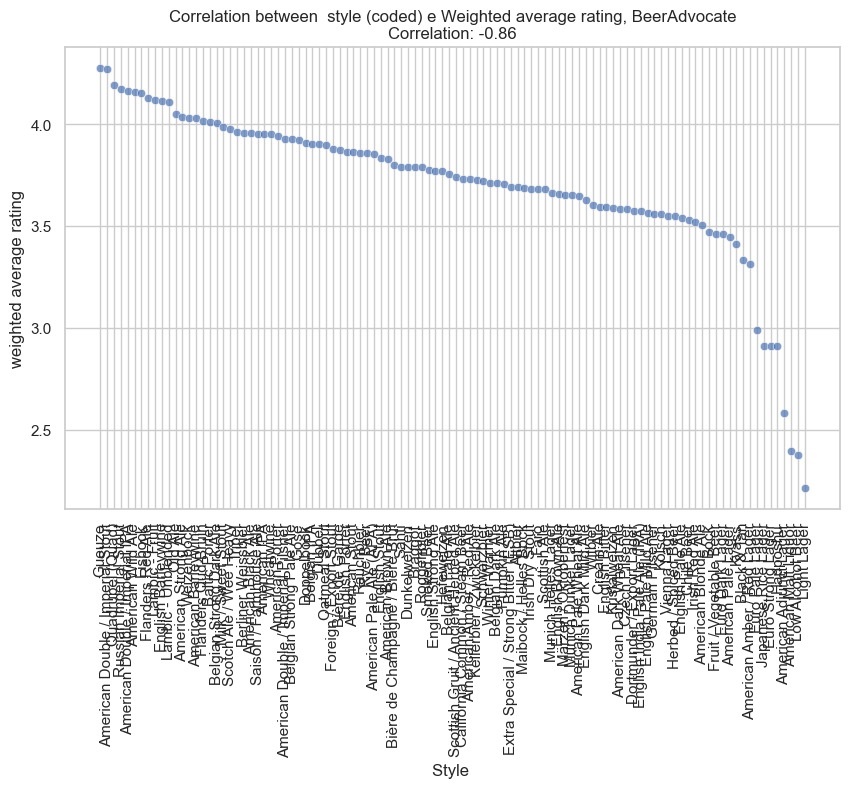

In [284]:
review_counts_ba = total_ba.groupby(['beer_id']).size().reset_index(name='review_count')

# Merge the reviews with their review counts based on style, year, and user location
reviews_with_counts_ba = pd.merge(total_ba, review_counts_ba, on=['beer_id'])

# Filter the reviews to include only those with at least 5 reviews
filtered_reviews_ba = reviews_with_counts_ba[reviews_with_counts_ba['review_count'] >= 5]

# Calculate the weighted average rating for each beer style and user location
weighted_avg_styles_ba = filtered_reviews_ba.groupby(['style']).apply(
    lambda x: (x['rating'] * x['review_count']).sum() / x['review_count'].sum()
).reset_index(name='weighted_avg_rating')

# Sort by weighted average rating
weighted_avg_styles_ba= weighted_avg_styles_ba.sort_values('weighted_avg_rating', ascending=False)


weighted_avg_styles_ba['style_code'] = pd.factorize(weighted_avg_styles_ba['style'])[0]

correlation_ba= weighted_avg_styles_ba[['style_code', 'weighted_avg_rating']].corr().iloc[0, 1]

print(f"Correlation between  style (coded) e Weighted average rating, BeerAdvocate: {correlation_ba}")

plt.figure(figsize=(10, 6))
sns.scatterplot(data=weighted_avg_styles_ba, x='style_code', y='weighted_avg_rating', alpha=0.7)
plt.title(f'Correlation between  style (coded) e Weighted average rating, BeerAdvocate\nCorrelation: {correlation_ba:.2f}')
plt.xlabel('Style ')
plt.ylabel('weighted average rating')
plt.xticks(weighted_avg_styles_ba['style_code'], weighted_avg_styles_ba['style'], rotation=90)
plt.grid(True)
plt.show()


/var/folders/np/3hhzvb2x6znbzvj6ph2phb8h0000gn/T/ipykernel_51833/2593570279.py:10: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  weighted_avg_styles_rb = filtered_reviews_rb.groupby(['style']).apply(


Correlation between  style (coded) e Weighted average rating, RateBeer: -0.9056385068911017


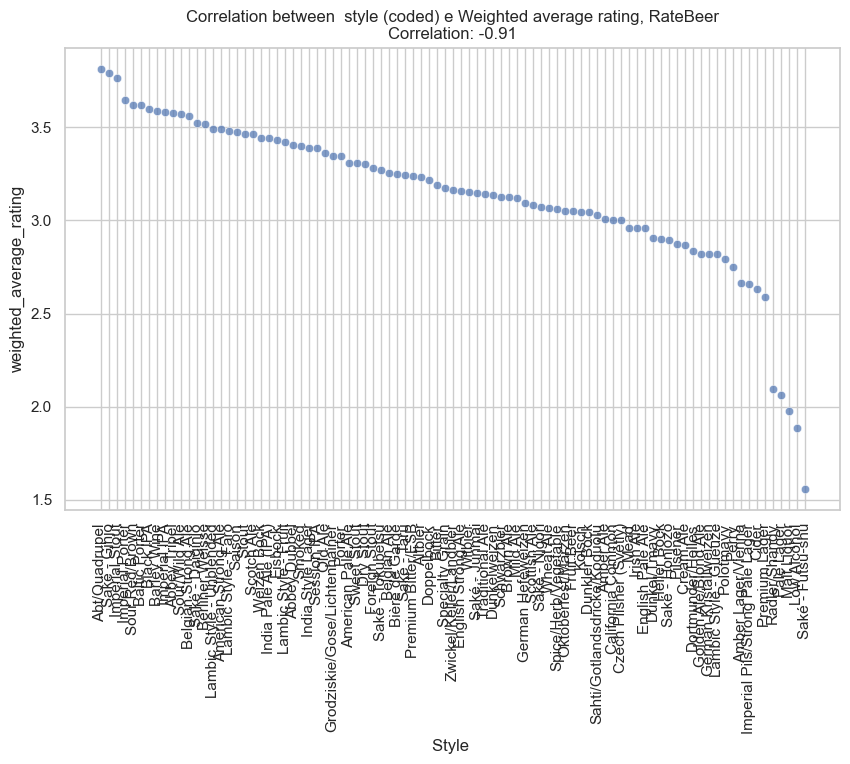

In [343]:
review_counts_rb = total_rb.groupby(['beer_id']).size().reset_index(name='review_count')

# Merge the reviews with their review counts based on style, year, and user location
reviews_with_counts_rb = pd.merge(total_rb, review_counts_rb, on=['beer_id'])

# Filter the reviews to include only those with at least 5 reviews
filtered_reviews_rb = reviews_with_counts_rb[reviews_with_counts_rb['review_count'] >= 5]

# Calculate the weighted average rating for each beer style and user location
weighted_avg_styles_rb = filtered_reviews_rb.groupby(['style']).apply(
    lambda x: (x['rating'] * x['review_count']).sum() / x['review_count'].sum()
).reset_index(name='weighted_avg_rating')

# Sort by weighted average rating
weighted_avg_styles_rb= weighted_avg_styles_rb.sort_values('weighted_avg_rating', ascending=False)


weighted_avg_styles_rb['style_code'] = pd.factorize(weighted_avg_styles_rb['style'])[0]

correlation = weighted_avg_styles_rb[['style_code', 'weighted_avg_rating']].corr().iloc[0, 1]

print(f"Correlation between  style (coded) e Weighted average rating, RateBeer: {correlation}")

plt.figure(figsize=(10, 6))
sns.scatterplot(data=weighted_avg_styles_rb, x='style_code', y='weighted_avg_rating', alpha=0.7)
plt.title(f'Correlation between  style (coded) e Weighted average rating, RateBeer\nCorrelation: {correlation:.2f}')
plt.xlabel('Style ')
plt.ylabel('weighted_average_rating')
plt.xticks(weighted_avg_styles_rb['style_code'], weighted_avg_styles_rb['style'], rotation=90)
plt.grid(True)
plt.show()

Strong Negative Correlation on RateBeer:this suggests that certain beer styles tend to have consistently lower or higher average ratings.

The high correlation between style and avg reinforces the strong influence of beer style on perceptions of quality. The correlation suggests that styles themselves may predispose certain beers to higher or lower ratings, independent of individual beer quality.

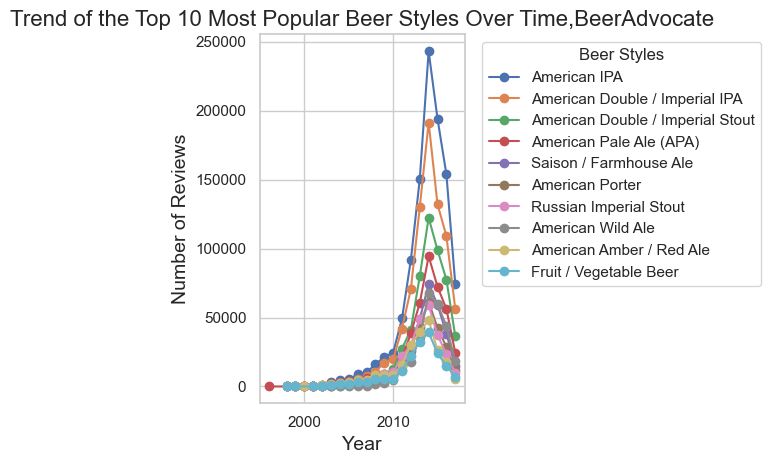

In [298]:


style_review_count_ba = total_ba.groupby(['year', 'style']).size().reset_index(name='review_count')

style_avg_ratings_ba = total_ba.groupby(['year', 'style'])['rating'].mean().reset_index(name='average_rating')

most_reviewed_style_idx_ba = style_review_count_ba.groupby('year')['review_count'].idxmax()
most_reviewed_style_ba = style_review_count_ba.loc[most_reviewed_style_idx_ba]

style_analysis_ba = pd.merge(most_reviewed_style_ba, style_avg_ratings_ba, on=['year', 'style'], how='left')

top_10_styles_ba = style_review_count_ba.groupby('style')['review_count'].sum().nlargest(10).index

# Filter the dataframe to include only the top 10 most popular styles
top_styles_data_ba = style_review_count_ba[style_review_count_ba['style'].isin(top_10_styles_ba)]

# Plot data for each of the 10 most popular styles
for style in top_10_styles_ba:
    style_data_ba = top_styles_data_ba[top_styles_data_ba['style'] == style]
    plt.plot(style_data_ba['year'], style_data_ba['review_count'], label=style, marker='o')

# Add title, labels, and legend
plt.title('Trend of the Top 10 Most Popular Beer Styles Over Time,BeerAdvocate', fontsize=16)
plt.xlabel('Year', fontsize=14)
plt.ylabel('Number of Reviews', fontsize=14)
plt.legend(title="Beer Styles", bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(True)

# Add layout to prevent cutting off titles
plt.tight_layout()

# Display the plot
plt.show()



The peak in the number of reviews on BeerAdvocate around 2016/2017 can be attributed to several factors, reflecting the platform's growth and the craft beer industry's evolution during that time.The mid-2010s marked a period of exponential growth in the craft beer industry, particularly in the US.By 2016, BeerAdvocate had established itself as one of the premier beer review platforms, attracting a large and active user base 

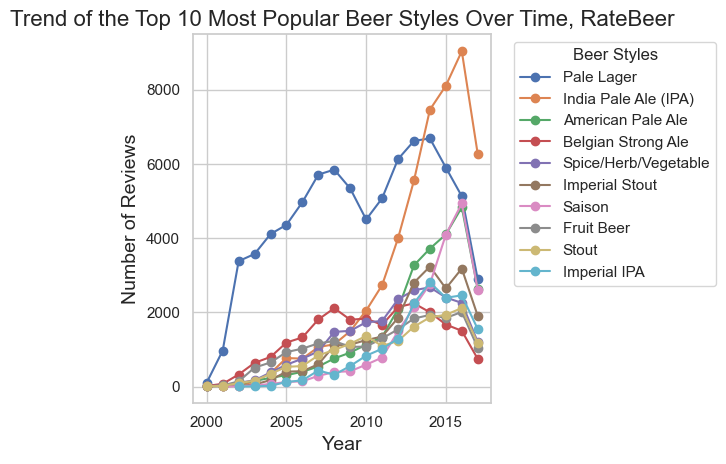

In [299]:
style_review_count_rb= total_rb.groupby(['year', 'style']).size().reset_index(name='review_count')

style_avg_ratings_rb = total_rb.groupby(['year', 'style'])['rating'].mean().reset_index(name='average_rating')

most_reviewed_style_idx_rb = style_review_count_rb.groupby('year')['review_count'].idxmax()
most_reviewed_style_rb = style_review_count_rb.loc[most_reviewed_style_idx_rb]

style_analysis_rb = pd.merge(most_reviewed_style_rb, style_avg_ratings_rb, on=['year', 'style'], how='left')

top_10_styles_rb = style_review_count_rb.groupby('style')['review_count'].sum().nlargest(10).index

# Filter the dataframe to include only the top 10 most popular styles
top_styles_data_rb = style_review_count_rb[style_review_count_rb['style'].isin(top_10_styles_rb)]

# Plot data for each of the 10 most popular styles
for style in top_10_styles_rb:
    style_data_rb = top_styles_data_rb[top_styles_data_rb['style'] == style]
    plt.plot(style_data_rb['year'], style_data_rb['review_count'], label=style, marker='o')

# Add title, labels, and legend
plt.title('Trend of the Top 10 Most Popular Beer Styles Over Time, RateBeer', fontsize=16)
plt.xlabel('Year', fontsize=14)
plt.ylabel('Number of Reviews', fontsize=14)
plt.legend(title="Beer Styles", bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(True)

# Add layout to prevent cutting off titles
plt.tight_layout()

# Display the plot
plt.show()


The two most reviewed styles on RateBeer over the time, Pale Lager and India Pale Ale, highlight distinct preferences and trends in beer consumption. Pale lager have two different peak, and there is a decrease after 2014. All the other like for BeerAdvisor have a peak on 2016.  While Pale Lager reviews decrease after 2014, IPAs and other craft styles gained momentum, reflecting a broader trend in shifting consumer preferences.

The names of preferred styles appear more frequently, indicating less variability in preferences over time and location compared to BeerAdvocate.

In [300]:
# Group reviews by style, year, and user location, then count the number of reviews for each combination
review_counts_fl_ba = total_ba.groupby(['beer_id']).size().reset_index(name='review_count')

# Merge the reviews with their review counts based on style, year, and user location
reviews_with_counts_fl_ba= pd.merge(total_ba, review_counts_fl_ba, on=['beer_id'])

# Filter the reviews to include only those with at least 5 reviews
filtered_reviews_fl_ba = reviews_with_counts_fl_ba[reviews_with_counts_fl_ba['review_count'] >= 5]

# Calculate the weighted average rating for each beer style and user location
weighted_avg_styles_location_ba = filtered_reviews_fl_ba.groupby(['style', 'location_user']).apply(
    lambda x: (x['rating'] * x['review_count']).sum() / x['review_count'].sum()
).reset_index(name='weighted_avg_rating')

# Sort by weighted average rating
weighted_avg_styles_location_ba = weighted_avg_styles_location_ba.sort_values('weighted_avg_rating', ascending=False)

# Encode beer styles as numbers to calculate correlation
weighted_avg_styles_location_ba['style_code'] = pd.factorize(weighted_avg_styles_location_ba['style'])[0]

# Encode user location as numbers for correlation
weighted_avg_styles_location_ba['location_user_code'] = pd.factorize(weighted_avg_styles_location_ba['location_user'])[0]

# Calculate the correlation between "style_code", "location_user_code", and "weighted_avg_rating"
correlation_style_location_ba = weighted_avg_styles_location_ba[['style_code', 'location_user_code', 'weighted_avg_rating']].corr()

# Display the correlation matrix
print("Correlation between style, location, and weighted average rating, BeerAdvocate:")
print(correlation_style_location_ba)


Correlation between style, location, and weighted average rating, BeerAdvocate:
                     style_code  location_user_code  weighted_avg_rating
style_code             1.000000            0.116121            -0.654770
location_user_code     0.116121            1.000000            -0.186291
weighted_avg_rating   -0.654770           -0.186291             1.000000


/var/folders/np/3hhzvb2x6znbzvj6ph2phb8h0000gn/T/ipykernel_51833/2130574251.py:11: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  weighted_avg_styles_location_ba = filtered_reviews_fl_ba.groupby(['style', 'location_user']).apply(


The correlation matrix between style_code, location_user_code, and weighted_avg_rating for BeerAdvocate shows s a slight positive correlation between the style of beer and the location of the user. This means that certain beer styles are slightly more likely to be associated with specific locations, but the relationship is weak.For example, a particular beer style may be more popular in specific regions, but this trend is not very strong. There is a weak negative correlation between location and weighted average rating. This suggests that the location of the user has a small influence on the average ratings given, but the relationship is not strong.

In [301]:
# Group reviews by style, year, and user location, then count the number of reviews for each combination
review_counts_fl_rb = total_rb.groupby(['beer_id']).size().reset_index(name='review_count')

# Merge the reviews with their review counts based on style, year, and user location
reviews_with_counts_fl_rb = pd.merge(total_rb, review_counts_fl_rb, on=['beer_id'])

# Filter the reviews to include only those with at least 5 reviews
filtered_reviews_fl_rb = reviews_with_counts_fl_rb[reviews_with_counts_fl_rb['review_count'] >= 5]

# Calculate the weighted average rating for each beer style and user location
weighted_avg_styles_location_rb = filtered_reviews_fl_rb.groupby(['style', 'location_user']).apply(
    lambda x: (x['rating'] * x['review_count']).sum() / x['review_count'].sum()
).reset_index(name='weighted_avg_rating')

# Sort by weighted average rating
weighted_avg_styles_location_rb = weighted_avg_styles_location_rb.sort_values('weighted_avg_rating', ascending=False)

# Encode beer styles as numbers to calculate correlation
weighted_avg_styles_location_rb['style_code'] = pd.factorize(weighted_avg_styles_location_rb['style'])[0]

# Encode user location as numbers for correlation
weighted_avg_styles_location_rb['location_user_code'] = pd.factorize(weighted_avg_styles_location_rb['location_user'])[0]

# Calculate the correlation between "style_code", "location_user_code", and "weighted_avg_rating"
correlation_style_location_rb = weighted_avg_styles_location_rb[['style_code', 'location_user_code', 'weighted_avg_rating']].corr()

# Display the correlation matrix
print("Correlation between style, location, and weighted average rating, RateBeer:")
print(correlation_style_location_rb)


Correlation between style, location, and weighted average rating, RateBeer:
                     style_code  location_user_code  weighted_avg_rating
style_code             1.000000            0.091857            -0.766554
location_user_code     0.091857            1.000000            -0.244127
weighted_avg_rating   -0.766554           -0.244127             1.000000


/var/folders/np/3hhzvb2x6znbzvj6ph2phb8h0000gn/T/ipykernel_51833/3152584536.py:11: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  weighted_avg_styles_location_rb = filtered_reviews_fl_rb.groupby(['style', 'location_user']).apply(


The correlation matrix for RateBeer between style_code, location_user_code, and weighted_avg_rating shows the correlation between style of beer and location of the user is extremely weak. This suggests that there is a negligible association between the beer style and the user’s location.Weak Negative Correlation: There is a weak negative correlation between location and weighted average rating, meaning that users from different locations might rate beers slightly differently. However, this effect is weak, indicating that location does not play a significant role in determining the average ratings across all users in RateBeer.

This analysis shows that RateBeer and BeerAdvocate share similarities in terms of the influence of beer style on ratings. However, the negative correlation between style and rating is more pronounced in RateBeer, suggesting a more pronounced preference for  some styles in the RateBeer community.

Correlation between year and weighted average rating, Beeradvocate:
                         year  weighted_avg_rating
year                 1.000000             0.497074
weighted_avg_rating  0.497074             1.000000


/var/folders/np/3hhzvb2x6znbzvj6ph2phb8h0000gn/T/ipykernel_51833/2290707052.py:11: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  weighted_avg_year_ba = filtered_reviews_y_ba.groupby('year').apply(


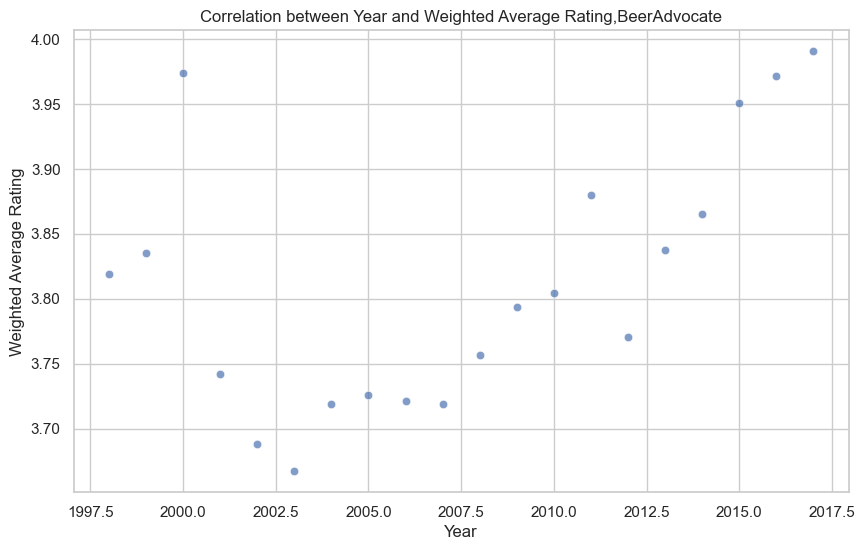

In [302]:
# Group data by year and calculate the total number of reviews per year
review_counts_y_ba = total_ba.groupby(['beer_id']).size().reset_index(name='review_count')

# Merge the reviews data with the review count data based on the year
reviews_with_counts_y_ba= pd.merge(total_ba, review_counts_y_ba, on=['beer_id'])

# Filter reviews where the review count per year is greater than or equal to 5
filtered_reviews_y_ba = reviews_with_counts_y_ba[reviews_with_counts_y_ba['review_count'] >= 5]

# Calculate the weighted average rating per year
weighted_avg_year_ba = filtered_reviews_y_ba.groupby('year').apply(
    lambda x: (x['rating'] * x['review_count']).sum() / x['review_count'].sum()
).reset_index(name='weighted_avg_rating')

# Calculate the correlation between the year and the weighted average rating
correlation_year_score_ba = weighted_avg_year_ba[['year', 'weighted_avg_rating']].corr()

# Display the correlation matrix
print("Correlation between year and weighted average rating, Beeradvocate:")
print(correlation_year_score_ba)

# Display a scatter plot to better understand the relationship
plt.figure(figsize=(10, 6))
sns.scatterplot(data=weighted_avg_year_ba, x='year', y='weighted_avg_rating', alpha=0.7)
plt.title('Correlation between Year and Weighted Average Rating,BeerAdvocate')
plt.xlabel('Year')
plt.ylabel('Weighted Average Rating')
plt.grid(True)
plt.show()


There is a moderate positive correlation between year and weighted average rating. As the years progress, there appears to be a moderate increase in the average ratings of beers in BeerAdvocate. This means that, over time, users have tended to give slightly higher ratings to beers. With time, BeerAdvocate could have attracted a more diverse group of reviewers, which may influence the rating trends. If beer ratings become more polarized (i.e., more people either loving or disliking certain beers), it could lead to the observed positive correlation with the passage of time.Over time, there could be a general improvement in the quality of beers available.


Correlation between year and weighted average rating, RateBeer:
                         year  weighted_avg_rating
year                 1.000000             0.964129
weighted_avg_rating  0.964129             1.000000


/var/folders/np/3hhzvb2x6znbzvj6ph2phb8h0000gn/T/ipykernel_51833/1364978352.py:11: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  weighted_avg_year_rb = filtered_reviews_y_rb.groupby('year').apply(


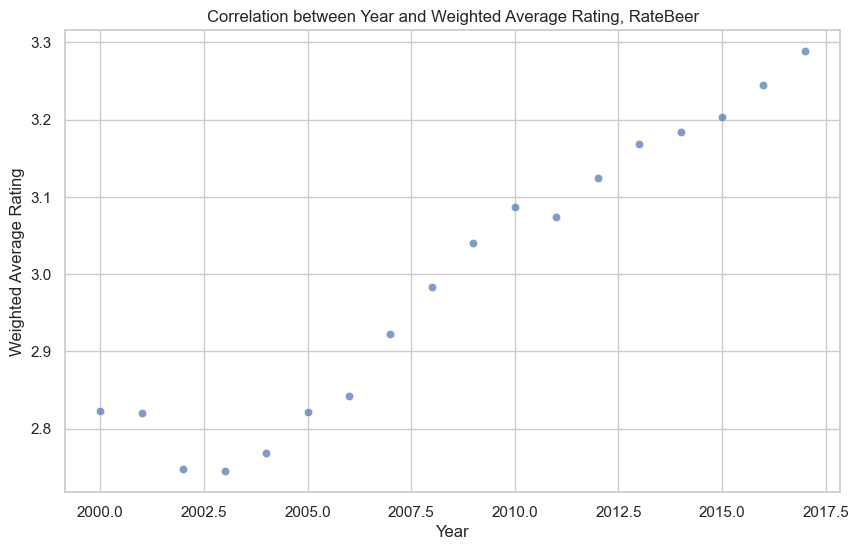

In [304]:
# Group data by year and calculate the total number of reviews per year
review_counts_y_rb= total_rb.groupby(['beer_id']).size().reset_index(name='review_count')

# Merge the reviews data with the review count data based on the year
reviews_with_counts_y_rb = pd.merge(total_rb, review_counts_y_rb, on=['beer_id'])

# Filter reviews where the review count per year is greater than or equal to 5
filtered_reviews_y_rb = reviews_with_counts_y_rb[reviews_with_counts_y_rb['review_count'] >= 5]

# Calculate the weighted average rating per year
weighted_avg_year_rb = filtered_reviews_y_rb.groupby('year').apply(
    lambda x: (x['rating'] * x['review_count']).sum() / x['review_count'].sum()
).reset_index(name='weighted_avg_rating')

# Calculate the correlation between the year and the weighted average rating
correlation_year_score_rb = weighted_avg_year_rb[['year', 'weighted_avg_rating']].corr()

# Display the correlation matrix
print("Correlation between year and weighted average rating, RateBeer:")
print(correlation_year_score_rb)

# Display a scatter plot to better understand the relationship
plt.figure(figsize=(10, 6))
sns.scatterplot(data=weighted_avg_year_rb, x='year', y='weighted_avg_rating', alpha=0.7)
plt.title('Correlation between Year and Weighted Average Rating, RateBeer')
plt.xlabel('Year')
plt.ylabel('Weighted Average Rating')
plt.grid(True)
plt.show()


he correlation between year and weighted average rating in RateBeer is very strong positive, This means that as the years progress, the average ratings for beers on RateBeer tend to increase significantly.Just like in BeerAdvocate, beer quality may have improved over time. Over time, there could have been a shift toward more positive reviews across platforms like RateBeer, where newer beers or styles might align more with the current tastes of users, leading to higher ratings.

RateBeer shows a much stronger correlation than BeerAdvocate , suggesting that the trend of higher ratings over time is more pronounced in RateBeer. This could indicate different dynamics in how the communities on each platform review and rate beers.

Correlation between year, Location of the user and weighted average rating, BeerAdvocate:
                         year  location_user_code  weighted_avg_rating
year                 1.000000            0.455989             0.212352
location_user_code   0.455989            1.000000             0.060128
weighted_avg_rating  0.212352            0.060128             1.000000


/var/folders/np/3hhzvb2x6znbzvj6ph2phb8h0000gn/T/ipykernel_51833/2940465813.py:11: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  weighted_avg_year_ba = filtered_reviews_y_ba.groupby(['year', 'location_user']).apply(


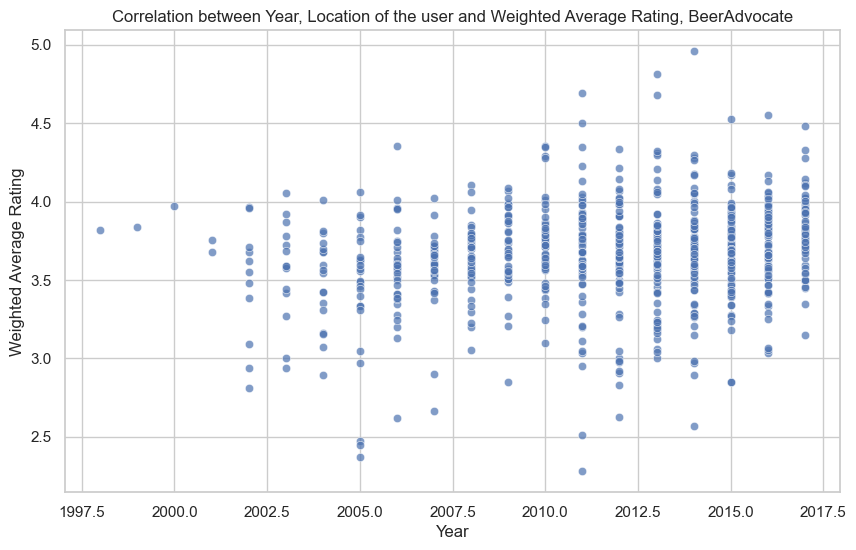

In [306]:
# Group data by year and location, and count the number of reviews for each combination
review_counts_y_ba = total_ba.groupby(['beer_id']).size().reset_index(name='review_count')

# Merge the reviews data with the review count data based on the year and location_user
reviews_with_counts_y_ba = pd.merge(total_ba, review_counts_y_ba, on=['beer_id'])

# Filter reviews where the review count per year and location is greater than or equal to 5
filtered_reviews_y_ba = reviews_with_counts_y_ba[reviews_with_counts_y_ba['review_count'] >= 5]

# Calculate the weighted average rating per year and location_user
weighted_avg_year_ba = filtered_reviews_y_ba.groupby(['year', 'location_user']).apply(
    lambda x: (x['rating'] * x['review_count']).sum() / x['review_count'].sum()
).reset_index(name='weighted_avg_rating')

# Encode location_user as a numerical code for correlation calculation
weighted_avg_year_ba['location_user_code'] = pd.factorize(weighted_avg_year_ba['location_user'])[0]

# Calculate the correlation between year, location_user_code, and weighted average rating
correlation_year_score_ba = weighted_avg_year_ba[['year', 'location_user_code', 'weighted_avg_rating']].corr()

# Display the correlation matrix
print("Correlation between year, Location of the user and weighted average rating, BeerAdvocate:")
print(correlation_year_score_ba)

# Display a scatter plot to better understand the relationship
plt.figure(figsize=(10, 6))
sns.scatterplot(data=weighted_avg_year_ba, x='year', y='weighted_avg_rating', alpha=0.7)
plt.title('Correlation between Year, Location of the user and Weighted Average Rating, BeerAdvocate')
plt.xlabel('Year')
plt.ylabel('Weighted Average Rating')
plt.grid(True)
plt.show()


there is a moderate positive correlation between year and location_user_code. This suggests that as the years progress, the location of the users (in terms of country or region) on BeerAdvocate has some degree of change or shift.

Correlation between year, Location of the user and weighted average rating, RateBeer:
                         year  location_user_code  weighted_avg_rating
year                 1.000000            0.402349             0.415061
location_user_code   0.402349            1.000000             0.006072
weighted_avg_rating  0.415061            0.006072             1.000000


/var/folders/np/3hhzvb2x6znbzvj6ph2phb8h0000gn/T/ipykernel_51833/1075048976.py:11: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  weighted_avg_year_rb = filtered_reviews_y_rb.groupby(['year', 'location_user']).apply(


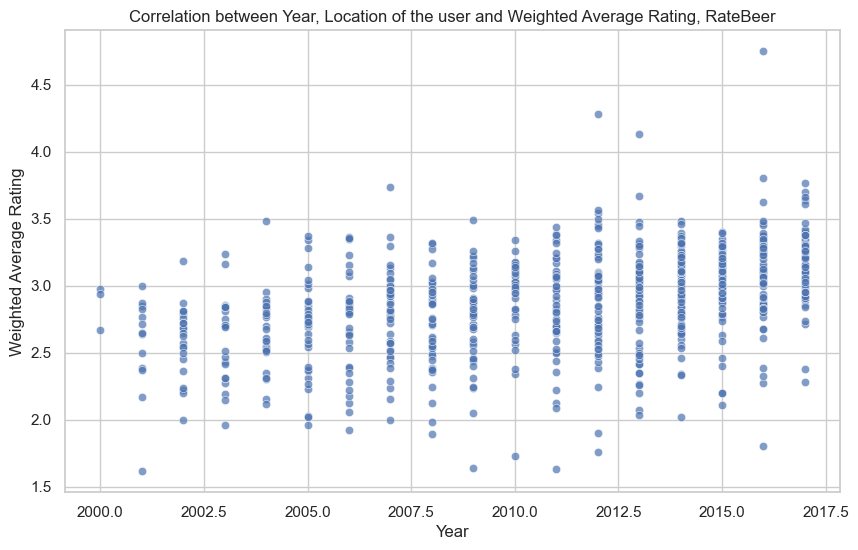

In [307]:
# Group data by year and location, and count the number of reviews for each combination
review_counts_y_rb = total_rb.groupby(['beer_id']).size().reset_index(name='review_count')

# Merge the reviews data with the review count data based on the year and location_user
reviews_with_counts_y_rb = pd.merge(total_rb, review_counts_y_rb, on=['beer_id'])

# Filter reviews where the review count per year and location is greater than or equal to 5
filtered_reviews_y_rb = reviews_with_counts_y_rb[reviews_with_counts_y_rb['review_count'] >= 5]

# Calculate the weighted average rating per year and location_user
weighted_avg_year_rb = filtered_reviews_y_rb.groupby(['year', 'location_user']).apply(
    lambda x: (x['rating'] * x['review_count']).sum() / x['review_count'].sum()
).reset_index(name='weighted_avg_rating')

# Encode location_user as a numerical code for correlation calculation
weighted_avg_year_rb['location_user_code'] = pd.factorize(weighted_avg_year_rb['location_user'])[0]

# Calculate the correlation between year, location_user_code, and weighted average rating
correlation_year_score_rb = weighted_avg_year_rb[['year', 'location_user_code', 'weighted_avg_rating']].corr()

# Display the correlation matrix
print("Correlation between year, Location of the user and weighted average rating, RateBeer:")
print(correlation_year_score_rb)

# Display a scatter plot to better understand the relationship
plt.figure(figsize=(10, 6))
sns.scatterplot(data=weighted_avg_year_rb, x='year', y='weighted_avg_rating', alpha=0.7)
plt.title('Correlation between Year, Location of the user and Weighted Average Rating, RateBeer')
plt.xlabel('Year')
plt.ylabel('Weighted Average Rating')
plt.grid(True)
plt.show()


there is a moderate positive correlation between year and location_user_code. This suggests that as the years progress, the location of the users (in terms of country or region) on RateBeer has some degree of change or shift.

Correlation between year,location of the user, style and weighted average rating, BeerAdvocate:
                         year  location_user_code  weighted_avg_rating  \
year                 1.000000            0.375252             0.098251   
location_user_code   0.375252            1.000000             0.047813   
weighted_avg_rating  0.098251            0.047813             1.000000   
style_code           0.000295           -0.138212             0.071533   

                     style_code  
year                   0.000295  
location_user_code    -0.138212  
weighted_avg_rating    0.071533  
style_code             1.000000  


/var/folders/np/3hhzvb2x6znbzvj6ph2phb8h0000gn/T/ipykernel_51833/2077315351.py:11: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  weighted_avg_year_ba = filtered_reviews_y_ba.groupby(['year','style', 'location_user']).apply(


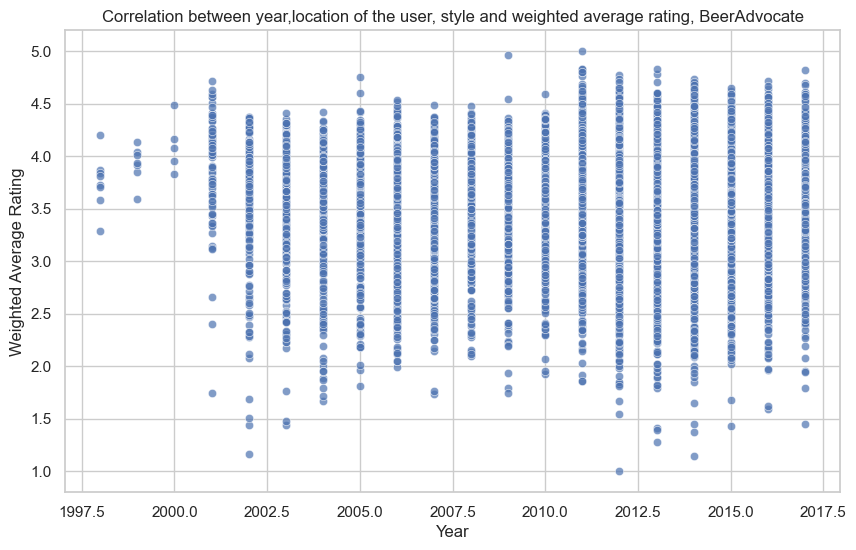

In [308]:
# Group data by year and location, and count the number of reviews for each combination
review_counts_y_ba = total_ba.groupby(['beer_id']).size().reset_index(name='review_count')

# Merge the reviews data with the review count data based on the year and location_user
reviews_with_counts_y_ba= pd.merge(total_ba, review_counts_y_ba, on=['year', 'location_user','style'])

# Filter reviews where the review count per year and location is greater than or equal to 5
filtered_reviews_y_ba = reviews_with_counts_y_ba[reviews_with_counts_y_ba['review_count'] >= 5]

# Calculate the weighted average rating per year and location_user
weighted_avg_year_ba = filtered_reviews_y_ba.groupby(['year','style', 'location_user']).apply(
    lambda x: (x['rating'] * x['review_count']).sum() / x['review_count'].sum()
).reset_index(name='weighted_avg_rating')

# Encode location_user as a numerical code for correlation calculation
weighted_avg_year_ba['location_user_code'] = pd.factorize(weighted_avg_year_ba['location_user'])[0]
weighted_avg_year_ba['style_code'] = pd.factorize(weighted_avg_year_ba['style'])[0]

# Calculate the correlation between year, location_user_code, and weighted average rating
correlation_year_score_ba= weighted_avg_year_ba[['year', 'location_user_code', 'weighted_avg_rating','style_code']].corr()

# Display the correlation matrix
print("Correlation between year,location of the user, style and weighted average rating, BeerAdvocate:")
print(correlation_year_score_ba)

# Display a scatter plot to better understand the relationship
plt.figure(figsize=(10, 6))
sns.scatterplot(data=weighted_avg_year_ba, x='year', y='weighted_avg_rating', alpha=0.7)
plt.title('Correlation between year,location of the user, style and weighted average rating, BeerAdvocate')
plt.xlabel('Year')
plt.ylabel('Weighted Average Rating')
plt.grid(True)
plt.show()


The results highlight the general trends in BeerAdvocate data, showing that while location and year have some moderate to weak relationships with average ratings and style preferences, these relationships are not very strong. Users' locations and the styles of beer reviewed on BeerAdvocate do not appear to strongly impact their average ratings over time. The low correlations also suggest that other factors, like beer quality or specific user biases, may play a more significant role in influencing ratings.

Correlation between year,location of the user, style and weighted average rating, RateBeer:
                         year  location_user_code  weighted_avg_rating  \
year                 1.000000            0.324733             0.144433   
location_user_code   0.324733            1.000000            -0.070140   
weighted_avg_rating  0.144433           -0.070140             1.000000   
style_code           0.126432           -0.091600             0.157955   

                     style_code  
year                   0.126432  
location_user_code    -0.091600  
weighted_avg_rating    0.157955  
style_code             1.000000  


/var/folders/np/3hhzvb2x6znbzvj6ph2phb8h0000gn/T/ipykernel_51833/3305602949.py:11: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  weighted_avg_year_rb = filtered_reviews_y_rb.groupby(['year', 'style','location_user']).apply(


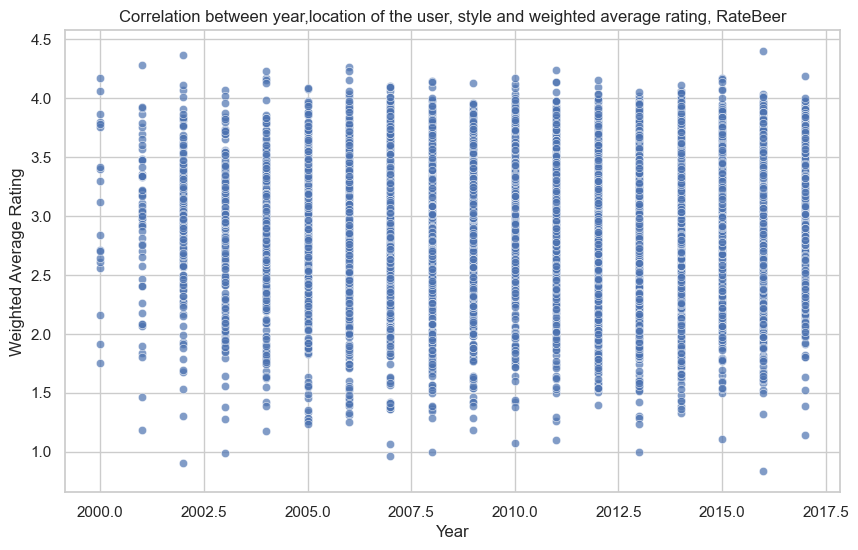

In [309]:
# Group data by year and location, and count the number of reviews for each combination
review_counts_y_rb = total_rb.groupby(['year', 'location_user','style']).size().reset_index(name='review_count')

# Merge the reviews data with the review count data based on the year and location_user
reviews_with_counts_y_rb= pd.merge(total_rb, review_counts_y_rb, on=['year', 'location_user','style'])

# Filter reviews where the review count per year and location is greater than or equal to 5
filtered_reviews_y_rb= reviews_with_counts_y_rb[reviews_with_counts_y_rb['review_count'] >= 5]

# Calculate the weighted average rating per year and location_user
weighted_avg_year_rb = filtered_reviews_y_rb.groupby(['year', 'style','location_user']).apply(
    lambda x: (x['rating'] * x['review_count']).sum() / x['review_count'].sum()
).reset_index(name='weighted_avg_rating')

# Encode location_user as a numerical code for correlation calculation
weighted_avg_year_rb['location_user_code'] = pd.factorize(weighted_avg_year_rb['location_user'])[0]
weighted_avg_year_rb['style_code'] = pd.factorize(weighted_avg_year_rb['style'])[0]

# Calculate the correlation between year, location_user_code, and weighted average rating
correlation_year_score_rb= weighted_avg_year_rb[['year', 'location_user_code', 'weighted_avg_rating','style_code']].corr()

# Display the correlation matrix
print("Correlation between year,location of the user, style and weighted average rating, RateBeer:")
print(correlation_year_score_rb)

# Display a scatter plot to better understand the relationship
plt.figure(figsize=(10, 6))
sns.scatterplot(data=weighted_avg_year_rb, x='year', y='weighted_avg_rating', alpha=0.7)
plt.title('Correlation between year,location of the user, style and weighted average rating, RateBeer')
plt.xlabel('Year')
plt.ylabel('Weighted Average Rating')
plt.grid(True)
plt.show()


BeerAdvocate and RateBeer show similar weak to moderate correlations between year, location, and average ratings.

Over time, both platforms have seen minor shifts in the geography of users and styles of beer reviewed, but the effect of these changes on average ratings is weak.

Correlation between abv and weighted average rating, BeerAdvocate:
                          abv  weighted_avg_rating
abv                  1.000000             0.391163
weighted_avg_rating  0.391163             1.000000


/var/folders/np/3hhzvb2x6znbzvj6ph2phb8h0000gn/T/ipykernel_51833/1014015442.py:10: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  weighted_avg_abv_ba = filtered_reviews_abv_ba.groupby(['abv']).apply(


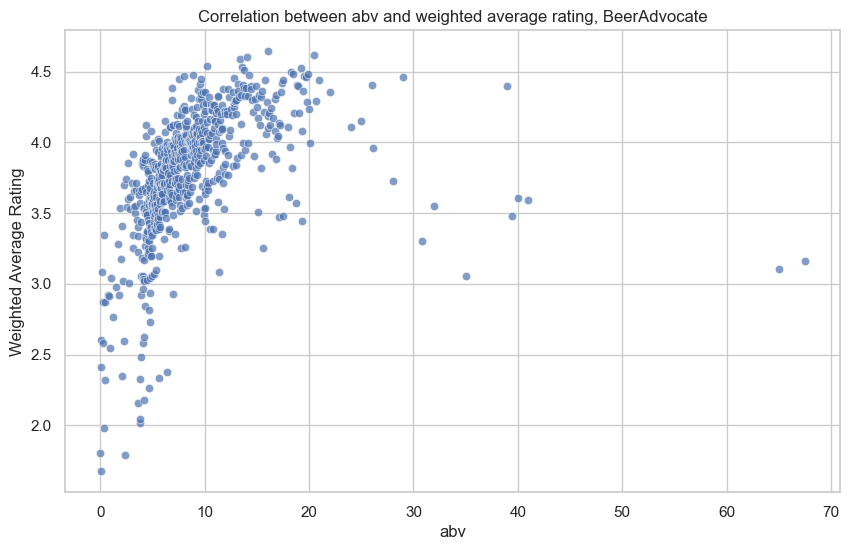

In [351]:
review_counts_abv_ba = total_ba.groupby(['abv']).size().reset_index(name='review_count')

# Merge the reviews data with the review count data based on the year and location_user
reviews_with_counts_abv_ba = pd.merge(total_ba, review_counts_abv_ba, on=['abv'])

# Filter reviews where the review count per year and location is greater than or equal to 5
filtered_reviews_abv_ba = reviews_with_counts_abv_ba[reviews_with_counts_abv_ba['review_count'] >= 5]

# Calculate the weighted average rating per year and location_user
weighted_avg_abv_ba = filtered_reviews_abv_ba.groupby(['abv']).apply(
    lambda x: (x['rating'] * x['review_count']).sum() / x['review_count'].sum()
).reset_index(name='weighted_avg_rating')


# Calculate the correlation between year, location_user_code, and weighted average rating
correlation_score_ba = weighted_avg_abv_ba[['abv', 'weighted_avg_rating']].corr()

# Display the correlation matrix
print("Correlation between abv and weighted average rating, BeerAdvocate:")
print(correlation_score_ba)

# Display a scatter plot to better understand the relationship
plt.figure(figsize=(10, 6))
sns.scatterplot(data=weighted_avg_abv_ba, x='abv', y='weighted_avg_rating', alpha=0.7)
plt.title('Correlation between abv and weighted average rating, BeerAdvocate')
plt.xlabel('abv')
plt.ylabel('Weighted Average Rating')
plt.grid(True)
plt.show()

The correlation between ABV (Alcohol by Volume) and weighted average rating on BeerAdvocate indicates a moderate positive correlation,as the ABV increases, the average rating tends to increase as well, but the relationship is not extremely strong.


Correlation between abv and weighted average rating,RateBeer:
                          abv  weighted_avg_rating
abv                  1.000000             0.636051
weighted_avg_rating  0.636051             1.000000


/var/folders/np/3hhzvb2x6znbzvj6ph2phb8h0000gn/T/ipykernel_51833/3354116462.py:10: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  weighted_avg_abv_rb= filtered_reviews_abv_rb.groupby(['abv']).apply(


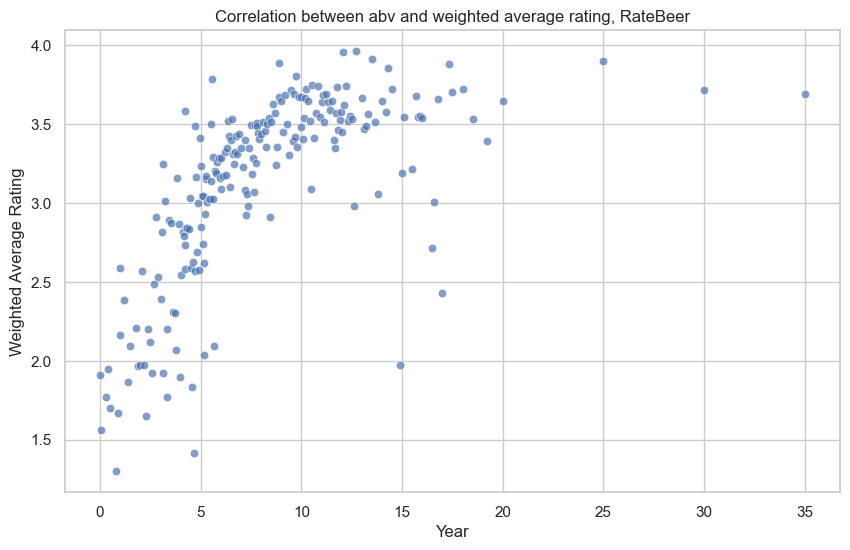

In [355]:
review_counts_abv_rb= total_rb.groupby(['abv']).size().reset_index(name='review_count')

# Merge the reviews data with the review count data based on the year and location_user
reviews_with_counts_abv_rb= pd.merge(total_rb, review_counts_abv_rb, on=['abv'])

# Filter reviews where the review count per year and location is greater than or equal to 5
filtered_reviews_abv_rb = reviews_with_counts_abv_rb[reviews_with_counts_abv_rb['review_count'] >= 5]

# Calculate the weighted average rating per year and location_user
weighted_avg_abv_rb= filtered_reviews_abv_rb.groupby(['abv']).apply(
    lambda x: (x['rating'] * x['review_count']).sum() / x['review_count'].sum()
).reset_index(name='weighted_avg_rating')


# Calculate the correlation between year, location_user_code, and weighted average rating
correlation_abv_score_rb = weighted_avg_abv_rb[['abv', 'weighted_avg_rating']].corr()

# Display the correlation matrix
print("Correlation between abv and weighted average rating,RateBeer:")
print(correlation_abv_score_rb)

# Display a scatter plot to better understand the relationship
plt.figure(figsize=(10, 6))
sns.scatterplot(data=weighted_avg_abv_rb, x='abv', y='weighted_avg_rating', alpha=0.7)
plt.title('Correlation between abv and weighted average rating, RateBeer')
plt.xlabel('Year')
plt.ylabel('Weighted Average Rating')
plt.grid(True)
plt.show()

The correlation between ABV (Alcohol by Volume) and weighted average rating on RateBeer  indicates a moderate to strong positive correlation.

The stronger correlation in RateBeer implies that ABV is a more influential factor for users' ratings on this platform compared to BeerAdvocate

In [375]:
# 1. Calculate the weighted average rating for each beer grouped by brewery
beer_ratings_by_brewery = total_ba.groupby(['brewery_id']).agg(
    weighted_avg_rating=('rating', lambda x: np.average(x, weights=x.count()))
).reset_index()

# 2. Encode location_beer using LabelEncoder
encoder = LabelEncoder()
total_ba['location_beer_encoded'] = encoder.fit_transform(total_ba['location_beer'])

# 3. Merge the weighted average ratings (by brewery) back with the main dataset
total_ba = total_ba.merge(beer_ratings_by_brewery[[ 'brewery_id', 'weighted_avg_rating']], 
                           on='beer_id', how='left')

# 4. Calculate the correlation between location_beer and weighted_avg_rating
correlation = total_ba[['location_beer_encoded', 'weighted_avg_rating']].corr()

# Output the correlation matrix
print(correlation)

TypeError: Axis must be specified when shapes of a and weights differ.